# Submitted By: SANTOSHI PATNAIK( DS-2306)

# Evaluation Project-3

# 1. Census Income

## Project Description: 

In [1]:
import pandas as pd                              # importing necessary libraries
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_csv('census_income.csv')
df

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
0,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
1,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
2,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
3,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
4,37,Private,284582,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32555,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32556,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32557,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
32558,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


## EDA

In [3]:
df.head()

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
0,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
1,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
2,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
3,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
4,37,Private,284582,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K


In [4]:
df.tail()

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
32555,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32556,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32557,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
32558,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K
32559,52,Self-emp-inc,287927,HS-grad,9,Married-civ-spouse,Exec-managerial,Wife,White,Female,15024,0,40,United-States,>50K


In [5]:
df.shape

(32560, 15)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32560 entries, 0 to 32559
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Age             32560 non-null  int64 
 1   Workclass       32560 non-null  object
 2   Fnlwgt          32560 non-null  int64 
 3   Education       32560 non-null  object
 4   Education_num   32560 non-null  int64 
 5   Marital_status  32560 non-null  object
 6   Occupation      32560 non-null  object
 7   Relationship    32560 non-null  object
 8   Race            32560 non-null  object
 9   Sex             32560 non-null  object
 10  Capital_gain    32560 non-null  int64 
 11  Capital_loss    32560 non-null  int64 
 12  Hours_per_week  32560 non-null  int64 
 13  Native_country  32560 non-null  object
 14  Income          32560 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


#### Replacing the '?' with Nan in data set

In [7]:
df.isin([' ?']).sum()

Age                  0
Workclass         1836
Fnlwgt               0
Education            0
Education_num        0
Marital_status       0
Occupation        1843
Relationship         0
Race                 0
Sex                  0
Capital_gain         0
Capital_loss         0
Hours_per_week       0
Native_country     583
Income               0
dtype: int64

In [8]:
df=df.replace(' ?',np.NaN)

In [9]:
df.duplicated().any()

True

In [10]:
df.drop_duplicates(keep='last', inplace=True)

#### we can see some duplicate data present in the data set.. so we have to drop those rows

In [11]:
df.shape

(32536, 15)

In [12]:
df.isnull().sum()

Age                  0
Workclass         1836
Fnlwgt               0
Education            0
Education_num        0
Marital_status       0
Occupation        1843
Relationship         0
Race                 0
Sex                  0
Capital_gain         0
Capital_loss         0
Hours_per_week       0
Native_country     582
Income               0
dtype: int64

<AxesSubplot:>

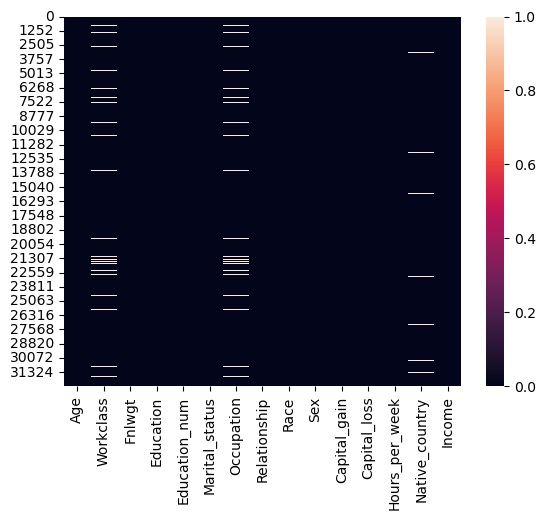

In [13]:
## Visualizing through heat map:
sns.heatmap(df.isnull())

#### Here the null values are arised as we replaced the "?" with Nan.. Now we have to replace the nana values with mean or mode according to the categorical or numerical column

##### Comments: 
we can see the "Workclass", "Occupation","Native_country" only these columns contains Nan values which are Categorical columns, so we have to replace the Nan values by Mode of the data in that columns

In [14]:
df["Workclass"]=df["Workclass"].fillna(df["Workclass"].mode()[0])
df["Occupation"]=df["Occupation"].fillna(df["Occupation"].mode()[0])
df["Native_country"]=df["Native_country"].fillna(df["Native_country"].mode()[0])

#### Checking for Missing Values After replacing the "?"

In [15]:
df.isnull().sum()

Age               0
Workclass         0
Fnlwgt            0
Education         0
Education_num     0
Marital_status    0
Occupation        0
Relationship      0
Race              0
Sex               0
Capital_gain      0
Capital_loss      0
Hours_per_week    0
Native_country    0
Income            0
dtype: int64

<AxesSubplot:>

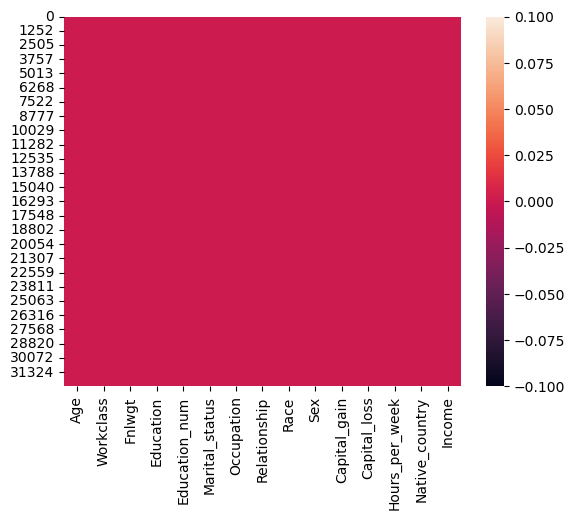

In [16]:
## Visualizing through heatmap:
sns.heatmap(df.isnull())

#### We can see now all the null values are replaced and no missing values present in data set

###### Separating Categorical and numerical columns:


In [17]:
categorical_col=[]
for i in df.dtypes.index:
    if df.dtypes[i]=="object":
        categorical_col.append(i)
print("categorical columns:",categorical_col)    

categorical columns: ['Workclass', 'Education', 'Marital_status', 'Occupation', 'Relationship', 'Race', 'Sex', 'Native_country', 'Income']


In [18]:
#for numerical column:
numeric_col=[]
for i in df.dtypes.index:
    if df.dtypes[i]!="object":
        numeric_col.append(i)
print("numerical column:",numeric_col)        

numerical column: ['Age', 'Fnlwgt', 'Education_num', 'Capital_gain', 'Capital_loss', 'Hours_per_week']


#### Statistical Description:

In [19]:
df.describe()

,Age,Fnlwgt,Education_num,Capital_gain,Capital_loss,Hours_per_week
count,32536.000000,3.253600e+04,32536.000000,32536.000000,32536.000000,32536.000000
mean,38.585536,1.897843e+05,10.081725,1078.410069,87.370912,40.440343
std,13.638193,1.055563e+05,2.571622,7388.068465,403.107737,12.347079
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178315e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783560e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.369932e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


### Observation:
1. Count of all the columns are same which shows there is no missing value present in the dataset.
2. In "Capital_gain" and "Capital_loss" column data is highly skewed.( right skewed)i.e. mean greater thean median(50%)
3. in remaining columns the data is slightly skewed or nearly equal to normal distribution in some columns
4. we can see from the above description that there is a considerable gap between 75% and max value , which shows outliers present in the dataset

## Data visualization:

## Univariate Analysis:

 <=50K    24697
 >50K      7839
Name: Income, dtype: int64


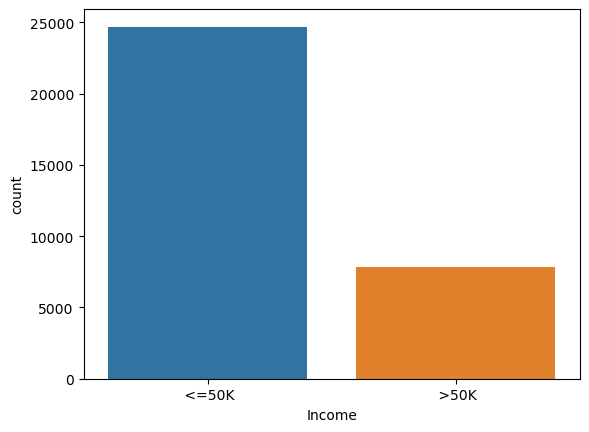

In [20]:
#visualizing the count of "Income" column:
p=sns.countplot(x='Income',data=df)
print(df['Income'].value_counts())

#### Comments:
-> from the above count plot we can observe the number of persons whose income less than 50k are more compared to that of number of people getting more than 50k
-> Number of persons whose income less than 50k is 24697
-> number of counts whose income >50k is 7839

 Private             24509
 Self-emp-not-inc     2540
 Local-gov            2093
 State-gov            1297
 Self-emp-inc         1116
 Federal-gov           960
 Without-pay            14
 Never-worked            7
Name: Workclass, dtype: int64


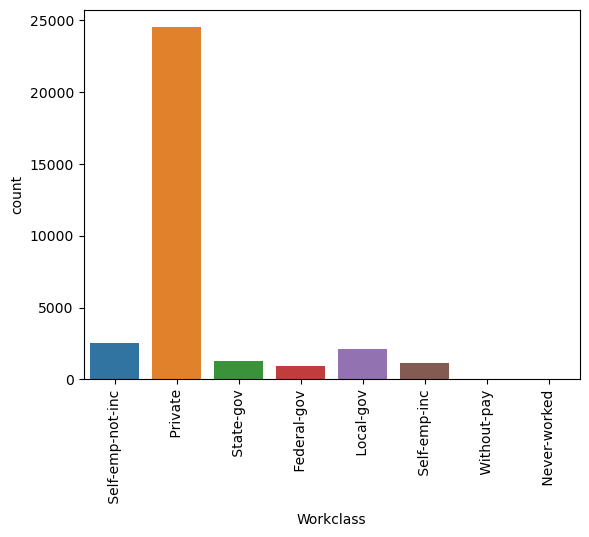

In [21]:
# Visualizing the "workclass"
p=sns.countplot(x='Workclass',data=df)
plt.xticks(rotation=90)
print(df['Workclass'].value_counts())


##### Comments:
-> From above we can observe, maximum number of peoples working in private sector only, self employed, local-gov.

-> people comming under "Never-Worked" and " Without-pay" jone are very less


 HS-grad         10494
 Some-college     7282
 Bachelors        5352
 Masters          1722
 Assoc-voc        1382
 11th             1175
 Assoc-acdm       1067
 10th              933
 7th-8th           645
 Prof-school       576
 9th               514
 12th              433
 Doctorate         413
 5th-6th           332
 1st-4th           166
 Preschool          50
Name: Education, dtype: int64


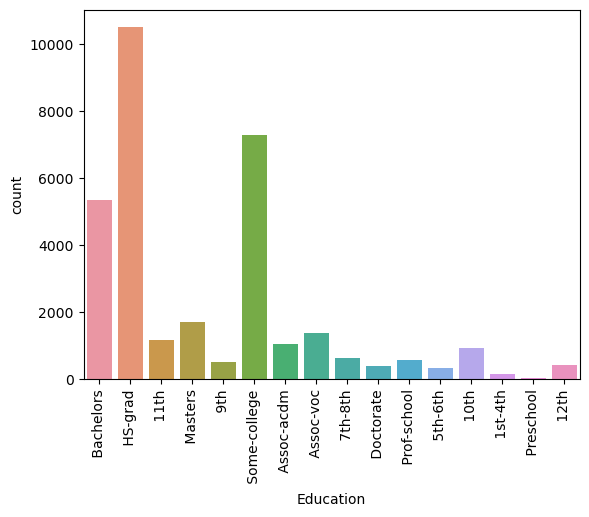

In [22]:
#visualizing the count of "Education" column:
p=sns.countplot(x='Education',data=df)
plt.xticks(rotation=90)
print(df['Education'].value_counts())


In [23]:
##### Comments:
-> Number of persons completed HS-grad are maximum, the count is 10494
-> followed by Some collages, Bacholers and masters etc
-> the count is least in case of people having education "Preschool". Here the count is 50 only

SyntaxError: invalid syntax (3205019266.py, line 2)

 Married-civ-spouse       14970
 Never-married            10666
 Divorced                  4441
 Separated                 1025
 Widowed                    993
 Married-spouse-absent      418
 Married-AF-spouse           23
Name: Marital_status, dtype: int64


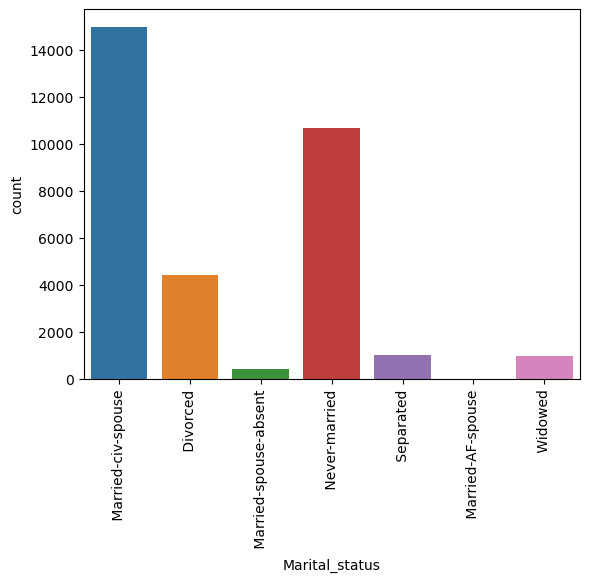

In [24]:
#visualizing the count of "Marital_status" column:
p=sns.countplot(x='Marital_status',data=df)
plt.xticks(rotation=90)
print(df['Marital_status'].value_counts())

#### Comments:
-> maximum number ofcount are of "Married-civ-spouce", followed by " Never Married", Then "Divorced"
so these category people are more involved in different segment of earning category.
->in remaining category the count is less.
->"Married-AF-Spouce" count are the least

 Prof-specialty       5979
 Craft-repair         4094
 Exec-managerial      4065
 Adm-clerical         3767
 Sales                3650
 Other-service        3291
 Machine-op-inspct    2000
 Transport-moving     1597
 Handlers-cleaners    1369
 Farming-fishing       992
 Tech-support          927
 Protective-serv       649
 Priv-house-serv       147
 Armed-Forces            9
Name: Occupation, dtype: int64


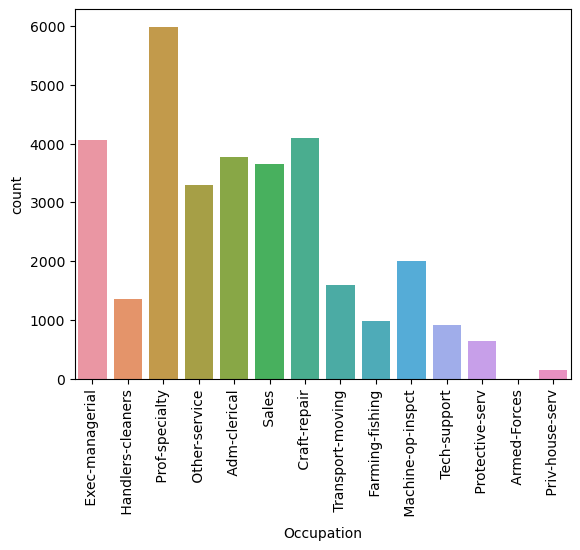

In [25]:
#visualizing the count of "Occupation" column:
p=sns.countplot(x='Occupation',data=df)
plt.xticks(rotation=90)
print(df['Occupation'].value_counts())

##### Comments:
-> In Arme Forces very less number of peoples are working
-> maximum number of peoples are working under "Prof-speciality" job category
-> the count is almost similar in case of "Adm clarical","exec-managerical","sales","Craft repair" category

 Male      21774
 Female    10762
Name: Sex, dtype: int64


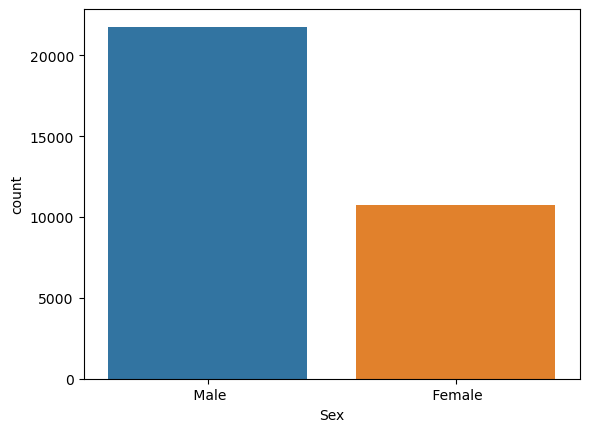

In [26]:
#visualizing the count of "Sex" column:
p=sns.countplot(x='Sex',data=df)
print(df['Sex'].value_counts())

##### Comments:
-> male working memebrs are higher than female workers

 United-States                 29734
 Mexico                          639
 Philippines                     198
 Germany                         137
 Canada                          121
 Puerto-Rico                     114
 El-Salvador                     106
 India                           100
 Cuba                             95
 England                          90
 Jamaica                          81
 South                            80
 China                            75
 Italy                            73
 Dominican-Republic               70
 Vietnam                          67
 Japan                            62
 Guatemala                        62
 Poland                           60
 Columbia                         59
 Taiwan                           51
 Haiti                            44
 Iran                             43
 Portugal                         37
 Nicaragua                        34
 Peru                             31
 France                           29
 

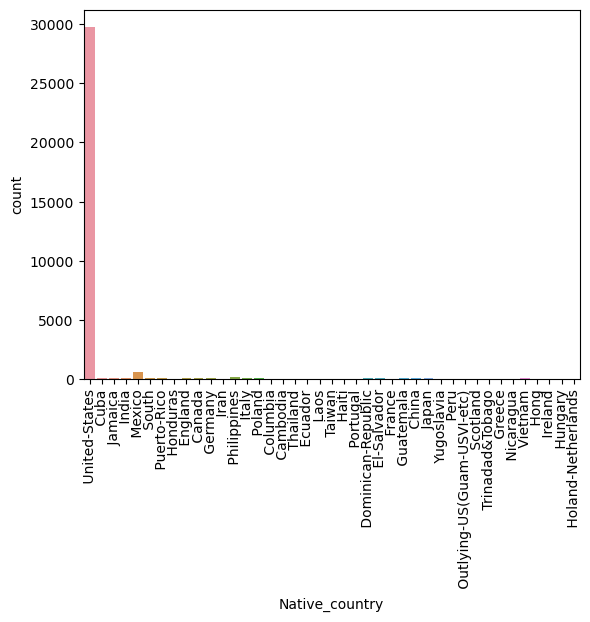

In [27]:
#visualizing the count of "Native_country" column:
p=sns.countplot(x='Native_country',data=df)
plt.xticks(rotation=90)
print(df['Native_country'].value_counts())

->> most of the people registered in this data set are from "United States" only, next a lesser count in maxico.. in remaining its very very less

 Husband           13187
 Not-in-family      8291
 Own-child          5064
 Unmarried          3445
 Wife               1568
 Other-relative      981
Name: Relationship, dtype: int64


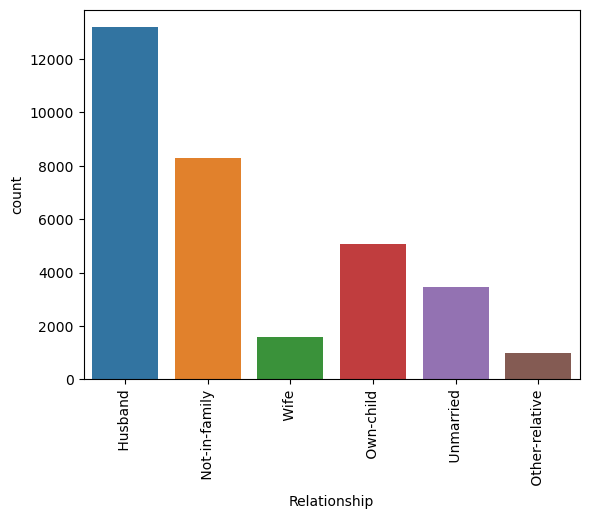

In [28]:
#visualizing the count of "Relationship" column:
p=sns.countplot(x='Relationship',data=df)
plt.xticks(rotation=90)
print(df['Relationship'].value_counts())

##### Comments:
-> In most of the cases families are dependent on Husband's Income source
-> The count of people earning  who are not in family are also high
-> The Count for "wife" and other relative are least

 White                 27794
 Black                  3122
 Asian-Pac-Islander     1038
 Amer-Indian-Eskimo      311
 Other                   271
Name: Race, dtype: int64


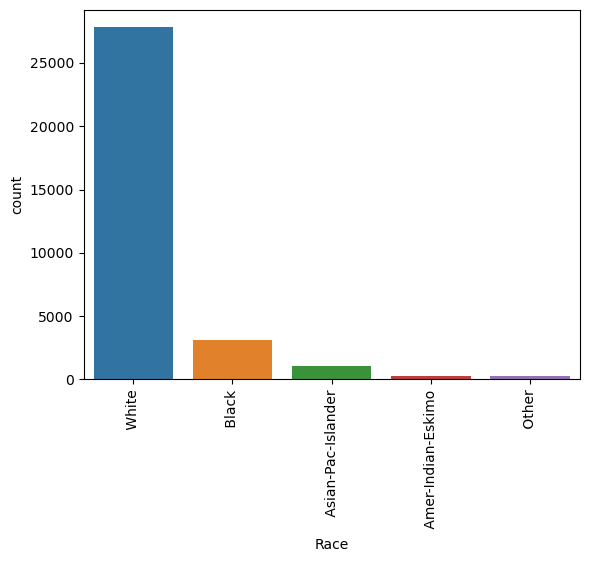

In [29]:
#visualizing the count of "Race" column:
p=sns.countplot(x='Race',data=df)
plt.xticks(rotation=90)
print(df['Race'].value_counts())

#### Comments:
-> "White" category count is highly dominating compared to other race category.


## Bivariate Analysis:


<function matplotlib.pyplot.show(close=None, block=None)>

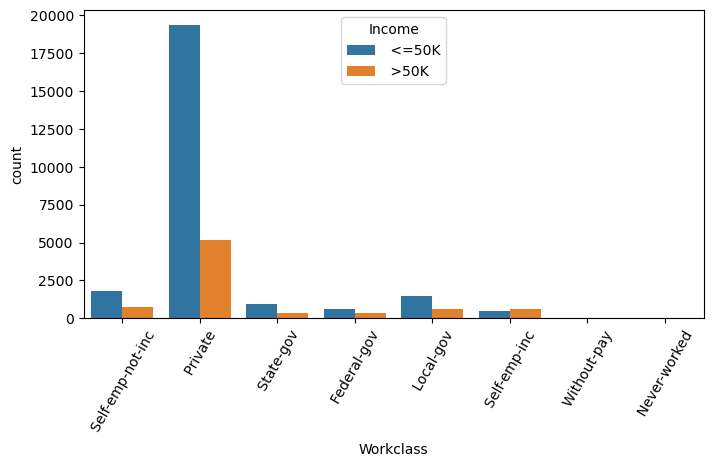

In [30]:
# Work class vs Income:
plt.figure(figsize=(8,4))
sns.countplot(x="Workclass", hue="Income", data=df)
plt.xticks(rotation=60)
plt.show

##### Comments:
-> Number of people working in Private sector are more.. as well as the persons earning  >50k are also more in private sector only
->in other segments number of people earning > 50k is almost similar

<function matplotlib.pyplot.show(close=None, block=None)>

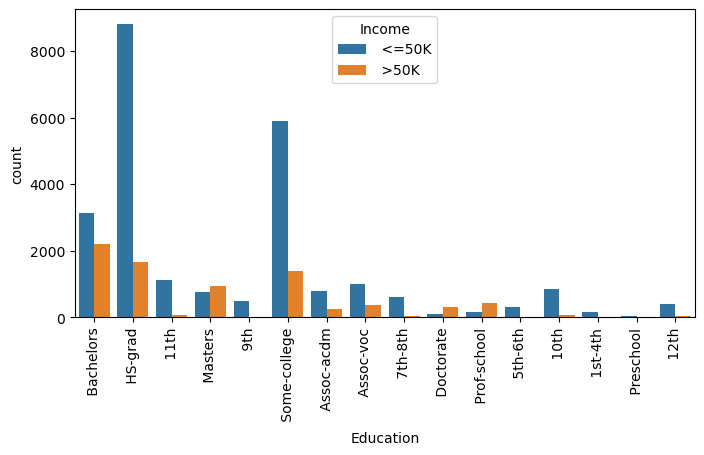

In [31]:
# Education vs Income:
plt.figure(figsize=(8,4))
sns.countplot(x="Education", hue="Income", data=df)
plt.xticks(rotation=90)
plt.show

#### Comments:
-> percentage of people earning >50k is more in people completed Bachelors degree category
->folowed by Hs-grad and some collage category
-> Surprisingly higher masters and Doctorate degree employees earning >50 k percentage is lesser compared to bachelors

<function matplotlib.pyplot.show(close=None, block=None)>

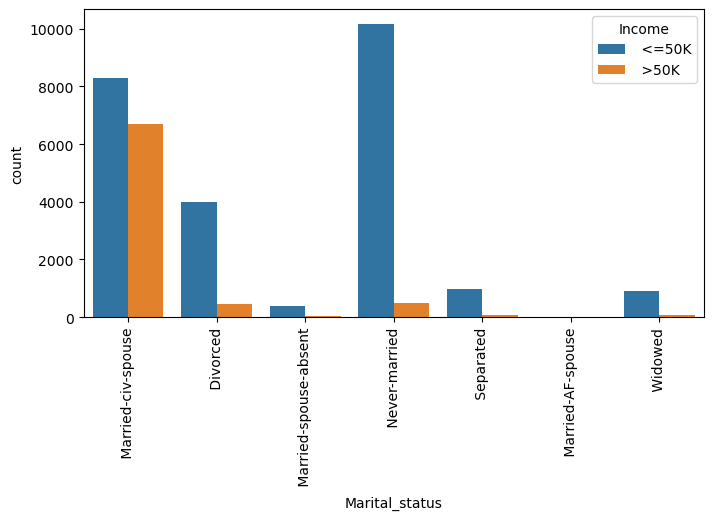

In [32]:
# Marital_status class vs Income:
plt.figure(figsize=(8,4))
sns.countplot(x="Marital_status", hue="Income", data=df)
plt.xticks(rotation=90)
plt.show

### Comments:
-> in Married-civ-spouce category income is higher

<function matplotlib.pyplot.show(close=None, block=None)>

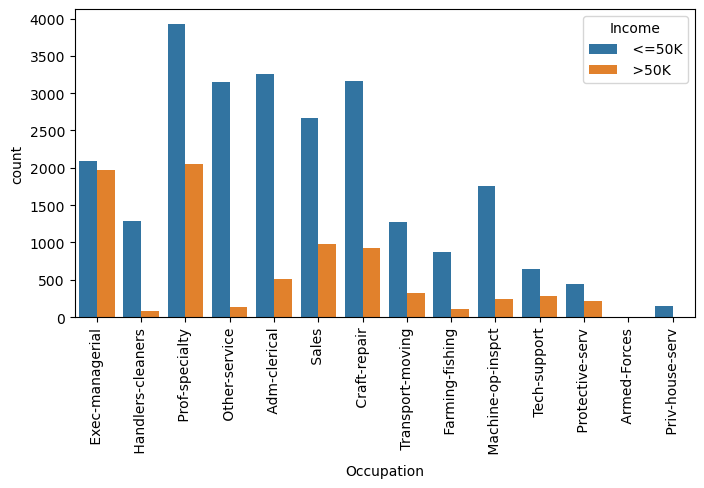

In [33]:
# Occupation vs Income:
plt.figure(figsize=(8,4))
sns.countplot(x="Occupation", hue="Income", data=df)
plt.xticks(rotation=90)
plt.show

##### comments:
-> in 'Exec managerial' an "prof-speciality" category earning is higher compared to other occupation

<function matplotlib.pyplot.show(close=None, block=None)>

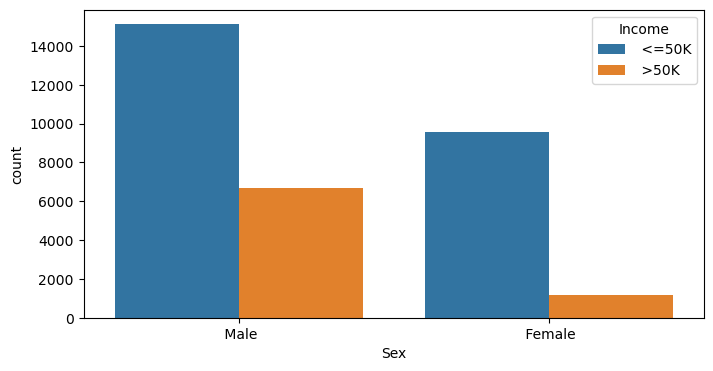

In [34]:
# Sex vs Income:
plt.figure(figsize=(8,4))
sns.countplot(x="Sex", hue="Income", data=df)
plt.show

#### Comments:
-> more number of males are earning >50k compared to females

<function matplotlib.pyplot.show(close=None, block=None)>

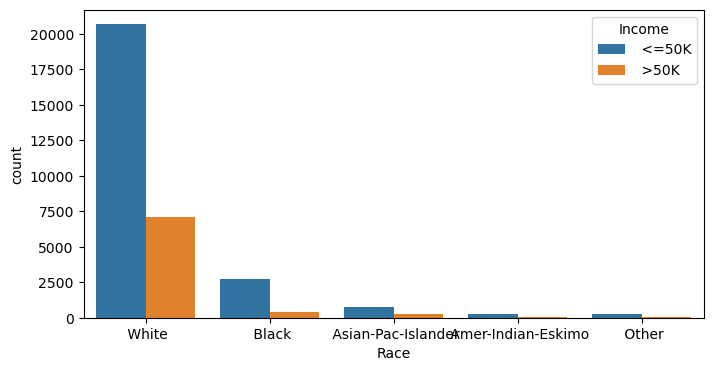

In [35]:
# Race vs Income:
plt.figure(figsize=(8,4))
sns.countplot(x="Race", hue="Income", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

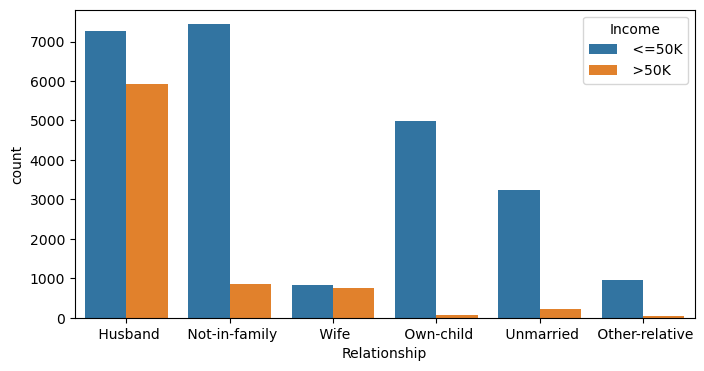

In [36]:
# Relationship vs Income:
plt.figure(figsize=(8,4))
sns.countplot(x="Relationship", hue="Income", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

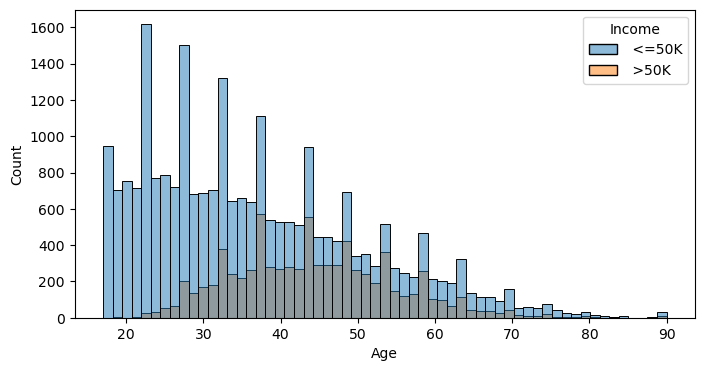

In [37]:
# Age vs Income:
plt.figure(figsize=(8,4))
sns.histplot(x="Age", hue="Income", data=df)
plt.show

#### Comments:
-> in 35-50 age group income >50 k is maximum
-> in 20-30 age group and old age groups the income is again less

<function matplotlib.pyplot.show(close=None, block=None)>

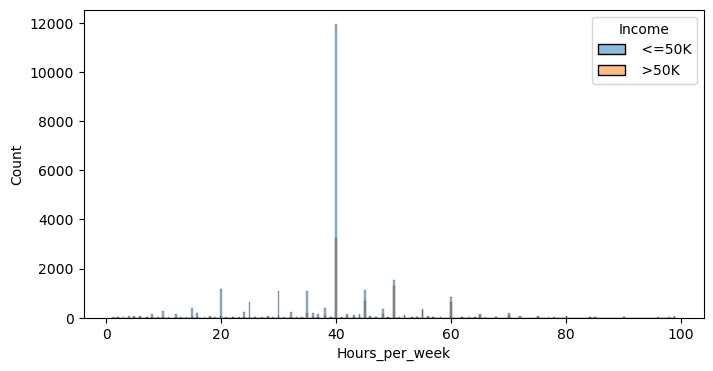

In [38]:
# Capital_gain vs Income:
plt.figure(figsize=(8,4))
sns.histplot(x="Hours_per_week", hue="Income", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

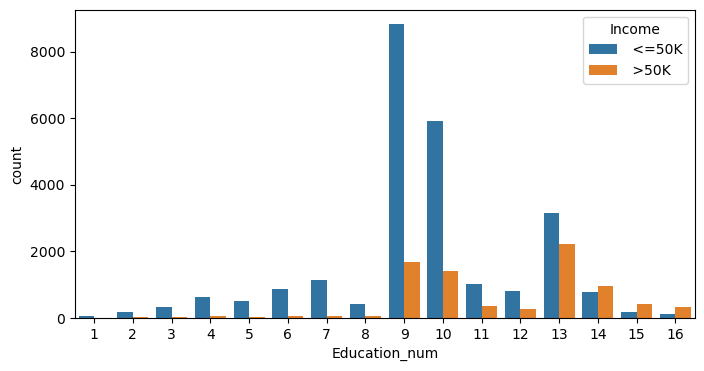

In [39]:
# Education_num vs Income:
plt.figure(figsize=(8,4))
sns.countplot(x="Education_num", hue="Income", data=df)
plt.show

## Pair plot:

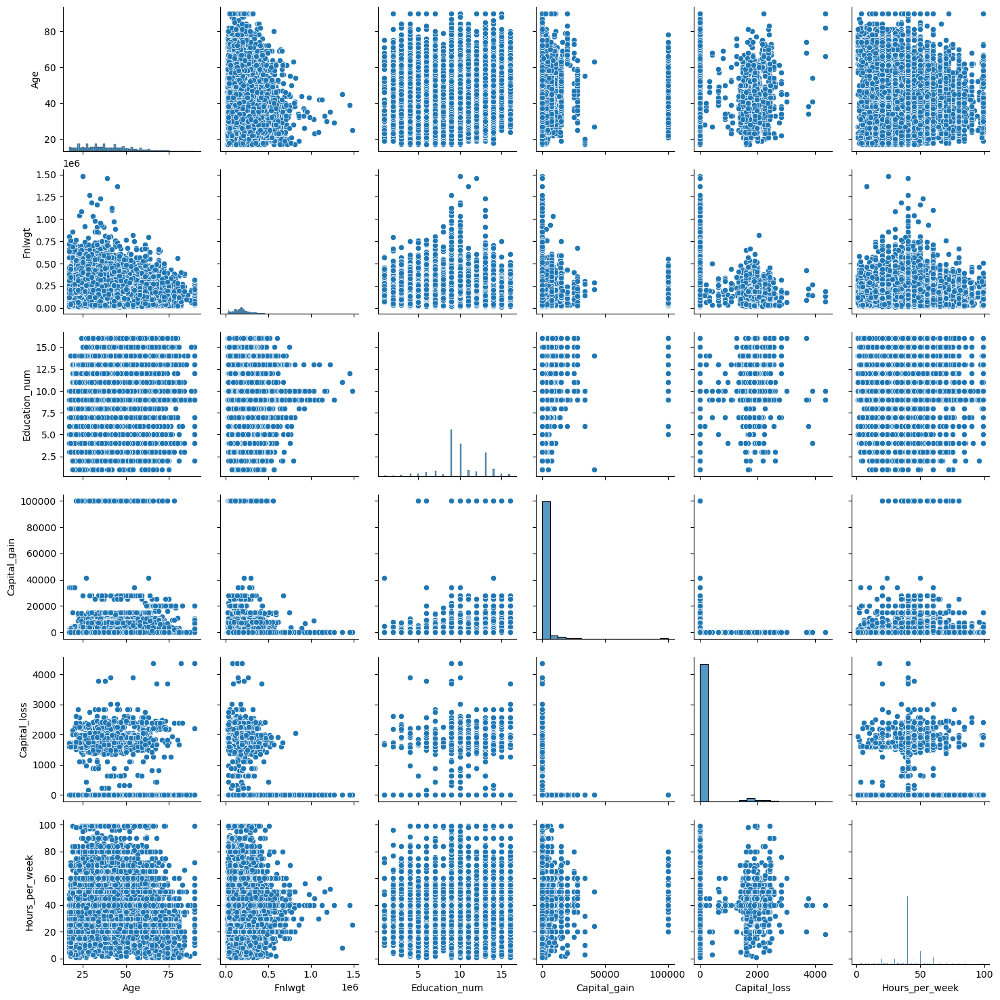

In [40]:
sns.pairplot(df)

## Feature Engineering:

In [41]:
# Encoding Categorical Columns:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in categorical_col:
    df[i]=OE.fit_transform(df[i].values.reshape(-1,1))    
df       

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
0,50,5.0,83311,9.0,13,2.0,3.0,0.0,4.0,1.0,0,0,13,38.0,0.0
1,38,3.0,215646,11.0,9,0.0,5.0,1.0,4.0,1.0,0,0,40,38.0,0.0
2,53,3.0,234721,1.0,7,2.0,5.0,0.0,2.0,1.0,0,0,40,38.0,0.0
3,28,3.0,338409,9.0,13,2.0,9.0,5.0,2.0,0.0,0,0,40,4.0,0.0
4,37,3.0,284582,12.0,14,2.0,3.0,5.0,4.0,0.0,0,0,40,38.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32555,27,3.0,257302,7.0,12,2.0,12.0,5.0,4.0,0.0,0,0,38,38.0,0.0
32556,40,3.0,154374,11.0,9,2.0,6.0,0.0,4.0,1.0,0,0,40,38.0,1.0
32557,58,3.0,151910,11.0,9,6.0,0.0,4.0,4.0,0.0,0,0,40,38.0,0.0
32558,22,3.0,201490,11.0,9,4.0,0.0,3.0,4.0,1.0,0,0,20,38.0,0.0


In [42]:
df.astype(float)

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
0,50.0,5.0,83311.0,9.0,13.0,2.0,3.0,0.0,4.0,1.0,0.0,0.0,13.0,38.0,0.0
1,38.0,3.0,215646.0,11.0,9.0,0.0,5.0,1.0,4.0,1.0,0.0,0.0,40.0,38.0,0.0
2,53.0,3.0,234721.0,1.0,7.0,2.0,5.0,0.0,2.0,1.0,0.0,0.0,40.0,38.0,0.0
3,28.0,3.0,338409.0,9.0,13.0,2.0,9.0,5.0,2.0,0.0,0.0,0.0,40.0,4.0,0.0
4,37.0,3.0,284582.0,12.0,14.0,2.0,3.0,5.0,4.0,0.0,0.0,0.0,40.0,38.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32555,27.0,3.0,257302.0,7.0,12.0,2.0,12.0,5.0,4.0,0.0,0.0,0.0,38.0,38.0,0.0
32556,40.0,3.0,154374.0,11.0,9.0,2.0,6.0,0.0,4.0,1.0,0.0,0.0,40.0,38.0,1.0
32557,58.0,3.0,151910.0,11.0,9.0,6.0,0.0,4.0,4.0,0.0,0.0,0.0,40.0,38.0,0.0
32558,22.0,3.0,201490.0,11.0,9.0,4.0,0.0,3.0,4.0,1.0,0.0,0.0,20.0,38.0,0.0


## Outlier Detection:

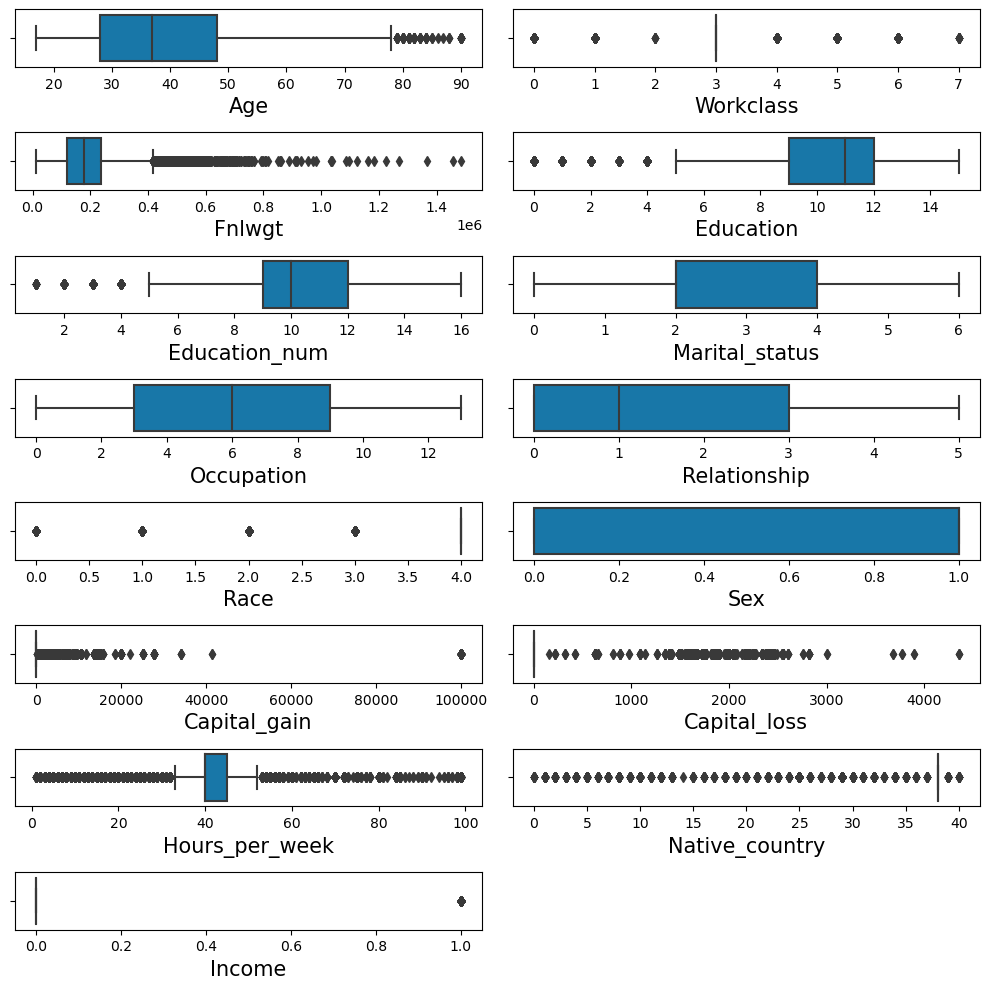

In [43]:
# checking for outliers
plt.figure(figsize=(10,10),facecolor="white")
plotnum=1
for i in df.columns:
    if plotnum<=16:
        p=plt.subplot(8,2,plotnum)
        sns.boxplot(df[i],palette='winter_r')
        plt.xlabel(i,fontsize=15)
        plt.yticks(rotation=0,fontsize=10)
        plotnum+=1
plt.tight_layout()    

In [44]:
df.columns

Index(['Age', 'Workclass', 'Fnlwgt', 'Education', 'Education_num',
       'Marital_status', 'Occupation', 'Relationship', 'Race', 'Sex',
       'Capital_gain', 'Capital_loss', 'Hours_per_week', 'Native_country',
       'Income'],
      dtype='object')

In [45]:
#removing outliers from numerical columns:
#z-score method:
from scipy.stats import zscore
out_features=df[['Fnlwgt', 'Education', 'Education_num','Capital_gain','Capital_loss','Hours_per_week']]
z=np.abs(zscore(out_features))
z

,Fnlwgt,Education,Education_num,Capital_gain,Capital_loss,Hours_per_week
0,1.008703,0.335272,1.134817,0.145969,0.216747,2.222450
1,0.245008,0.181506,0.420646,0.145969,0.216747,0.035664
2,0.425720,2.402383,1.198377,0.145969,0.216747,0.035664
3,1.408036,0.335272,1.134817,0.145969,0.216747,0.035664
4,0.898091,0.439895,1.523683,0.145969,0.216747,0.035664
...,...,...,...,...,...,...
32555,0.639647,0.852050,0.745951,0.145969,0.216747,0.197648
32556,0.335469,0.181506,0.420646,0.145969,0.216747,0.035664
32557,0.358812,0.181506,0.420646,0.145969,0.216747,0.035664
32558,0.110897,0.181506,0.420646,0.145969,0.216747,1.655506


In [46]:
#threshold=3
np.where(z>3)

(array([    9,    22,    27, ..., 32493, 32500, 32506], dtype=int64),
 array([5, 4, 5, ..., 3, 5, 5], dtype=int64))

In [47]:
# we have to removethese rows which have outliers:
df1=df[(z<3).all(axis=1)]
df1.shape          # after removing outliers the data frame size

(29909, 15)

In [48]:
#originaldata frame size
df.shape

(32536, 15)

In [49]:
#data loss percentage:
print("data loss percentage",((df.shape[0]-df1.shape[0])/df.shape[0])*100)

data loss percentage 8.074133267764937


#The dataloss percentage is affordable so we can proceed

In [50]:
#checking for skewness present in the data:
df1.skew()

Age                0.568818
Workclass          0.091330
Fnlwgt             0.634959
Education         -0.942153
Education_num     -0.171888
Marital_status    -0.042980
Occupation         0.004523
Relationship       0.745449
Race              -2.438002
Sex               -0.680287
Capital_gain       4.943489
Capital_loss      29.702119
Hours_per_week    -0.358098
Native_country    -4.336707
Income             1.331831
dtype: float64

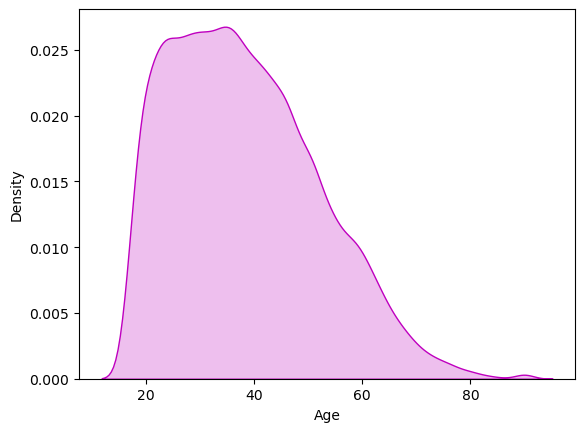

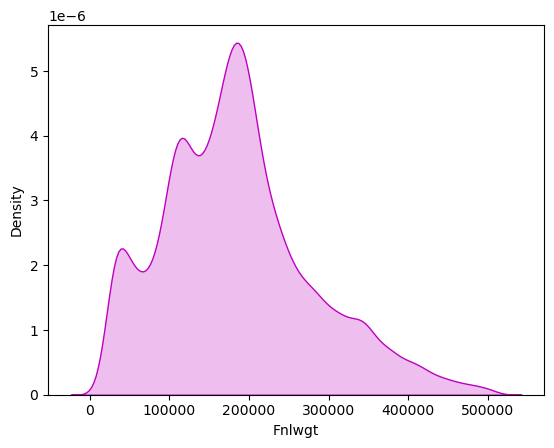

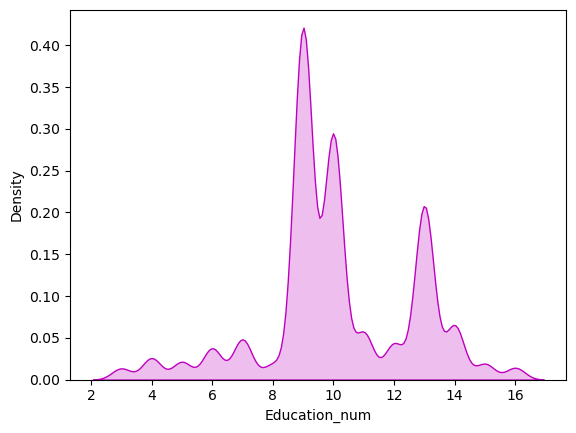

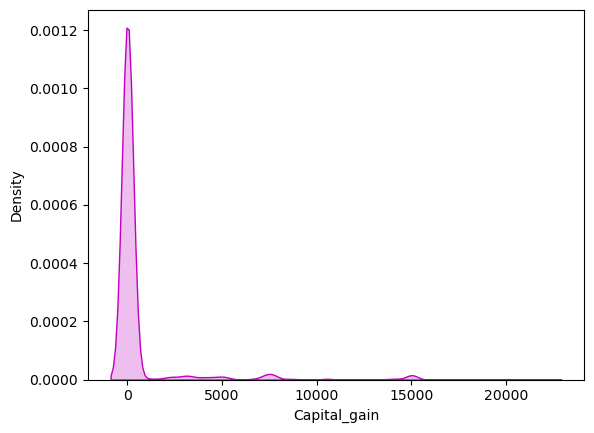

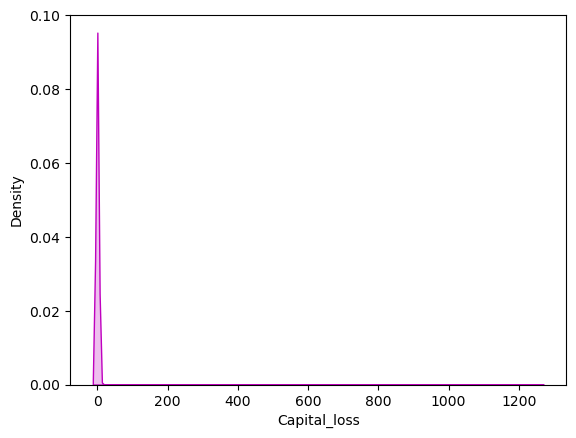

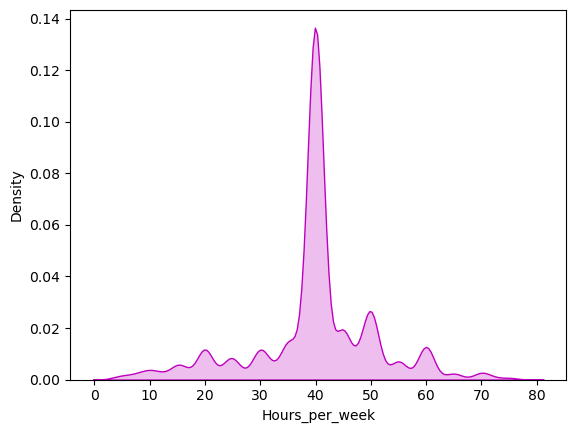

In [51]:
#visualizing the spreading of data
for i in numeric_col:
    sns.distplot(df1[i],color="m",kde_kws={"shade":True},hist=False)
    plt.show()

# Correlation matrix:

In [52]:
corr=df1.corr()
corr

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
Age,1.000000,0.033683,-0.075242,-0.009695,0.038232,-0.272344,-0.002039,-0.263816,0.028514,0.085205,0.131114,0.019968,0.078618,-0.002007,0.231924
Workclass,0.033683,1.000000,-0.023108,0.003289,-0.001082,-0.016038,0.008065,-0.057789,0.046073,0.069207,0.011564,-0.010146,0.026592,-0.001603,-0.007512
Fnlwgt,-0.075242,-0.023108,1.000000,-0.021618,-0.037809,0.027879,-0.002431,0.008344,-0.010182,0.028198,-0.002737,0.002603,-0.014690,-0.059776,-0.009264
Education,-0.009695,0.003289,-0.021618,1.000000,0.350924,-0.035462,-0.041586,-0.010538,0.014869,-0.029867,0.025541,-0.000938,0.057041,0.066117,0.072047
Education_num,0.038232,-0.001082,-0.037809,0.350924,1.000000,-0.059788,0.069465,-0.096076,0.028248,0.009104,0.154633,0.009477,0.151591,0.056992,0.318808
Marital_status,-0.272344,-0.016038,0.027879,-0.035462,-0.059788,1.000000,0.035582,0.184554,-0.065816,-0.123962,-0.068710,-0.013843,-0.196842,-0.015638,-0.194660
Occupation,-0.002039,0.008065,-0.002431,-0.041586,0.069465,0.035582,1.000000,-0.036647,-0.003362,0.050417,0.009530,-0.001861,-0.023502,-0.001366,0.030687
Relationship,-0.263816,-0.057789,0.008344,-0.010538,-0.096076,0.184554,-0.036647,1.000000,-0.116410,-0.576966,-0.090987,0.028821,-0.255402,-0.011216,-0.245256
Race,0.028514,0.046073,-0.010182,0.014869,0.028248,-0.065816,-0.003362,-0.116410,1.000000,0.089686,0.023903,0.001308,0.044892,0.115060,0.071609
Sex,0.085205,0.069207,0.028198,-0.029867,0.009104,-0.123962,0.050417,-0.576966,0.089686,1.000000,0.071367,-0.026317,0.232800,0.002395,0.209725


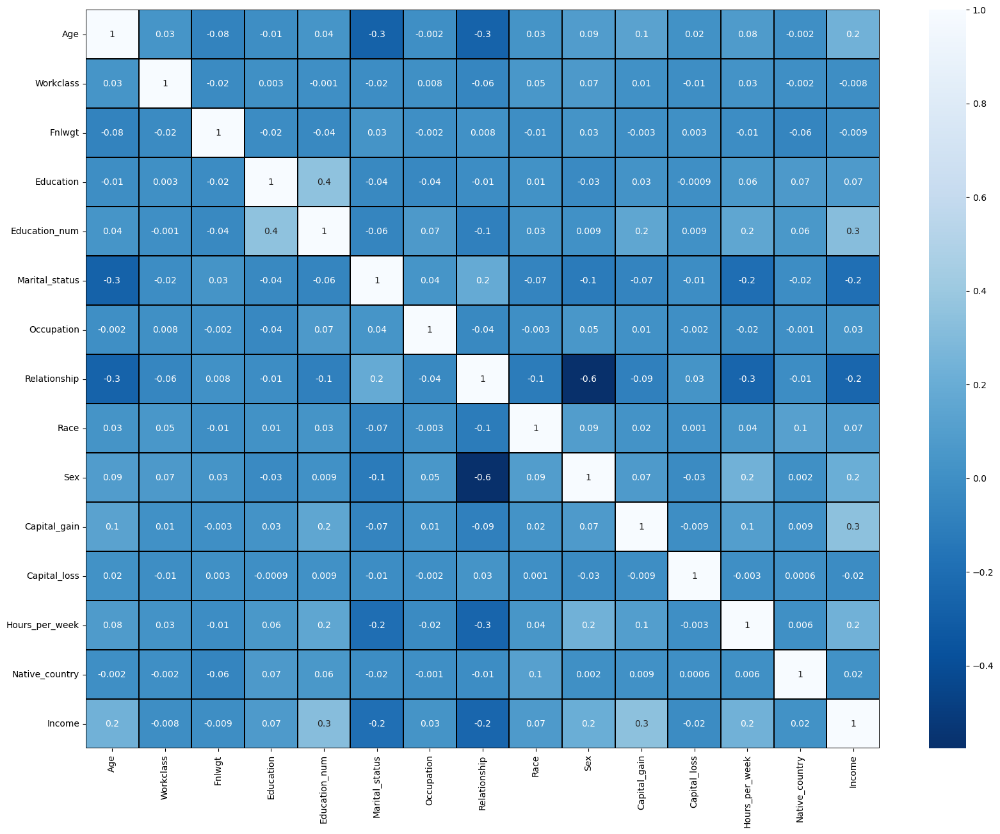

In [53]:
#visualizing the corelation matrix by using the heaatmap
plt.figure(figsize=(20,15))
sns.heatmap(df1.corr(),linewidth=0.1,fmt='0.1g',linecolor="black",annot=True,cmap="Blues_r")
plt.yticks(rotation=0);
plt.show()

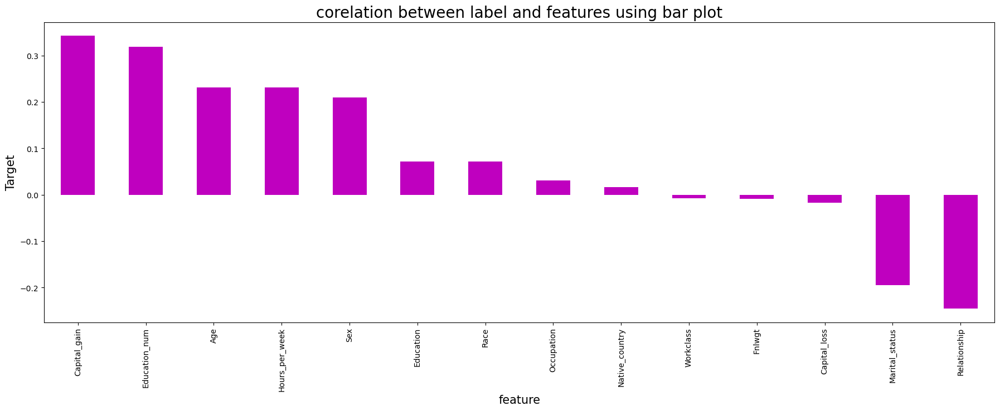

In [54]:
#visualizing the corelation using barplot:
plt.figure(figsize=(22,7))
df1.corr()['Income'].sort_values(ascending=False).drop(['Income']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


## Variance Inflation Factor( Checking for Multicolinearity)

In [55]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif= pd.DataFrame()
vif['VIF']= [variance_inflation_factor(df1.values,i) for i in range(df1.shape[1])]
vif['Features']= df1.columns
vif

,VIF,Features
0,9.005923,Age
1,8.451973,Workclass
2,4.609238,Fnlwgt
3,9.238074,Education
4,21.238771,Education_num
5,4.177363,Marital_status
6,3.354391,Occupation
7,2.735205,Relationship
8,18.002334,Race
9,4.404161,Sex


### Comments:
-> some of the columns "Race", "Education_num","Hours_per_week","Native_Country" are creating higher multicolinearity.. so we have to drop some of the column
-> Here we will use PCA method to select principal component which contribute more towards the accurate prediction.. so that multi colinearity will be avoided

In [56]:
#separating target variable and input variable

x=df1.drop('Income',axis=1)
y=df1['Income']

In [57]:
x

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country
0,50,5.0,83311,9.0,13,2.0,3.0,0.0,4.0,1.0,0,0,13,38.0
1,38,3.0,215646,11.0,9,0.0,5.0,1.0,4.0,1.0,0,0,40,38.0
2,53,3.0,234721,1.0,7,2.0,5.0,0.0,2.0,1.0,0,0,40,38.0
3,28,3.0,338409,9.0,13,2.0,9.0,5.0,2.0,0.0,0,0,40,4.0
4,37,3.0,284582,12.0,14,2.0,3.0,5.0,4.0,0.0,0,0,40,38.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32555,27,3.0,257302,7.0,12,2.0,12.0,5.0,4.0,0.0,0,0,38,38.0
32556,40,3.0,154374,11.0,9,2.0,6.0,0.0,4.0,1.0,0,0,40,38.0
32557,58,3.0,151910,11.0,9,6.0,0.0,4.0,4.0,0.0,0,0,40,38.0
32558,22,3.0,201490,11.0,9,4.0,0.0,3.0,4.0,1.0,0,0,20,38.0


#### Scaling the input variables:

In [58]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country
0,0.859134,1.732370,-1.077134,-0.339463,1.190127,-0.411550,-0.780889,-0.918479,0.393701,0.716134,-0.244649,-0.036921,-2.404148,0.255718
1,-0.022463,-0.078688,0.322764,0.177032,-0.438231,-1.730000,-0.279103,-0.297193,0.393701,0.716134,-0.244649,-0.036921,0.012374,0.255718
2,1.079533,-0.078688,0.524547,-2.405444,-1.252411,-0.411550,-0.279103,-0.918479,-1.957813,0.716134,-0.244649,-0.036921,0.012374,0.255718
3,-0.757127,-0.078688,1.621404,-0.339463,1.190127,-0.411550,0.724467,2.187951,-1.957813,-1.396387,-0.244649,-0.036921,0.012374,-5.443072
4,-0.095930,-0.078688,1.051999,0.435280,1.597217,-0.411550,-0.780889,2.187951,0.393701,-1.396387,-0.244649,-0.036921,0.012374,0.255718
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29904,-0.830594,-0.078688,0.763419,-0.855958,0.783037,-0.411550,1.477145,2.187951,0.393701,-1.396387,-0.244649,-0.036921,-0.166628,0.255718
29905,0.124470,-0.078688,-0.325398,0.177032,-0.438231,-0.411550,-0.028211,-0.918479,0.393701,0.716134,-0.244649,-0.036921,0.012374,0.255718
29906,1.446865,-0.078688,-0.351464,0.177032,-0.438231,2.225349,-1.533567,1.566665,0.393701,-1.396387,-0.244649,-0.036921,0.012374,0.255718
29907,-1.197926,-0.078688,0.173015,0.177032,-0.438231,0.906900,-1.533567,0.945379,0.393701,0.716134,-0.244649,-0.036921,-1.777642,0.255718


In [59]:
y.value_counts()

0.0    23243
1.0     6666
Name: Income, dtype: int64

#### Balancing the target variable count:

In [60]:
!pip install -U imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable


In [61]:
# to balance the target variable data over sampling is performed:
from imblearn.over_sampling import SMOTE
sm=SMOTE()
x1,y1=sm.fit_resample(x,y)

#### Selecting the Principal components :

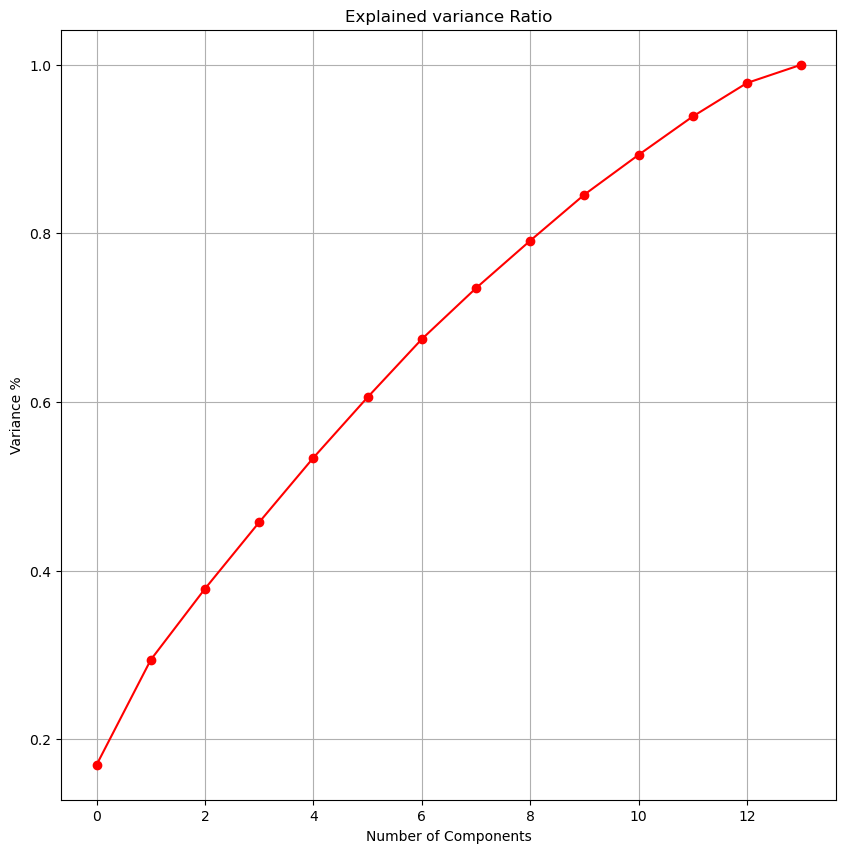

In [62]:
from sklearn.decomposition import PCA
pca = PCA()
#plot the graph to find the principal components
x_pca = pca.fit_transform(x1)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

In [63]:
pca_new = PCA(n_components=12)
x_new = pca_new.fit_transform(x1)

In [64]:
x_new=pd.DataFrame(x_new,columns=np.arange(12))

## Modelling:


from the target variable we can observe that the given problem statement iS a binary classification problem (<=50k is taken as 0 and >50 k is considered as 1).. so we can apply Naive Bayes classifier, logistic regression knn descission tree.. 

In [65]:
#finding the best random state:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.model_selection import cross_val_score


In [66]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
maxAcc=0
maxRs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x_new,y1,test_size=.25,random_state=i)
    LR=LogisticRegression()
    LR.fit(x_train,y_train)
    pred=LR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum acc_score is",maxAcc, "on random_state",maxRs)        

maximum acc_score is 0.7794699707451386 on random_state 90


In [67]:
# creating train test split:
x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=0.25,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(34864, 14)
(34864,)
(11622, 14)
(11622,)


In [68]:
#Logistic regression model:
logR=LogisticRegression()
logR.fit(x_train,y_train)
pred_train=logR.predict(x_train)
pred_Lgr=logR.predict(x_test)
print("predicted accuracy",accuracy_score(y_test,pred_Lgr))
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(confusion_matrix(y_test,pred_Lgr))
print(classification_report(y_test,pred_Lgr))


predicted accuracy 0.7779211839614524
accuracy score of original y_test data 0.7662058283616338
[[4458 1367]
 [1214 4583]]
              precision    recall  f1-score   support

         0.0       0.79      0.77      0.78      5825
         1.0       0.77      0.79      0.78      5797

    accuracy                           0.78     11622
   macro avg       0.78      0.78      0.78     11622
weighted avg       0.78      0.78      0.78     11622



In [69]:
#DecissionTreeClassifier:
from sklearn.tree import DecisionTreeClassifier
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
pred_dtc=dtc.predict(x_test)
pred_train=dtc.predict(x_train)
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(accuracy_score(y_test,pred_dtc))
print(confusion_matrix(y_test,pred_dtc))
print(classification_report(y_test,pred_dtc))

accuracy score of original y_test data 1.0
0.8632765444845982
[[4995  830]
 [ 759 5038]]
              precision    recall  f1-score   support

         0.0       0.87      0.86      0.86      5825
         1.0       0.86      0.87      0.86      5797

    accuracy                           0.86     11622
   macro avg       0.86      0.86      0.86     11622
weighted avg       0.86      0.86      0.86     11622



In [70]:
#RandomForestClassifier:
RFC=RandomForestClassifier()
RFC.fit(x_train,y_train)
pred_RFC=RFC.predict(x_test)
print(accuracy_score(y_test,pred_RFC))
print(confusion_matrix(y_test,pred_RFC))
print(classification_report(y_test,pred_RFC))


0.9071588366890381
[[5208  617]
 [ 462 5335]]
              precision    recall  f1-score   support

         0.0       0.92      0.89      0.91      5825
         1.0       0.90      0.92      0.91      5797

    accuracy                           0.91     11622
   macro avg       0.91      0.91      0.91     11622
weighted avg       0.91      0.91      0.91     11622



In [71]:
#KNeighborsClassifier:
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
print(accuracy_score(y_test,pred_knn))
print(confusion_matrix(y_test,pred_knn))
print(classification_report(y_test,pred_knn))


0.8695577353295474
[[4631 1194]
 [ 322 5475]]
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86      5825
         1.0       0.82      0.94      0.88      5797

    accuracy                           0.87     11622
   macro avg       0.88      0.87      0.87     11622
weighted avg       0.88      0.87      0.87     11622



In [72]:
#GaussianNB:
gnb = GaussianNB()
gnb.fit(x_train,y_train)
pred_gnb=gnb.predict(x_test)
print(accuracy_score(y_test,pred_gnb))
print(confusion_matrix(y_test,pred_gnb))
print(classification_report(y_test,pred_gnb))


0.7817931509206677
[[4179 1646]
 [ 890 4907]]
              precision    recall  f1-score   support

         0.0       0.82      0.72      0.77      5825
         1.0       0.75      0.85      0.79      5797

    accuracy                           0.78     11622
   macro avg       0.79      0.78      0.78     11622
weighted avg       0.79      0.78      0.78     11622



## Cross Validating the Models:

In [73]:
# cross validation of the model:
from sklearn.model_selection import cross_val_score

In [74]:
score_LR=cross_val_score(logR,x_new,y1)           #cross validation score of logistic regression
print(score_LR)
print(score_LR.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_Lgr)-(score_LR.mean()))

[0.75855023 0.76981822 0.7668065  0.77476605 0.77777778]
0.7695437549698643
diff b/w accuracy score and cross validation score is: 0.00837742899158811


In [75]:
score_dtc=cross_val_score(dtc,x_new,y1)           #cross validation score of dtc
print(score_dtc)
print(score_dtc.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_dtc)-(score_dtc.mean()))

[0.82178963 0.82962246 0.839303   0.85360869 0.84661719]
0.8381881942641243
diff b/w accuracy score and cross validation score is: 0.025088350220473954


In [76]:
score_RFC=cross_val_score(RFC,x_new,y1)                           #cross validation score of RandomForest
print(score_RFC)
print(score_RFC.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_RFC)-(score_RFC.mean()))

[0.87244569 0.88092933 0.89523502 0.90007529 0.89835431]
0.8894079284567658
diff b/w accuracy score and cross validation score is: 0.017750908232272322


In [77]:
score_knn=cross_val_score(knn,x_new,y1)                           #cross validation score of knn
print(score_knn)
print(score_knn.mean())
print("diff b/w acscuracy score and cross validation score is:",accuracy_score(y_test,pred_knn)-(score_knn.mean()))

[0.84179393 0.84704743 0.8667312  0.8639346  0.86995805]
0.8578930451987915
diff b/w acscuracy score and cross validation score is: 0.011664690130755884


In [78]:
score_gnb=cross_val_score(gnb,x_new,y1)                           #cross validation score of GaussianNB
print(score_gnb)
print(score_gnb.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_gnb)-(score_gnb.mean()))

[0.67917832 0.69742928 0.70485103 0.70431322 0.70915349]
0.6989850666168029
diff b/w accuracy score and cross validation score is: 0.08280808430386477


##### By varifyig the cross validation score and the accuracy score we can conclude that Random Forest model is the model giving  better accuracy

## Hyper Parameter Tuning:

In [79]:
from sklearn.model_selection import GridSearchCV
parameter = {  'bootstrap': [True], 'max_depth': [5, 10,20,40,50,60], 
              'max_features': ['auto', 'log2'], 
              'criterion':['gini','entropy'],
              'n_estimators': [5, 10, 15 ,25,50,60,70]}
GCV = GridSearchCV(RandomForestClassifier(),parameter,cv=5)
GCV.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'bootstrap': [True], 'criterion': ['gini', 'entropy'],
                         'max_depth': [5, 10, 20, 40, 50, 60],
                         'max_features': ['auto', 'log2'],
                         'n_estimators': [5, 10, 15, 25, 50, 60, 70]})

In [80]:
GCV.best_params_

{'bootstrap': True,
 'criterion': 'gini',
 'max_depth': 40,
 'max_features': 'auto',
 'n_estimators': 60}

In [81]:
MODEL_INCOME=RandomForestClassifier(bootstrap= True,criterion= 'gini',max_depth= 40,max_features= 'auto',n_estimators= 60)

# Final Model

In [82]:
MODEL_INCOME.fit(x_train,y_train)
pred=MODEL_INCOME.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

90.78471863706763


#### In Final Model we are getting 90.784% accuracy

In [83]:
import joblib
joblib.dump(MODEL_INCOME,'Census Income analysis')


['Census Income analysis']

In [84]:
RFC_CENSUS_INCOME=joblib.load('Census Income Analysis')
predictionM=RFC_CENSUS_INCOME.predict(x_test)
predictionM

array([1., 1., 0., ..., 0., 0., 1.])

In [85]:
a=np.array(y_test)
DF_CENSUS=pd.DataFrame()
DF_CENSUS['predicted']=predictionM
DF_CENSUS['original']=a
DF_CENSUS

,predicted,original
0,1.0,1.0
1,1.0,1.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
...,...,...
11617,0.0,0.0
11618,1.0,1.0
11619,0.0,0.0
11620,0.0,0.0


# Project.2: Rainfall Weather Forecasting

## Project Description:
Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.
Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:
 
1. Problem Statement: 
a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.
b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.


#### Dataset Description:
Number of columns: 23


-> Date  - The date of observation
-> Location  -The common name of the location of the weather station
-> MinTemp  -The minimum temperature in degrees celsius
-> MaxTemp -The maximum temperature in degrees celsius
-> Rainfall  -The amount of rainfall recorded for the day in mm
-> Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am
-> Sunshine  -The number of hours of bright sunshine in the day.
-> WindGustDi r- The direction of the strongest wind gust in the 24 hours to midnight
-> WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight
-> WindDir9am -Direction of the wind at 9am
-> WindDir3pm -Direction of the wind at 3pm
-> WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am
-> WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm
-> Humidity9am -Humidity (percent) at 9am
-> Humidity3pm -Humidity (percent) at 3pm
-> Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am
-> Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm
-> Cloud9am - Fraction of sky obscured by cloud at 9am. 
-> Cloud3pm -Fraction of sky obscured by cloud 
-> Temp9am-Temperature (degrees C) at 9am
-> Temp3pm -Temperature (degrees C) at 3pm
-> RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0
-> RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".

Dataset Link-  
•https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv
•https://github.com/dsrscientist/dataset3



## Data Loading

In [86]:
df_rain=pd.read_csv('weatherAUS.csv')
df_rain

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


## EDA

In [87]:
df_rain.shape

(8425, 23)

In [88]:
df_rain.duplicated().sum()

1663

In [89]:
df_rain.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

#### Comments:
-> most of the columns are of float datatype and some of columns are of "object" data type
-> the data set contains total 8425 rows 23 columns.. out of which 21 input variables and 2 target variable "Rain Tomorrow","Rainfall"

In [90]:
df_rain.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

<AxesSubplot:>

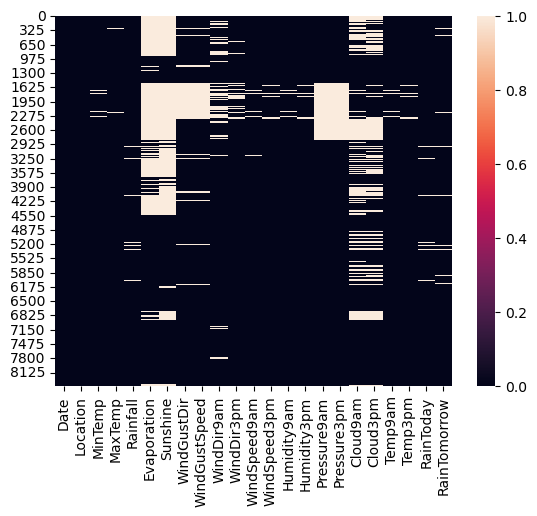

In [91]:
## Visualizing through heatmap:
sns.heatmap(df_rain.isnull())

#### Comments:
we can fill the null values by mean or mode of the values according to numerical or categorical data

In [92]:
df_rain['MinTemp']=df_rain['MinTemp'].fillna(df_rain['MinTemp'].mean())
df_rain['MaxTemp']=df_rain['MinTemp'].fillna(df_rain['MaxTemp'].mean())
df_rain['Rainfall']=df_rain['Rainfall'].fillna(df_rain['Rainfall'].mean())
df_rain['Evaporation']=df_rain['Evaporation'].fillna(df_rain['Evaporation'].mean())
df_rain['Sunshine']=df_rain['Sunshine'].fillna(df_rain['Sunshine'].mean())
df_rain['WindGustSpeed']=df_rain['WindGustSpeed'].fillna(df_rain['WindGustSpeed'].mean())
df_rain['WindSpeed9am']=df_rain['WindSpeed9am'].fillna(df_rain['WindSpeed9am'].mean())
df_rain['WindSpeed3pm']=df_rain['WindSpeed3pm'].fillna(df_rain['WindSpeed3pm'].mean())
df_rain['Humidity9am']=df_rain['Humidity9am'].fillna(df_rain['Humidity9am'].mean())
df_rain['Humidity3pm']=df_rain['Humidity3pm'].fillna(df_rain['Humidity3pm'].mean())
df_rain['Pressure9am']=df_rain['Pressure9am'].fillna(df_rain['Pressure9am'].mean())
df_rain['Pressure3pm']=df_rain['Pressure3pm'].fillna(df_rain['Pressure3pm'].mean())
df_rain['Cloud9am']=df_rain['Cloud9am'].fillna(df_rain['Cloud9am'].mean())
df_rain['Cloud3pm']=df_rain['Cloud3pm'].fillna(df_rain['Cloud3pm'].mean())
df_rain['Temp9am']=df_rain['Temp9am'].fillna(df_rain['Temp9am'].mean())
df_rain['Temp3pm']=df_rain['Temp3pm'].fillna(df_rain['Temp3pm'].mean())

In [93]:
df_rain['RainToday']=df_rain['RainToday'].fillna(df_rain['RainToday'].mode()[0])
df_rain['RainTomorrow']=df_rain['RainTomorrow'].fillna(df_rain['RainTomorrow'].mode()[0])
df_rain['WindDir9am'] = df_rain['WindDir9am'].fillna(df_rain['WindDir9am'].mode()[0])
df_rain['WindGustDir'] =df_rain['WindGustDir'].fillna(df_rain['WindGustDir'].mode()[0])
df_rain['WindDir3pm'] = df_rain['WindDir3pm'].fillna(df_rain['WindDir3pm'].mode()[0])

In [94]:
df_rain.isnull().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

<AxesSubplot:>

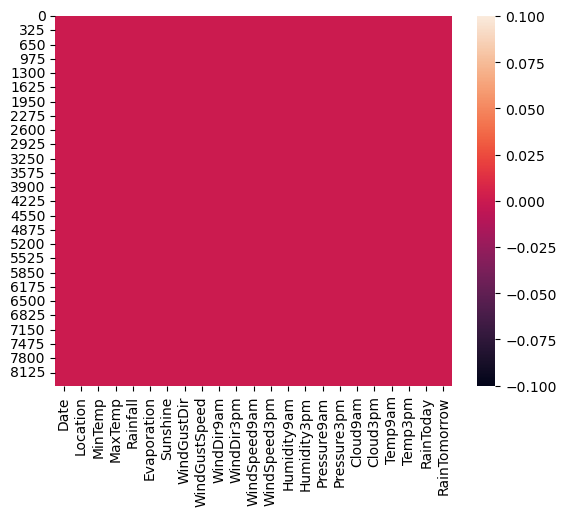

In [95]:
## Visualizing through Heatmap:
sns.heatmap(df_rain.isnull())

#### Now all the NAN values are replaced... so we can proceed 

In [96]:
#### Target Variable1: 
df_rain['RainTomorrow'].value_counts()

No     6434
Yes    1991
Name: RainTomorrow, dtype: int64

##### The first target variable "RainTomorrow" contains only two category.. so we can consider it as a Binary Classification problem.. and apply classification model to it

In [97]:
### Target Variable 2:
df_rain['Rainfall'].value_counts()


0.000000      5299
0.200000       406
2.805913       240
0.400000       177
0.600000       116
              ... 
61.200000        1
128.000000       1
90.000000        1
34.400000        1
40.000000        1
Name: Rainfall, Length: 251, dtype: int64

##### Here the target variable 2 "Rainfall" contains continues data.. so we can apply regression model for the prediction

## Statistical Description:

In [98]:
df_rain.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.193305,13.193305,2.805913,5.389395,7.632205,40.174469,13.847646,18.533662,67.822496,51.249790,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.442934
std,5.379488,5.379488,10.309308,3.852004,2.825451,13.776101,10.128579,9.704759,16.774231,18.311894,6.275759,6.217451,2.429205,2.299419,5.608301,5.945849
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,0.000000,0.000000,1.900000,7.300000
25%,9.300000,9.300000,0.000000,4.000000,7.632205,31.000000,6.000000,11.000000,56.000000,39.000000,1014.000000,1011.400000,3.000000,3.000000,13.800000,18.100000
50%,13.200000,13.200000,0.000000,5.389395,7.632205,40.174469,13.000000,19.000000,68.000000,51.000000,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.000000
75%,17.300000,17.300000,1.400000,5.389395,8.900000,48.000000,20.000000,24.000000,80.000000,63.000000,1021.300000,1018.800000,7.000000,7.000000,21.900000,26.300000
max,28.500000,28.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,8.000000,8.000000,39.400000,44.100000


### Comments:
-> The count of all the columns are same which shows there is no missing value
-> There is a considerable gap between 75% and the max value which shows the presence of Outliers in the dataset
-> in target varibale "Rainfall" the mean is greater than median (50%) which shows data is right skewed
-?in "min temp","max temp","Evaporation","sunshine","Windgustspeed" etc the data is normally distributed

# Data Visualization:


## Univariate Analysis:


###### Analyzing the target Column:

No     6434
Yes    1991
Name: RainTomorrow, dtype: int64


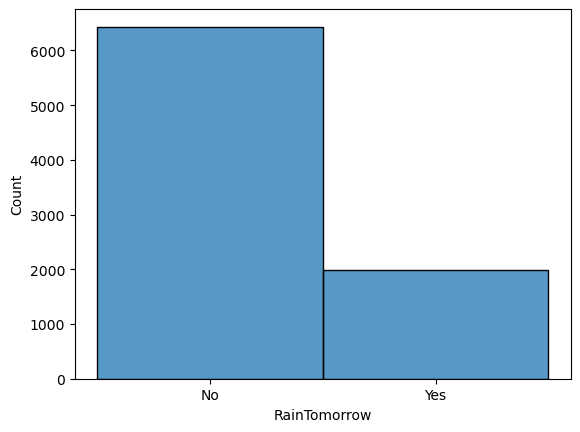

In [99]:
#visualizing Rainfall Tomorrow
p=sns.histplot(x='RainTomorrow',data=df_rain)
print(df_rain['RainTomorrow'].value_counts())

#### observations:
-> Chances of No Rain Tomorrow is greater than the chances of Raining.

No     6435
Yes    1990
Name: RainToday, dtype: int64


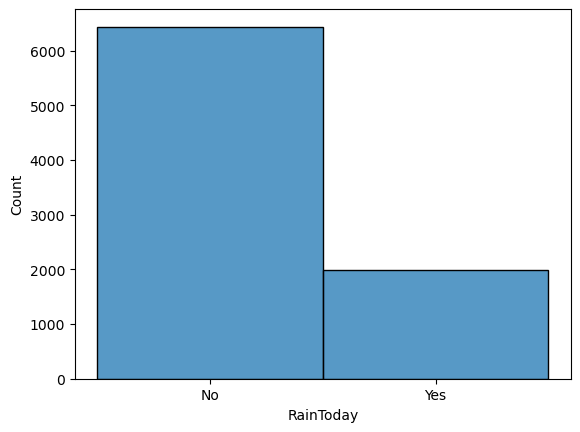

In [100]:
#visualizing Rainfall Today
p=sns.histplot(x='RainToday',data=df_rain)
print(df_rain['RainToday'].value_counts())

Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64


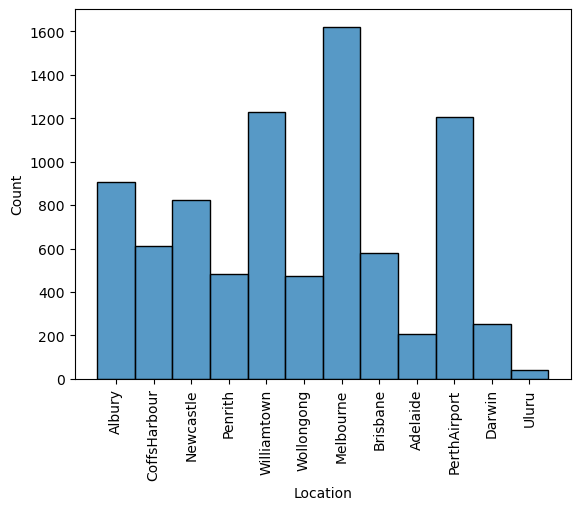

In [101]:
#visualizing Location
p=sns.histplot(x='Location',data=df_rain)
plt.xticks(rotation=90)
print(df_rain['Location'].value_counts())

#### Observations:
-> "Melbourne" city has recorded highest Rain Fall in Past.. so Chances of rain Tomorrow in this city is Higher
-> After Melbourne, Williamtown and PerthAirport has highest rainfall recorded
-> "Uluru" Location has the Lowest value of rain fall recorded in the past years

N      1735
SW      704
NW      625
WSW     543
SE      505
WNW     480
SSW     467
ENE     433
NNE     430
W       414
NE      409
S       402
E       380
SSE     365
NNW     280
ESE     253
Name: WindDir9am, dtype: int64


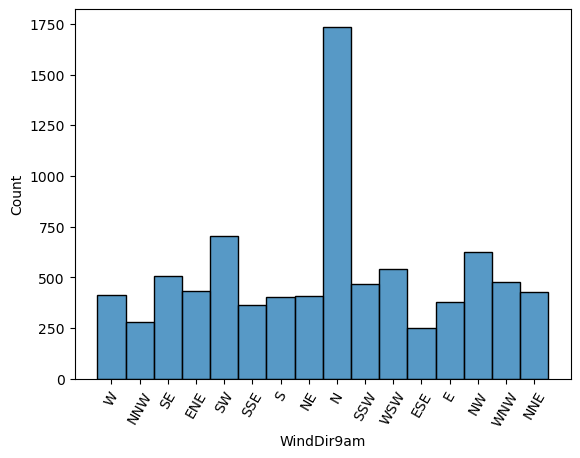

In [102]:
#visualizing WindDir9am
p=sns.histplot(x='WindDir9am',data=df_rain)
plt.xticks(rotation=60)
print(df_rain['WindDir9am'].value_counts())

#### Observations:
-> At 9Am highest Wind Flow is From "North" direction.. 
-> From other direction it is normal

SE     1121
S       742
SSE     623
WSW     580
NE      544
N       524
SW      494
WNW     487
NW      468
W       462
ESE     462
E       460
ENE     417
SSW     370
NNE     365
NNW     306
Name: WindDir3pm, dtype: int64


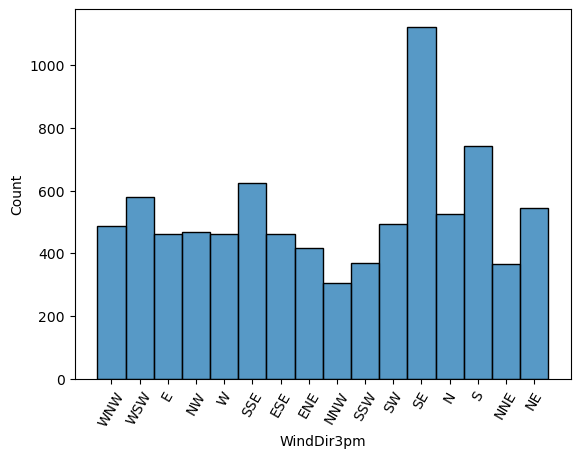

In [103]:
#visualizing WindDir3pm
p=sns.histplot(x='WindDir3pm',data=df_rain)
plt.xticks(rotation=60)
print(df_rain['WindDir3pm'].value_counts())

#### Observations:
-> Highest Windflow from "SouthEast" direction is recorded at 3pm
->The from other direction it is almost uniform

### BiVariate Analysis:

<function matplotlib.pyplot.show(close=None, block=None)>

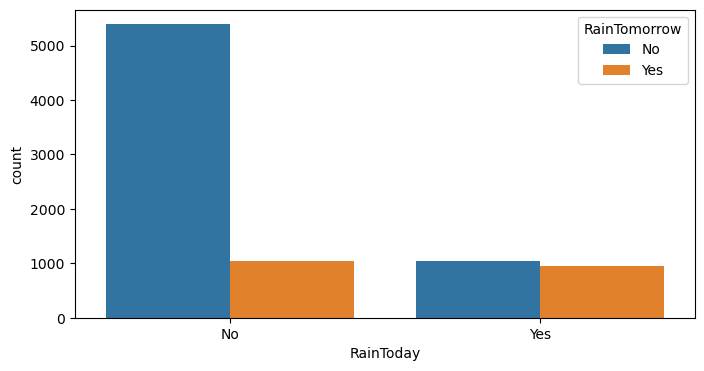

In [104]:
# RainToday vs RainTomorrow
plt.figure(figsize=(8,4))
sns.countplot(x="RainToday", hue="RainTomorrow", data=df_rain)
plt.show

#### Observations:
-> from the above plot we can observe that "Today's Rainfall" has almost no impact on "Tomorrow Rain fall"
-> we can see The chances for Raintomorrow is 50-50

<function matplotlib.pyplot.show(close=None, block=None)>

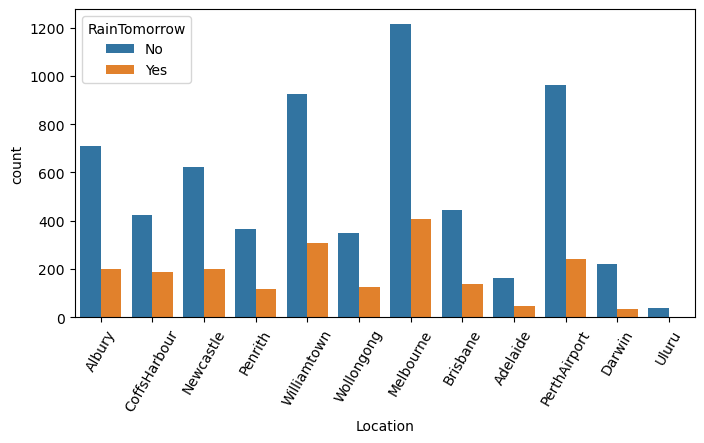

In [105]:
# Location vs RainTomorrow
plt.figure(figsize=(8,4))
sns.countplot(x="Location", hue="RainTomorrow", data=df_rain)
plt.xticks(rotation=60)
plt.show


#### Rain fall chances for tomorrow is higher in locations like (1.Melbourne, 2.Williamtown, 3.PerthAirport, 4.Newcastle) etc

<function matplotlib.pyplot.show(close=None, block=None)>

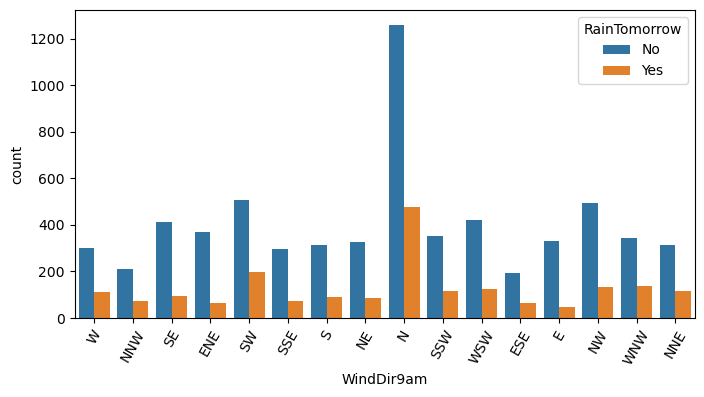

In [106]:
# WindDir9am vs RainTomorrow
plt.figure(figsize=(8,4))
sns.countplot(x="WindDir9am", hue="RainTomorrow", data=df_rain)
plt.xticks(rotation=60)
plt.show

#### we can say Wind Direction is predicting more towards Rainfall Toorrow, in North direction WindFlow is more , and chances of rain is also higer

<function matplotlib.pyplot.show(close=None, block=None)>

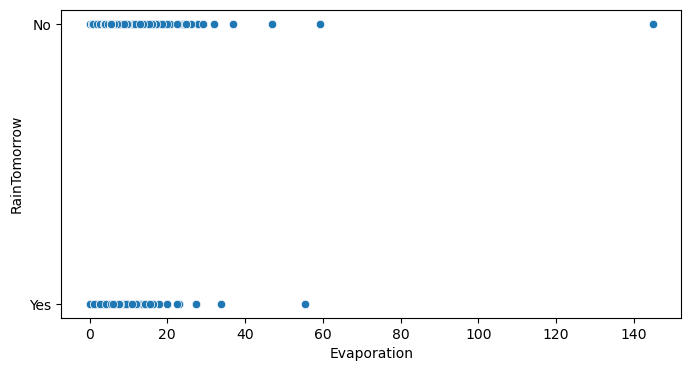

In [107]:
# Evaporation vs RainTomorrow
plt.figure(figsize=(8,4))
sns.scatterplot(x="Evaporation", y="RainTomorrow", data=df_rain)
plt.show

## Pairplot

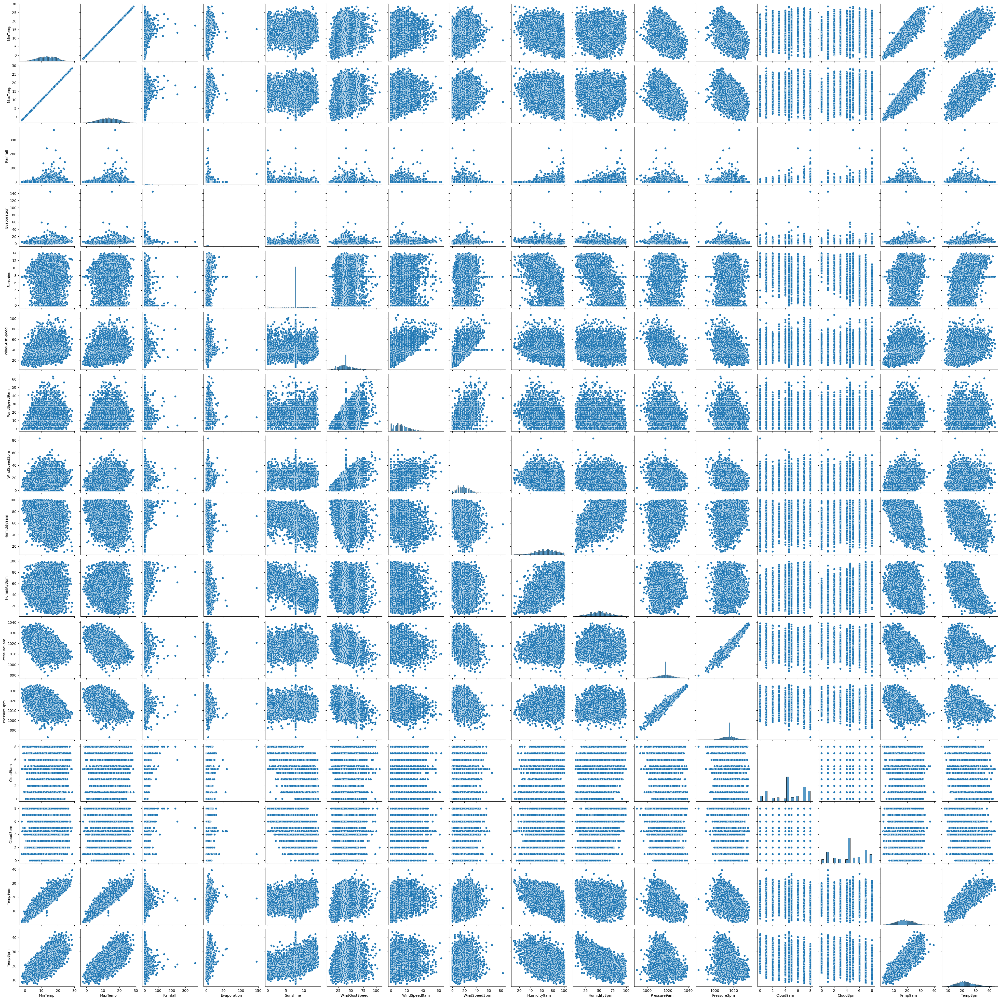

In [108]:
sns.pairplot(df_rain)

# Feature Engineering:

In [109]:
# Encoding Categorical Columns:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in df_rain.columns:
    if df_rain[i].dtypes=="object":
        df_rain[i]=OE.fit_transform(df_rain[i].values.reshape(-1,1))    
df_rain       

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,0.0,1.0,13.4,13.4,0.6,5.389395,7.632205,13.0,44.000000,13.0,...,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0.0,0.0
1,1.0,1.0,7.4,7.4,0.0,5.389395,7.632205,14.0,44.000000,6.0,...,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0.0,0.0
2,2.0,1.0,12.9,12.9,0.0,5.389395,7.632205,15.0,46.000000,13.0,...,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0.0,0.0
3,3.0,1.0,9.2,9.2,0.0,5.389395,7.632205,4.0,24.000000,9.0,...,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0.0,0.0
4,4.0,1.0,17.5,17.5,1.0,5.389395,7.632205,13.0,41.000000,1.0,...,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2999.0,9.0,2.8,2.8,0.0,5.389395,7.632205,0.0,31.000000,9.0,...,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0.0,0.0
8421,3000.0,9.0,3.6,3.6,0.0,5.389395,7.632205,6.0,22.000000,9.0,...,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0.0,0.0
8422,3001.0,9.0,5.4,5.4,0.0,5.389395,7.632205,3.0,37.000000,9.0,...,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0.0,0.0
8423,3002.0,9.0,7.8,7.8,0.0,5.389395,7.632205,9.0,28.000000,10.0,...,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0.0,0.0


## Outlier Detection:

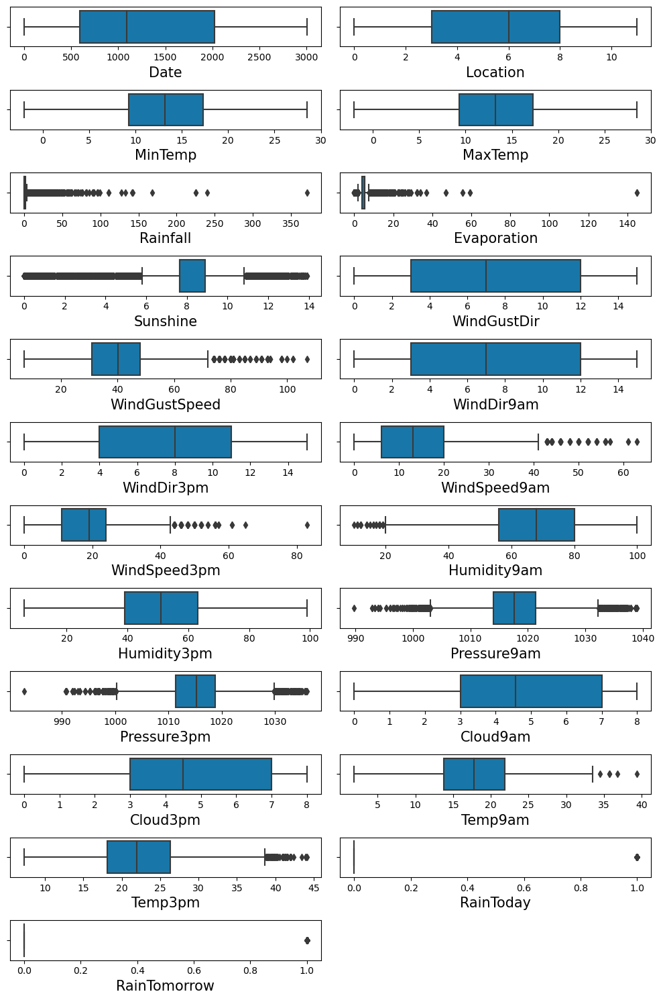

In [110]:
# checking for outliers
plt.figure(figsize=(10,15),facecolor="white")
plotnum=1
for i in df_rain.columns:
    if plotnum<=24:
        p=plt.subplot(12,2,plotnum)
        sns.boxplot(df_rain[i],palette='winter_r')
        plt.xlabel(i,fontsize=15)
        plt.yticks(rotation=0,fontsize=10)
        plotnum+=1
plt.tight_layout()    

In [567]:
#removing outliers:
#z-score method:
from scipy.stats import zscore
out_features=df_rain[['Evaporation','Sunshine','WindGustSpeed','WindSpeed9am','WindSpeed3pm','Humidity9am','Pressure9am','Pressure3pm','Temp9am','Temp3pm']]
z=np.abs(zscore(out_features))
z

,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Pressure9am,Pressure3pm,Temp9am,Temp3pm
0,2.305893e-16,1.257472e-15,0.277710,0.607461,0.563297,0.189439,1.584003,1.308665,0.153712,0.108138
1,2.305893e-16,1.257472e-15,0.277710,0.972321,0.357200,1.420268,1.121880,1.196072,0.100217,0.312348
2,2.305893e-16,1.257472e-15,0.422897,0.508725,0.769394,1.777981,1.599939,1.051309,0.577390,0.127334
3,2.305893e-16,1.257472e-15,1.174166,0.281166,0.982428,1.360650,0.006411,0.391836,0.060269,0.682376
4,2.305893e-16,1.257472e-15,0.059928,0.676112,0.151104,0.845246,1.090010,1.485596,0.006773,1.220599
...,...,...,...,...,...,...,...,...,...,...
8420,2.305893e-16,1.257472e-15,0.666009,0.083694,0.776331,1.002937,1.109058,0.814518,1.366273,0.007221
8421,2.305893e-16,1.257472e-15,1.319354,0.083694,0.982428,0.704843,0.933770,0.621501,1.223619,0.345987
8422,2.305893e-16,1.257472e-15,0.230447,0.478639,0.982428,0.883699,0.535388,0.251553,0.938310,0.615099
8423,2.305893e-16,1.257472e-15,0.883791,0.083694,1.188525,1.002937,0.280424,0.203299,0.474684,0.598279


In [568]:
#threshold=3
np.where(z>3)

(array([  12,   12,   44,   52,   52,   60,   61,   62,   62,   67,   68,
         123,  267,  296,  381,  381,  405,  406,  407,  563,  568,  568,
         569,  602,  683,  683,  748,  748,  980,  980, 1189, 1535, 1587,
        1644, 1665, 1898, 1903, 1945, 2016, 2028, 2043, 2074, 2186, 2219,
        2219, 2230, 2500, 2505, 2527, 2827, 2835, 2849, 2855, 2859, 2863,
        2869, 2877, 2883, 2891, 2897, 2905, 2911, 2919, 2925, 2933, 2939,
        2947, 2953, 2961, 2967, 2975, 2989, 3051, 3058, 3059, 3059, 3060,
        3066, 3067, 3067, 3067, 3068, 3070, 3082, 3082, 3082, 3089, 3089,
        3099, 3099, 3101, 3141, 3150, 3153, 3157, 3164, 3167, 3172, 3172,
        3178, 3185, 3206, 3212, 3212, 3213, 3221, 3227, 3234, 3248, 3260,
        3271, 3278, 3291, 3302, 3303, 3449, 3449, 3449, 3450, 3450, 3458,
        3471, 3491, 3557, 3602, 3603, 3617, 3679, 3687, 3701, 3707, 3711,
        3715, 3721, 3729, 3735, 3743, 3749, 3757, 3763, 3771, 3777, 3785,
        3791, 3799, 3805, 3813, 3819, 

In [569]:
# we have to removethese rows which have outliers:
df1_rain=df_rain[(z<3).all(axis=1)]
df1_rain.shape          # after removing outliers the data frame size

(8095, 23)

In [570]:
#originaldata frame size
df_rain.shape

(8425, 23)

In [571]:
#data loss percentage:
print("data loss percentage",((df_rain.shape[0]-df1_rain.shape[0])/df_rain.shape[0])*100)

data loss percentage 3.9169139465875373


###### The data loss percentage is affordable so we can proceed with z-score method

In [572]:
#checking for skewness present in the data:
df1_rain.skew()

Date              0.398651
Location         -0.035796
MinTemp          -0.094538
MaxTemp          -0.094538
Rainfall         13.897092
Evaporation       0.844939
Sunshine         -0.729992
WindGustDir       0.111452
WindGustSpeed     0.509079
WindDir9am        0.152240
WindDir3pm       -0.129575
WindSpeed9am      0.712369
WindSpeed3pm      0.301024
Humidity9am      -0.237214
Humidity3pm       0.125872
Pressure9am       0.024754
Pressure3pm       0.047523
Cloud9am         -0.364928
Cloud3pm         -0.273745
Temp9am          -0.038715
Temp3pm           0.341420
RainToday         1.232771
RainTomorrow      1.255370
dtype: float64

#### Comments:
-> Here we can see only the " Rainfall" column has highest skewness value of 13.89.. but as this one is the target variable so no transformation needed for this..
-> remaining  "raintomorrow" columns contains skewness value greater than one which are also target variable so no need of any transformation technique here
-> in RainToday column the skewness can be trasformed by scling technique which we will use furthur to scale the input variables

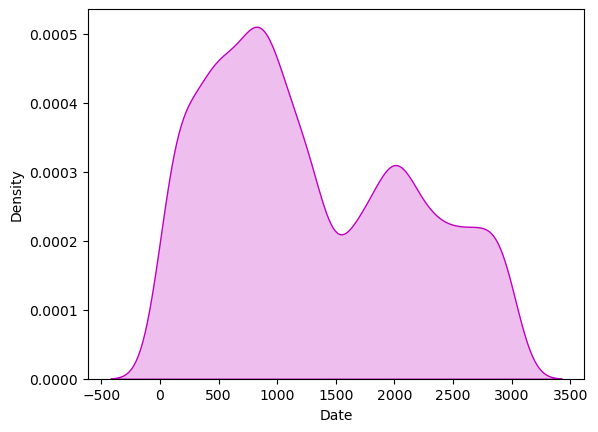

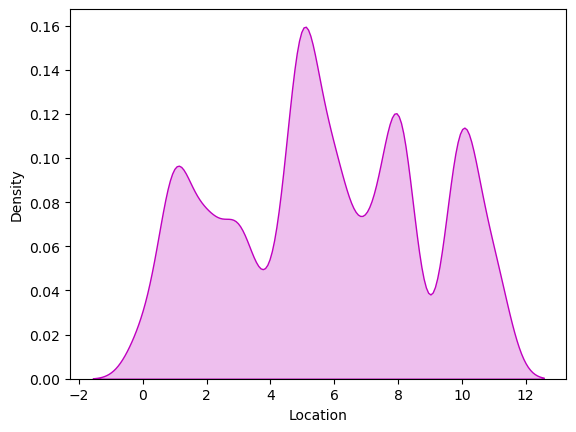

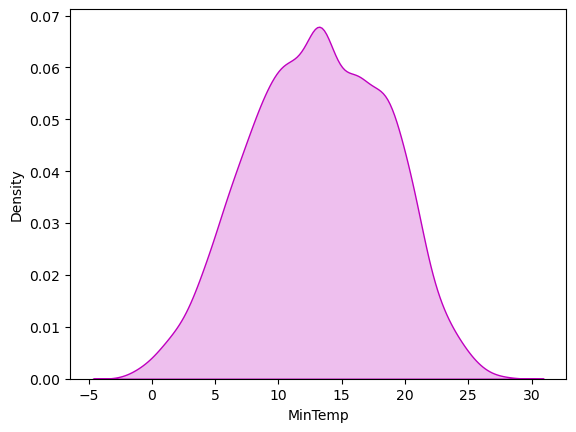

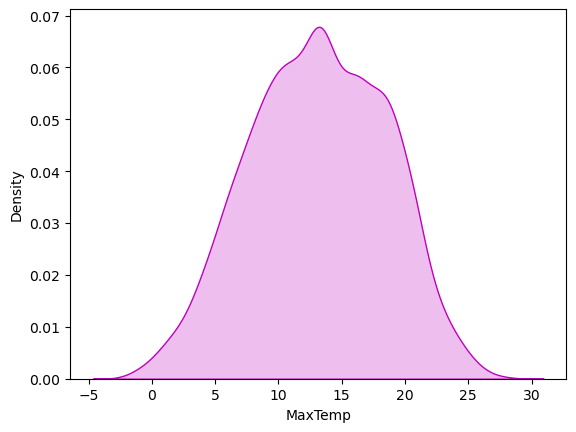

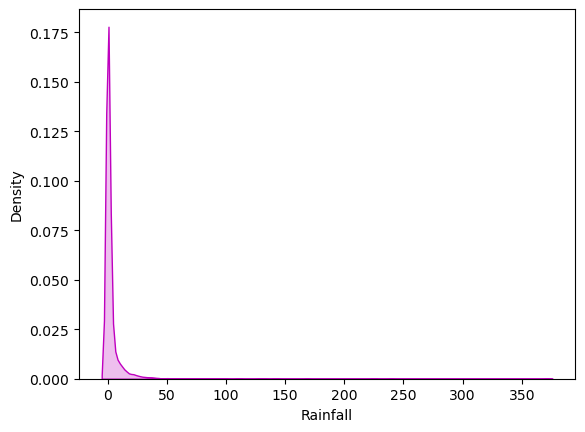

...

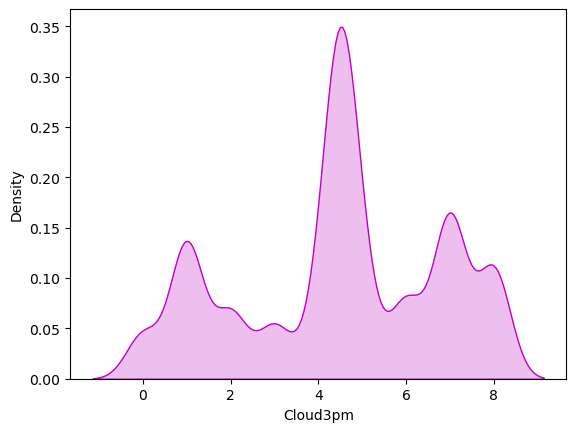

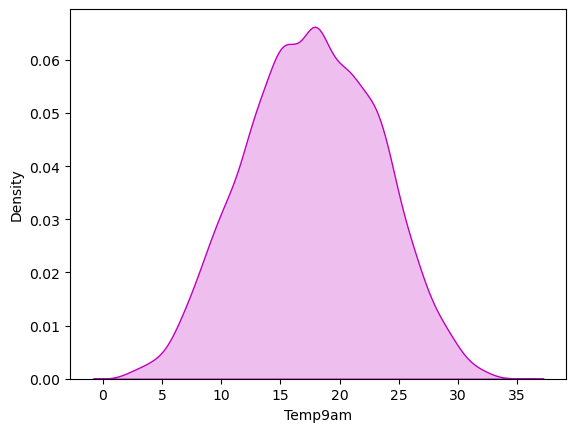

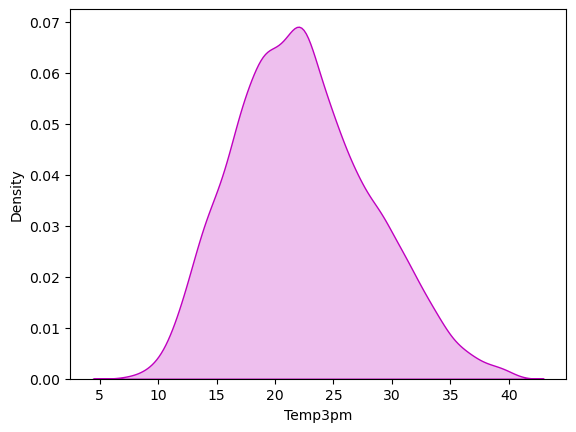

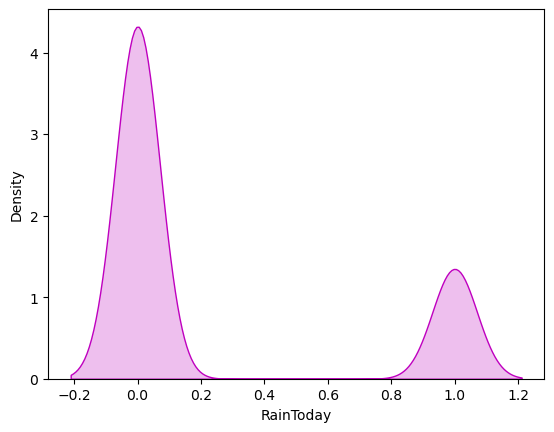

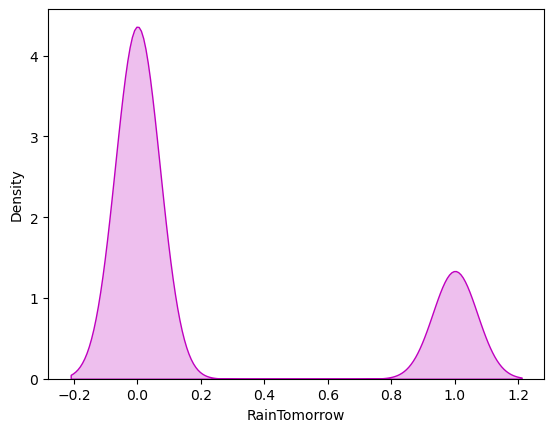

In [573]:
### Visualizing the spreading of data :
for i in df1_rain.columns:
    sns.distplot(df1_rain[i],color="m",kde_kws={"shade":True},hist=False)
    plt.show()

## Correlation Martix:

In [574]:
corr=df1_rain.corr()
corr

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Date,1.000000,0.471470,0.010188,0.010188,0.003159,0.118135,0.060218,-0.090176,-0.030513,-0.028573,...,0.093217,-0.036490,0.039711,0.020935,0.005095,-0.002545,0.064727,0.113134,-0.008024,-0.005368
Location,0.471470,1.000000,0.112020,0.112020,0.003112,0.132553,0.053174,-0.037417,0.243850,-0.038655,...,0.003829,0.058170,-0.021382,-0.009228,0.040491,0.024564,0.113606,0.057378,0.001900,0.005620
MinTemp,0.010188,0.112020,1.000000,1.000000,0.090879,0.370858,0.055313,-0.153312,0.231050,-0.043406,...,-0.117147,0.097472,-0.432528,-0.426595,0.096184,0.043581,0.887828,0.684359,0.072772,0.097085
MaxTemp,0.010188,0.112020,1.000000,1.000000,0.090879,0.370858,0.055313,-0.153312,0.231050,-0.043406,...,-0.117147,0.097472,-0.432528,-0.426595,0.096184,0.043581,0.887828,0.684359,0.072772,0.097085
Rainfall,0.003159,0.003112,0.090879,0.090879,1.000000,-0.039825,-0.167560,0.036598,0.082620,0.090789,...,0.223853,0.234243,-0.054897,-0.013731,0.182583,0.151334,-0.002701,-0.087848,0.456575,0.218067
Evaporation,0.118135,0.132553,0.370858,0.370858,-0.039825,1.000000,0.363056,-0.120358,0.199600,-0.112451,...,-0.319535,-0.229237,-0.260710,-0.274448,-0.112576,-0.144041,0.436838,0.452332,-0.157491,-0.087288
Sunshine,0.060218,0.053174,0.055313,0.055313,-0.167560,0.363056,1.000000,-0.104989,0.002044,-0.079076,...,-0.374313,-0.444715,-0.000862,-0.061617,-0.530969,-0.544899,0.254414,0.399920,-0.234019,-0.324472
WindGustDir,-0.090176,-0.037417,-0.153312,-0.153312,0.036598,-0.120358,-0.104989,1.000000,0.006792,0.404689,...,0.030921,0.049578,-0.096903,-0.010388,0.121865,0.092719,-0.184448,-0.247918,0.120523,0.042947
WindGustSpeed,-0.030513,0.243850,0.231050,0.231050,0.082620,0.199600,0.002044,0.006792,1.000000,-0.066830,...,-0.254248,-0.077156,-0.375381,-0.333378,0.018975,0.068787,0.196482,0.097839,0.082752,0.185836
WindDir9am,-0.028573,-0.038655,-0.043406,-0.043406,0.090789,-0.112451,-0.079076,0.404689,-0.066830,1.000000,...,0.014449,0.119772,-0.004061,0.081765,0.095530,0.063381,-0.102193,-0.224366,0.154400,0.031332


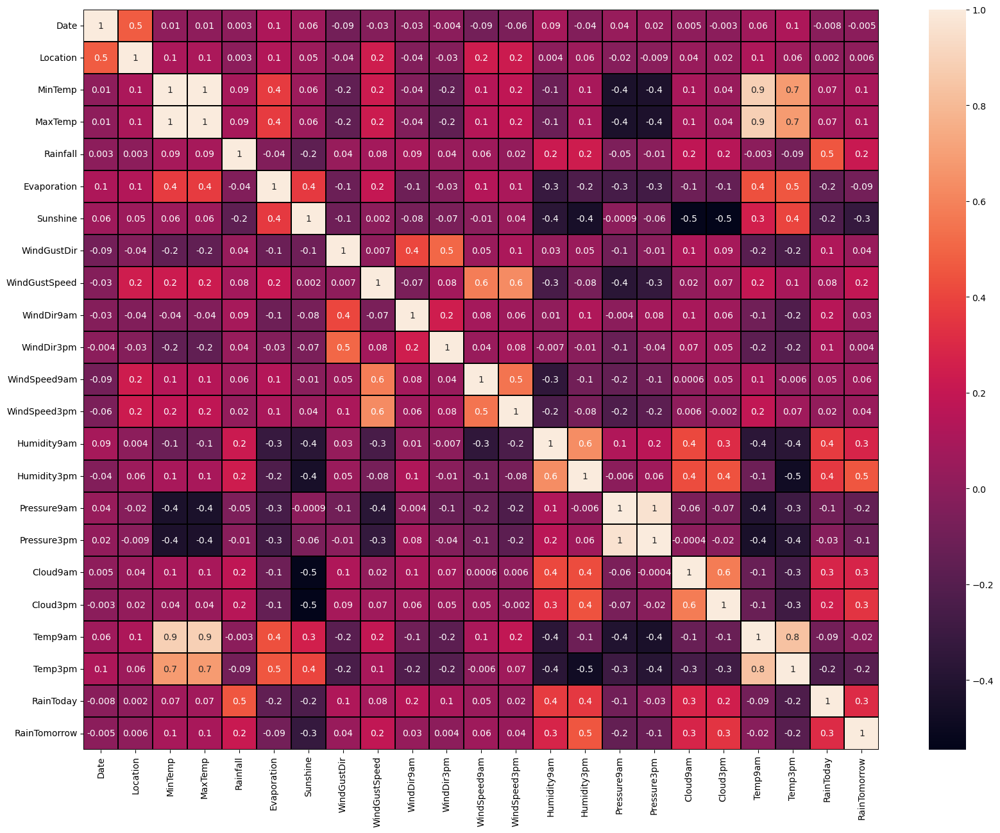

In [575]:
#visualizing the corelation matrix by using the heaatmap
plt.figure(figsize=(20,15))
sns.heatmap(df1_rain.corr(),linewidth=0.1,fmt='0.1g',linecolor="black",annot=True)
plt.yticks(rotation=0);
plt.show()

##### Comments:
we can drop some of the columns to avoid multicolinearity.. but as the number of coluns are more so we can use PCA method to determine the principal components.. so that multicolinearity can also be avoided

##### #visualizing the corelation with target variable1 (RainTomorrow) using barplot:

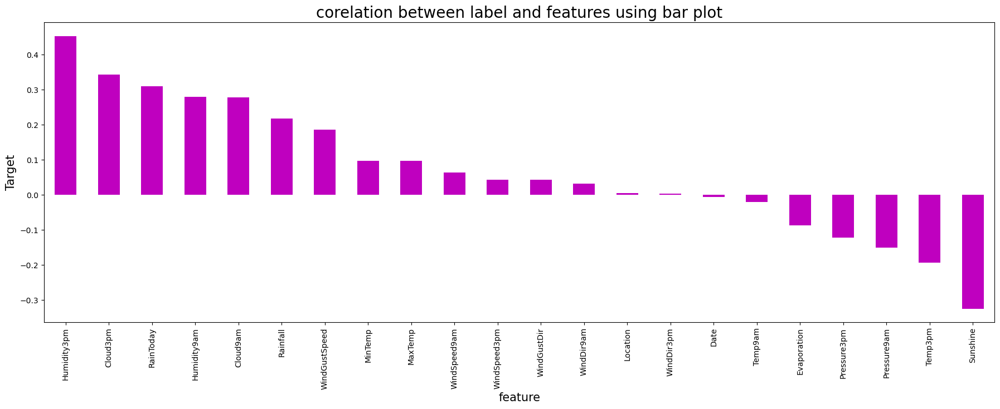

In [576]:
plt.figure(figsize=(22,7))
df1_rain.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


##### visualizing the corelation with target variable1 (RainFall) using barplot:

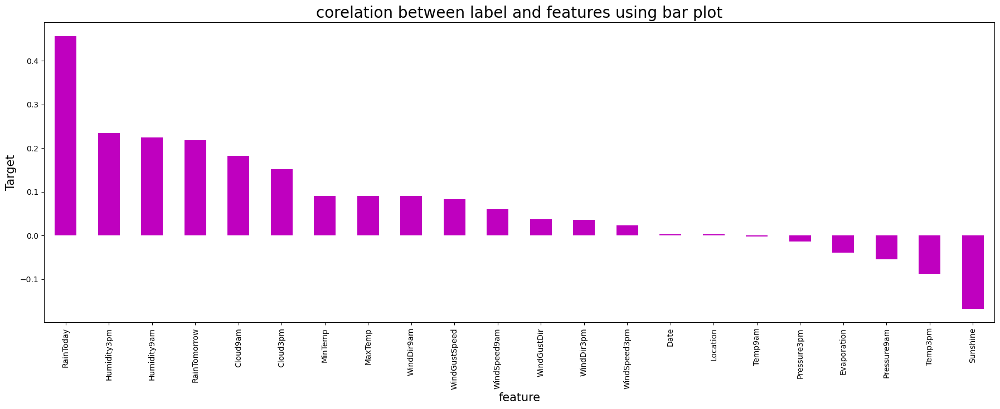

In [577]:
plt.figure(figsize=(22,7))
df1_rain.corr()['Rainfall'].sort_values(ascending=False).drop(['Rainfall']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


## Variance Inflation Factor( Checking for Multicolinearity)

In [578]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif= pd.DataFrame()
vif['VIF']= [variance_inflation_factor(df1_rain.values,i) for i in range(df1_rain.shape[1])]
vif['Features']= df1_rain.columns
vif

,VIF,Features
0,4.904054e+00,Date
1,6.687044e+00,Location
2,inf,MinTemp
3,inf,MaxTemp
4,1.395326e+00,Rainfall
5,9.032545e+00,Evaporation
6,1.627033e+01,Sunshine
7,5.366424e+00,WindGustDir
8,2.302383e+01,WindGustSpeed
9,4.769938e+00,WindDir9am


In [579]:
##The "MinTemp" and "Max Temp" column creating high multicolinearity.. so we can drop those columns
df1_rain.drop(['MinTemp','MaxTemp'],axis=1,inplace=True)

# Model building for RainFall Tomorrow Detection (Classification Model)

In [33]:
#separating target variable and input variable

x=df1_rain.drop('RainTomorrow',axis=1)
y=df1_rain['RainTomorrow']

In [34]:
# feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Date,Location,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,-1.517500,-1.507825,-0.212069,0.109566,-0.000333,1.228620,0.359197,1.243871,1.400572,0.707728,0.637677,0.169919,-1.628086,-1.686076,-1.400080,1.410357,0.002863,-0.139997,-0.095216,-0.558373
1,-1.516322,-1.507825,-0.271042,0.109566,-0.000333,1.441416,0.359197,-0.282945,1.627116,-0.989405,0.421359,-1.463293,-1.462825,-1.201338,-1.281876,-0.000555,0.002863,-0.085945,0.334508,-0.558373
2,-1.515144,-1.507825,-0.271042,0.109566,-0.000333,1.654213,0.515511,1.243871,1.627116,0.601658,0.853995,-1.826229,-1.187390,-1.702791,-1.129899,-0.000555,-1.085016,0.598719,0.145430,-0.558373
3,-1.513965,-1.507825,-0.271042,0.109566,-0.000333,-0.686548,-1.203942,0.371405,-1.771046,-0.246909,-0.984709,-1.402804,-1.958609,-0.031280,-0.437560,-0.000555,0.002863,0.076213,0.712666,-0.558373
4,-1.512787,-1.507825,-0.172754,0.109566,-0.000333,1.228620,0.124726,-1.373528,-0.185237,-0.671192,0.205041,0.835302,-1.022129,-1.167908,-1.585830,0.999417,1.522573,0.022160,1.262713,-0.558373
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8090,2.015868,1.029904,-0.271042,0.109566,-0.000333,-1.537733,-0.656843,0.371405,-1.544502,-0.034767,-0.768391,-1.039868,-1.517912,1.138777,0.828915,-0.000555,0.002863,-1.365185,0.007918,-0.558373
8091,2.017047,1.029904,-0.271042,0.109566,-0.000333,-0.260955,-1.360256,0.371405,-1.091414,-0.034767,-0.984709,-0.737421,-1.683173,0.954911,0.626279,-0.000555,0.002863,-1.221045,0.368886,-0.558373
8092,2.018225,1.029904,-0.271042,0.109566,-0.000333,-0.899344,-0.187902,0.371405,1.400572,-0.459051,-0.984709,-0.918889,-1.517912,0.537033,0.237893,-0.000555,0.002863,-0.932766,0.643910,-0.558373
8093,2.019403,1.029904,-0.271042,0.109566,-0.000333,0.377434,-0.891314,0.589521,-1.091414,-0.034767,-1.201027,-1.039868,-1.517912,0.269592,0.187234,-0.644342,-1.085016,-0.464312,0.626721,-0.558373


In [35]:
y.value_counts()

0.0    6199
1.0    1896
Name: RainTomorrow, dtype: int64

### Balancing the Target Variable

In [36]:
!pip install -U imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable


In [37]:
# to balance the target variable data over sampling is performed:
from imblearn.over_sampling import SMOTE
sm=SMOTE()
x1,y1=sm.fit_resample(x,y)

In [38]:
y1.value_counts()

0.0    6199
1.0    6199
Name: RainTomorrow, dtype: int64

#### Selecting the Principal components :

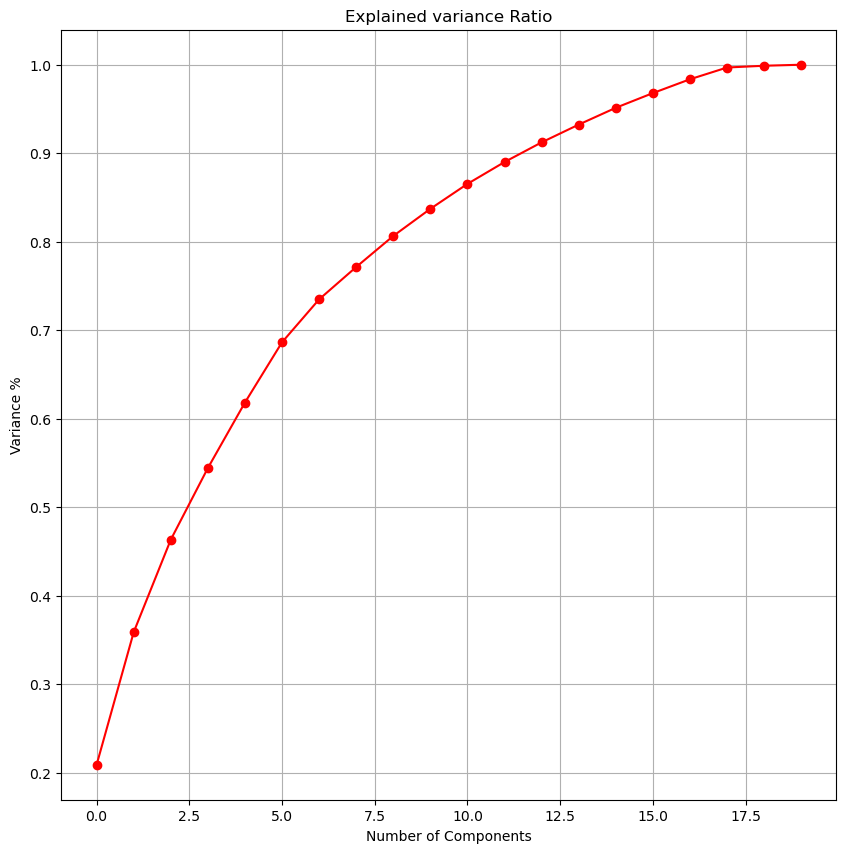

In [39]:
from sklearn.decomposition import PCA
pca = PCA()
#graph to find the principal components
x_pca = pca.fit_transform(x1)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

-> Here we caan see 13 input variable are almost contributing toward 90% of the prediction.. so we can consider those 13 columns as the Principal columns

In [40]:
pca_new = PCA(n_components=13)
x_new = pca_new.fit_transform(x1)

In [41]:
x_new=pd.DataFrame(x_new,columns=np.arange(13))

## Model Building (Classification Model)

In [42]:
#finding the best random state:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.model_selection import cross_val_score


In [43]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
maxAcc=0
maxRs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x_new,y1,test_size=.25,random_state=i)
    LR=LogisticRegression()
    LR.fit(x_train,y_train)
    pred=LR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum acc_score is",maxAcc, "on random_state",maxRs)        

maximum acc_score is 0.7751612903225806 on random_state 185


In [44]:
# creating train test split:
x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=0.25,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(9298, 20)
(9298,)
(3100, 20)
(3100,)


In [45]:
#Logistic regression model:
logR=LogisticRegression()
logR.fit(x_train,y_train)
pred_train=logR.predict(x_train)
pred_Lgr=logR.predict(x_test)
print("predicted accuracy",accuracy_score(y_test,pred_Lgr))
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(confusion_matrix(y_test,pred_Lgr))
print(classification_report(y_test,pred_Lgr))


predicted accuracy 0.792258064516129
accuracy score of original y_test data 0.7757582275758228
[[1237  300]
 [ 344 1219]]
              precision    recall  f1-score   support

         0.0       0.78      0.80      0.79      1537
         1.0       0.80      0.78      0.79      1563

    accuracy                           0.79      3100
   macro avg       0.79      0.79      0.79      3100
weighted avg       0.79      0.79      0.79      3100



In [46]:
#DecissionTreeClassifier:
from sklearn.tree import DecisionTreeClassifier
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
pred_dtc=dtc.predict(x_test)
pred_train=dtc.predict(x_train)
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(accuracy_score(y_test,pred_dtc))
print(confusion_matrix(y_test,pred_dtc))
print(classification_report(y_test,pred_dtc))

accuracy score of original y_test data 1.0
0.8751612903225806
[[1344  193]
 [ 194 1369]]
              precision    recall  f1-score   support

         0.0       0.87      0.87      0.87      1537
         1.0       0.88      0.88      0.88      1563

    accuracy                           0.88      3100
   macro avg       0.88      0.88      0.88      3100
weighted avg       0.88      0.88      0.88      3100



In [47]:
#RandomForestClassifier:
RFC=RandomForestClassifier()
RFC.fit(x_train,y_train)
pred_RFC=RFC.predict(x_test)
print(accuracy_score(y_test,pred_RFC))
print(confusion_matrix(y_test,pred_RFC))
print(classification_report(y_test,pred_RFC))


0.9319354838709677
[[1433  104]
 [ 107 1456]]
              precision    recall  f1-score   support

         0.0       0.93      0.93      0.93      1537
         1.0       0.93      0.93      0.93      1563

    accuracy                           0.93      3100
   macro avg       0.93      0.93      0.93      3100
weighted avg       0.93      0.93      0.93      3100



In [48]:
#KNeighborsClassifier:
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
print(accuracy_score(y_test,pred_knn))
print(confusion_matrix(y_test,pred_knn))
print(classification_report(y_test,pred_knn))


0.8767741935483871
[[1218  319]
 [  63 1500]]
              precision    recall  f1-score   support

         0.0       0.95      0.79      0.86      1537
         1.0       0.82      0.96      0.89      1563

    accuracy                           0.88      3100
   macro avg       0.89      0.88      0.88      3100
weighted avg       0.89      0.88      0.88      3100



In [49]:
#GaussianNB:
gnb = GaussianNB()
gnb.fit(x_train,y_train)
pred_gnb=gnb.predict(x_test)
print(accuracy_score(y_test,pred_gnb))
print(confusion_matrix(y_test,pred_gnb))
print(classification_report(y_test,pred_gnb))


0.7580645161290323
[[1256  281]
 [ 469 1094]]
              precision    recall  f1-score   support

         0.0       0.73      0.82      0.77      1537
         1.0       0.80      0.70      0.74      1563

    accuracy                           0.76      3100
   macro avg       0.76      0.76      0.76      3100
weighted avg       0.76      0.76      0.76      3100



## Cross Validating the Models:

In [50]:
score_LR=cross_val_score(logR,x_new,y1)             # cross validation score for logistic regression
print(score_LR)
print(score_LR.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_Lgr)-(score_LR.mean()))

[0.72217742 0.65201613 0.6358871  0.74747882 0.79870916]
0.7112537248370179
diff b/w accuracy score and cross validation score is: 0.08100433967911114


In [51]:
score_dtc=cross_val_score(dtc,x_new,y1)           #cross validation score of dtc
print(score_dtc)
print(score_dtc.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_dtc)-(score_dtc.mean()))

[0.65604839 0.73024194 0.8516129  0.84550222 0.7446551 ]
0.7656121094614112
diff b/w accuracy score and cross validation score is: 0.10954918086116938


In [52]:
score_RFC=cross_val_score(RFC,x_new,y1)                           #cross validation score of RandomForest
print(score_RFC)
print(score_RFC.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_RFC)-(score_RFC.mean()))

[0.72258065 0.72822581 0.85967742 0.90237999 0.86688181]
0.8159491340160574
diff b/w accuracy score and cross validation score is: 0.1159863498549103


In [53]:
score_knn=cross_val_score(knn,x_new,y1)                           #cross validation score of knn
print(score_knn)
print(score_knn.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_knn)-(score_knn.mean()))

[0.69596774 0.63185484 0.76169355 0.79870916 0.75272287]
0.7281896316152455
diff b/w accuracy score and cross validation score is: 0.14858456193314162


In [54]:
score_gnb=cross_val_score(gnb,x_new,y1)                           #cross validation score of GaussianNB
print(score_gnb)
print(score_gnb.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_gnb)-(score_gnb.mean()))

[0.66451613 0.64274194 0.62016129 0.70794675 0.76603469]
0.6802801597938816
diff b/w accuracy score and cross validation score is: 0.07778435633515068


###### By varifying the accuracy score and the cross validation score we can conclude that the Random Forest Classifier is predicting goog for the given problem statement

# Hyperparameter Tuning of Random Forest Classifier

In [55]:
from sklearn.model_selection import GridSearchCV

In [56]:
parameter = {  'bootstrap': [True], 'max_depth': [5, 10,20,40,50, None], 
              'max_features': ['auto', 'log2'], 
              'criterion':['gini','entropy'],
              'n_estimators': [5, 10, 15 ,25,50,100]}

In [68]:
GCV = GridSearchCV(RandomForestClassifier(),parameter,cv=5,n_jobs = -1,verbose=3)
GCV.fit(x_train,y_train)

Fitting 5 folds for each of 144 candidates, totalling 720 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'bootstrap': [True], 'criterion': ['gini', 'entropy'],
                         'max_depth': [5, 10, 20, 40, 50, None],
                         'max_features': ['auto', 'log2'],
                         'n_estimators': [5, 10, 15, 25, 50, 100]},
             verbose=3)

In [69]:
GCV.best_params_

{'bootstrap': True,
 'criterion': 'entropy',
 'max_depth': None,
 'max_features': 'auto',
 'n_estimators': 100}

In [57]:
model_RainT=RandomForestClassifier(bootstrap=True,criterion='entropy', max_depth= None, max_features='auto',n_estimators= 100)

# Final Model

In [58]:
model_RainT.fit(x_train,y_train)
pred=model_RainT.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

93.12903225806451


### The Final model Providing 93.064% accuracy

In [59]:
import joblib
joblib.dump(model_RainT,'Tomorrow RainFall Prediction analysis')


['Tomorrow RainFall Prediction analysis']

In [60]:
RFC_RainT=joblib.load('Tomorrow RainFall Prediction analysis')
predictionM=RFC_RainT.predict(x_test)
predictionM

array([1., 1., 0., ..., 1., 1., 0.])

In [61]:
a=np.array(y_test)
DF_RainT=pd.DataFrame()
DF_RainT['predicted']=predictionM
DF_RainT['original']=a
DF_RainT

,predicted,original
0,1.0,1.0
1,1.0,1.0
2,0.0,0.0
3,1.0,1.0
4,0.0,0.0
...,...,...
3095,1.0,1.0
3096,0.0,0.0
3097,1.0,1.0
3098,1.0,1.0


## Model Building for Amount Of RainFall (Regression Model):

In [580]:
df2_rain=df1_rain.copy()
df2_rain

,Date,Location,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,0.0,1.0,0.6,5.389395,7.632205,13.0,44.000000,13.0,14.0,20.0,...,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0.0,0.0
1,1.0,1.0,0.0,5.389395,7.632205,14.0,44.000000,6.0,15.0,4.0,...,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0.0,0.0
2,2.0,1.0,0.0,5.389395,7.632205,15.0,46.000000,13.0,15.0,19.0,...,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0.0,0.0
3,3.0,1.0,0.0,5.389395,7.632205,4.0,24.000000,9.0,0.0,11.0,...,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0.0,0.0
4,4.0,1.0,1.0,5.389395,7.632205,13.0,41.000000,1.0,7.0,7.0,...,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2999.0,9.0,0.0,5.389395,7.632205,0.0,31.000000,9.0,1.0,13.0,...,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0.0,0.0
8421,3000.0,9.0,0.0,5.389395,7.632205,6.0,22.000000,9.0,3.0,13.0,...,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0.0,0.0
8422,3001.0,9.0,0.0,5.389395,7.632205,3.0,37.000000,9.0,14.0,9.0,...,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0.0,0.0
8423,3002.0,9.0,0.0,5.389395,7.632205,9.0,28.000000,10.0,3.0,13.0,...,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0.0,0.0


In [581]:
#separating target variable and input variable

x2=df2_rain.drop('Rainfall',axis=1)
y2=df2_rain['Rainfall']

In [582]:
# feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x2=pd.DataFrame(scaler.fit_transform(x2),columns=x2.columns)
x2

,Date,Location,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,-1.517500,-1.507825,0.109566,-0.000333,1.228620,0.359197,1.243871,1.400572,0.707728,0.637677,0.169919,-1.628086,-1.686076,-1.400080,1.410357,0.002863,-0.139997,-0.095216,-0.558373,-0.553042
1,-1.516322,-1.507825,0.109566,-0.000333,1.441416,0.359197,-0.282945,1.627116,-0.989405,0.421359,-1.463293,-1.462825,-1.201338,-1.281876,-0.000555,0.002863,-0.085945,0.334508,-0.558373,-0.553042
2,-1.515144,-1.507825,0.109566,-0.000333,1.654213,0.515511,1.243871,1.627116,0.601658,0.853995,-1.826229,-1.187390,-1.702791,-1.129899,-0.000555,-1.085016,0.598719,0.145430,-0.558373,-0.553042
3,-1.513965,-1.507825,0.109566,-0.000333,-0.686548,-1.203942,0.371405,-1.771046,-0.246909,-0.984709,-1.402804,-1.958609,-0.031280,-0.437560,-0.000555,0.002863,0.076213,0.712666,-0.558373,-0.553042
4,-1.512787,-1.507825,0.109566,-0.000333,1.228620,0.124726,-1.373528,-0.185237,-0.671192,0.205041,0.835302,-1.022129,-1.167908,-1.585830,0.999417,1.522573,0.022160,1.262713,-0.558373,-0.553042
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8090,2.015868,1.029904,0.109566,-0.000333,-1.537733,-0.656843,0.371405,-1.544502,-0.034767,-0.768391,-1.039868,-1.517912,1.138777,0.828915,-0.000555,0.002863,-1.365185,0.007918,-0.558373,-0.553042
8091,2.017047,1.029904,0.109566,-0.000333,-0.260955,-1.360256,0.371405,-1.091414,-0.034767,-0.984709,-0.737421,-1.683173,0.954911,0.626279,-0.000555,0.002863,-1.221045,0.368886,-0.558373,-0.553042
8092,2.018225,1.029904,0.109566,-0.000333,-0.899344,-0.187902,0.371405,1.400572,-0.459051,-0.984709,-0.918889,-1.517912,0.537033,0.237893,-0.000555,0.002863,-0.932766,0.643910,-0.558373,-0.553042
8093,2.019403,1.029904,0.109566,-0.000333,0.377434,-0.891314,0.589521,-1.091414,-0.034767,-1.201027,-1.039868,-1.517912,0.269592,0.187234,-0.644342,-1.085016,-0.464312,0.626721,-0.558373,-0.553042


In [583]:
y2.value_counts()

0.000000      5071
0.200000       390
2.805913       232
0.400000       176
0.600000       115
              ... 
23.800000        1
61.200000        1
128.000000       1
90.000000        1
40.000000        1
Name: Rainfall, Length: 243, dtype: int64

#### Selecting the Principal components :

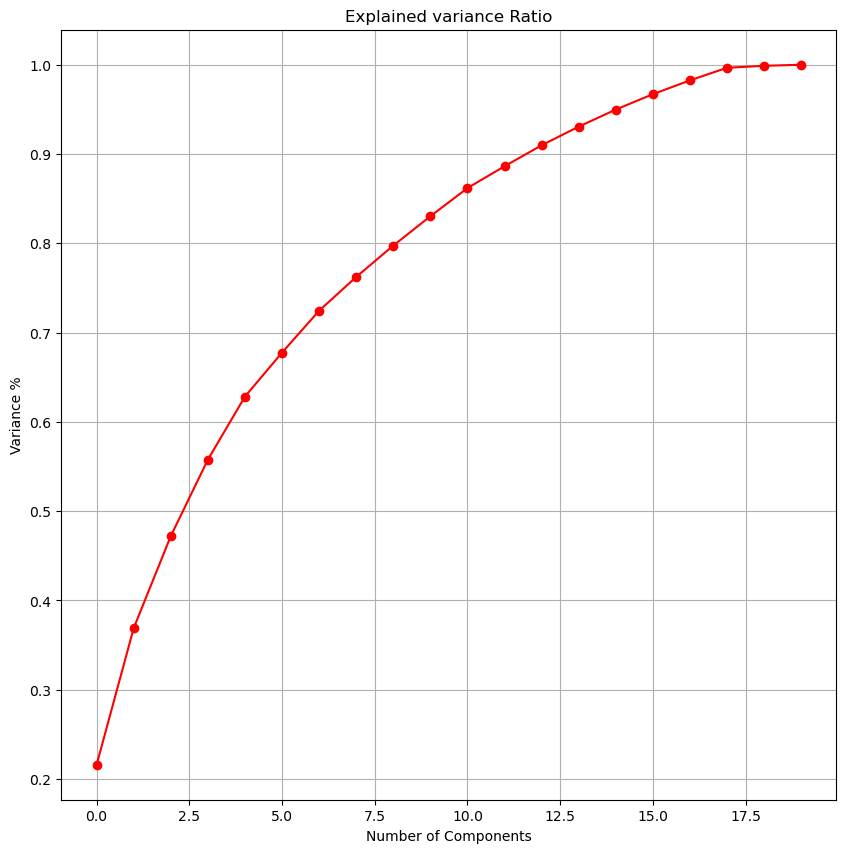

In [584]:
from sklearn.decomposition import PCA
pca = PCA()
#graph to find the principal components
x_pca = pca.fit_transform(x2)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

In [586]:
pca_new = PCA(n_components=13)
x2_new = pca_new.fit_transform(x2)

In [587]:
x2_new=pd.DataFrame(x2_new,columns=np.arange(13))

## Model Building:

In [588]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.linear_model import Lasso,Ridge


In [589]:
# finding the best random state
maxAcc=0
maxRs=0
for i in range(1,1000):
    x_train,x_test,y_train,y_test=train_test_split(x2,y2,test_size=.25,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum r2_score is",maxAcc, "on random_state",maxRs)        

maximum r2_score is 0.4000408473851724 on random_state 308


In [590]:
x_train,x_test,y_train,y_test=train_test_split(x2,y2,test_size=.25,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(6071, 20)
(6071,)
(2024, 20)
(2024,)


In [591]:
LR=LinearRegression()
LR.fit(x_train,y_train)
pred_lr=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_lr))
print('r2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_lr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_lr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_lr)))

r2_score: 0.4000408473851724
r2_score on training Data: 20.961822974934073
mean absolute error: 2.8198900553038007
Mean Squared Error:- 28.001797744344227
Root Mean Squrared Error:- 5.29167249027604


In [592]:
# Random Forest model:
RFR=RandomForestRegressor()
RFR.fit(x_train,y_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_RFR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_RFR))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_RFR))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_RFR)))

r2_score: 0.3462086351449908
R2_score on training Data: 90.4394798741028
mean absolute error: 1.8052835107603087
Mean Squared Error:- 30.514299991722925
Root Mean Squrared Error:- 5.523975017297139


In [593]:
# KNN
knn=KNN()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print('r2_score:',r2_score(y_test,pred_knn))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_knn))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_knn))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_knn)))

r2_score: 0.14768816294349885
R2_score on training Data: 46.19321450100784
mean absolute error: 2.1588300829870524
Mean Squared Error:- 39.77981429627211
Root Mean Squrared Error:- 6.307124090762136


In [594]:
# GBR
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_GBR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_GBR))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_GBR))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_GBR)))

r2_score: 0.3125408954394171
R2_score on training Data: 71.75904734625254
mean absolute error: 2.089947401882101
Mean Squared Error:- 32.085669031824814
Root Mean Squrared Error:- 5.66442133247738


In [595]:
#Lasso
lasso=Lasso()
lasso.fit(x_train,y_train)
pred_lasso=lasso.predict(x_test)
pred_train=lasso.predict(x_train)
print('r2_score:',r2_score(y_test,pred_lasso))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_lasso))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_lasso))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_lasso)))

r2_score: 0.3798274027616082
R2_score on training Data: 18.175756340677708
mean absolute error: 2.35741723712714
Mean Squared Error:- 28.94521661811033
Root Mean Squrared Error:- 5.380075893341127


In [596]:
#Ridge:
ridge=Ridge()
ridge.fit(x_train,y_train)
pred_ridge=ridge.predict(x_test)
pred_train=ridge.predict(x_train)
print('r2_score:',r2_score(y_test,pred_ridge))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_ridge))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_ridge))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_ridge)))

r2_score: 0.40007612240165913
R2_score on training Data: 20.961820354597403
mean absolute error: 2.819542249737549
Mean Squared Error:- 28.000151359131525
Root Mean Squrared Error:- 5.2915169242034485


In [597]:
#Decision Tree:
dtr=DecisionTreeRegressor()
dtr.fit(x_train,y_train)
pred_dtr=dtr.predict(x_test)
pred_train=dtr.predict(x_train)
print('r2_score:',r2_score(y_test,pred_dtr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_dtr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_dtr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_dtr)))

r2_score: -1.0558610291403907
R2_score on training Data: 100.0
mean absolute error: 1.9182636221179692
Mean Squared Error:- 95.95287358742402
Root Mean Squrared Error:- 9.7955537662464


In [598]:
#svr
from sklearn.svm import SVR
svr=SVR()
svr.fit(x_train,y_train)
pred_svr=svr.predict(x_test)
pred_train=svr.predict(x_train)
print('r2_score:',r2_score(y_test,pred_svr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_svr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_svr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_svr)))

r2_score: 0.32190611286576787
R2_score on training Data: 15.792392558652136
mean absolute error: 1.7723233346228344
Mean Squared Error:- 31.64856773407556
Root Mean Squrared Error:- 5.625705976504243


In [599]:
! pip install xgboost

Defaulting to user installation because normal site-packages is not writeable


In [600]:
from xgboost import XGBRegressor
xgbr=model = XGBRegressor()
xgbr.fit(x_train,y_train)
pred_xgbr=xgbr.predict(x_test)
pred_train=xgbr.predict(x_train)
print('r2_score:',r2_score(y_test,pred_xgbr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_xgbr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_xgbr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_xgbr)))

r2_score: 0.049925596163439834
R2_score on training Data: 99.21881578582608
mean absolute error: 1.994521575477224
Mean Squared Error:- 44.342670967450594
Root Mean Squrared Error:- 6.659029281167833


## Cross Validating the models:

In [601]:
# cross validation of the model:
from sklearn.model_selection import cross_val_score

In [602]:
scoreLR=cross_val_score(LR,x2_new,y2,cv=5,scoring='r2')             #CROSS VALIDATION FOR LINEAR REGRESSOR
print(scoreLR)
print(scoreLR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_lr)-scoreLR.mean())*100)

[0.1751311  0.18818321 0.26338459 0.24792429 0.34448988]
0.2438226140026118
difference between r2 score and cross validation score is: 15.621823338256064


In [603]:
scoreRFR=cross_val_score(RFR,x2_new,y2,cv=5,scoring='r2')        #CROSS VALIDATION FOR RANDOM FOREST
print(scoreRFR)
print(scoreRFR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_RFR)-scoreRFR.mean())*100)

[0.17365662 0.45062193 0.71206459 0.31243742 0.46353779]
0.4224636696264986
difference between r2 score and cross validation score is: -7.625503448150783


In [604]:
scoreknn=cross_val_score(knn,x2_new,y2,cv=5,scoring='r2')            # CROSS VALIDATION FOR KNN
print(scoreknn)
print(scoreknn.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_knn)-scoreknn.mean())*100)

[0.12858254 0.24867725 0.35127612 0.06114538 0.07098628]
0.17213351277331748
difference between r2 score and cross validation score is: -2.4445349829818634


In [118]:
scoreGBR=cross_val_score(GBR,x2_new,y2,cv=5,scoring='r2')             #cross validation for gbr
print(scoreGBR)
print(scoreGBR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_GBR)-scoreGBR.mean())*100)

[0.1085708  0.39961012 0.53696168 0.13571462 0.49117737]
0.3344069204569574
difference between r2 score and cross validation score is: 5.531032004982528


In [119]:
scoreL=cross_val_score(lasso,x2_new,y2,cv=5,scoring='r2')            #cross validation for lasso
print(scoreL) 
print(scoreL.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_lasso)-scoreL.mean())*100)

[0.11374487 0.13338314 0.17613602 0.18939404 0.2981711 ]
0.182165832264842
difference between r2 score and cross validation score is: 12.124542835700009


In [120]:
scoreR=cross_val_score(ridge,x2_new,y2,cv=5,scoring='r2')          #cross validation for ridge
print(scoreR)
print(scoreR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_ridge)-scoreR.mean())*100)

[0.17512539 0.1881831  0.26338397 0.24793577 0.3445018 ]
0.24382600669062376
difference between r2 score and cross validation score is: 16.734481084601665


In [121]:
scoreSVR=cross_val_score(svr,x2_new,y2,cv=5,scoring='r2')             #cross validation for svr
print(scoreSVR)
print(scoreSVR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_svr)-scoreSVR.mean())*100)

[0.11235655 0.14657386 0.18220752 0.19722706 0.27006621]
0.18168623843317994
difference between r2 score and cross validation score is: 12.787156083339696


In [122]:
scoreDTR=cross_val_score(dtr,x2_new,y2,cv=5,scoring='r2')             #cross validation for dtr
print(scoreDTR)
print(scoreDTR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_dtr)-scoreDTR.mean())*100)

[-0.24571553  0.34101087 -0.09927579 -1.65160049 -0.63846701]
-0.4588095889277547
difference between r2 score and cross validation score is: 27.502439391240628


In [123]:
scoreXGBR=cross_val_score(xgbr,x2_new,y2,cv=5,scoring='r2')             #cross validation for xgbr
print(scoreXGBR)
print(scoreXGBR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_xgbr)-scoreXGBR.mean())*100)

[ 0.13004172  0.46221412  0.38937968 -0.01385531 -0.1019902 ]
0.17315800244060991
difference between r2 score and cross validation score is: 23.90407288851733


##### By varifying the r2 score and cross validation score we can conclude that Random Forest Regressor performs better for this problem statement

##  Hyperparameter Tuning Random forest Regressor:

In [125]:
from sklearn.model_selection import GridSearchCV
parameter = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4],
    'min_samples_split': [8, 10],
    'n_estimators': [100, 200, 300]
    }

GCV=GridSearchCV(RandomForestRegressor(),parameter,cv=4)
GCV.fit(x_train,y_train)


GridSearchCV(cv=4, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True], 'max_depth': [80, 90, 100],
                         'max_features': [2, 3], 'min_samples_leaf': [3, 4],
                         'min_samples_split': [8, 10],
                         'n_estimators': [100, 200, 300]})

In [126]:
GCV.best_params_

{'bootstrap': True,
 'max_depth': 90,
 'max_features': 2,
 'min_samples_leaf': 3,
 'min_samples_split': 8,
 'n_estimators': 100}

In [127]:
model_rain2=RandomForestRegressor(bootstrap=True,max_depth=90,max_features=2,min_samples_leaf=3,min_samples_split= 8,n_estimators=100)

## Final Model2

In [128]:
model_rain2.fit(x_train,y_train)
pred=model_rain2.predict(x_test)
acc=r2_score(y_test,pred)
print(acc*100)

48.14476557574573


##### In the final model we are getting 48.11% accuracy

#### Saving the model:

In [130]:
import joblib
joblib.dump(model_rain2,"RainFall Amount Prediction Analyis")


['RainFall Amount Prediction Analyis']

In [131]:
RFR_Rain=joblib.load("RainFall Amount Prediction Analyis")
predictionM=RFR_Rain.predict(x_test)
predictionM

array([0.39455633, 0.12836331, 1.39046145, ..., 0.66974248, 0.2942606 ,
       7.32443414])

# Project.3: Insurance Claim Fraud Detection

## Project Description:
Insurance fraud is a huge problem in the industry. It's difficult to identify fraud claims. Machine Learning is in a unique position to help the Auto Insurance industry with this problem.
In this project, you are provided a dataset which has the details of the insurance policy along with the customer details. It also has the details of the accident on the basis of which the claims have been made. 
In this example, you will be working with some auto insurance data to demonstrate how you can create a predictive model that predicts if an insurance claim is fraudulent or not. 




Independent Variables

1.	months_as_customer: Number of months of patronage
2.	age: the length of time a customer has lived or a thing has existed
3.	policy_number: It is a unique id given to the customer, to track the subscription status and other details of customer
4.	policy_bind_date:date which document that is given to customer after we accept your proposal for insurance
5.	policy_state: This identifies who is the insured, what risks or property are covered, the policy limits, and the policy period
6.	policy_csl: is basically Combined Single Limit
7.	policy_deductable: the amount of money that a customer is responsible for paying toward an insured loss
8.	policy_annual_premium: This means the amount of Regular Premium payable by the Policyholder in a Policy Year
9.	umbrella_limit: This means extra insurance that provides protection beyond existing limits and coverages of other policies
10.	insured_zip: It is the zip code where the insurance was made
11.	insured_sex: This refres to either of the two main categories (male and female) into which customer are divided on the basis of their reproductive functions
12.	insured_education_level: This refers to the Level of education of the customer
13.	insured_occupation: This refers Occupation of the customer
14.	insured_hobbies: This refers to an activity done regularly by customer in his/her leisure time for pleasure.
15.	insured_relationship: This whether customer is: single; or. married; or. in a de facto relationship (that is, living together but not married); or. in a civil partnership
16.	capital-gains: This refers to profit accrued due to insurance premium
17.	capital-loss: This refers to the losses incurred due to insurance claims
18.	incident_date: This refers to the date which claims where made by customers
19.	incident_type: This refers to the type of claim/vehicle damage made by customer
20.	collision_type: This refers to the area of damage on the vehicle
21.	incident_severity: This refers to the extent/level of damage
22.	authorities_contacted: This refers to the government agencies that were contacted after damage
23.	incident_state: This refers to the state at which the accident happened
24.	incident_city: This refers to the city at which the accident happened
25.	1ncident_location: This refers to the location at which the accident happened
26.	incident_hour_of_the_day: The period of the day which accident took place
27.	number_of_vehicles_involved: This refers to number of vehicles involved the accident
28.	property_damage: This refers to whether property was damaged or not
29.	bodily_injuries: This refers to injuries sustained
30.	witnesses: This refers to the number of witnesses involved
31.	police_report_available: This refers to whether the report on damage was documented or not
32.	total_claim_amount: This refers to the financial implications involved in claims
33.	injury_claim: This refers to physical injuries sustained
34.	property_claim: This refers to property damages during incident
35.	vehicle_claim: This refers to property damages during incident
36.	auto_make: This refers to the make of the vehicle
37.	auto_model: This refers to the model of the vehicle
38.	auto_year: This refers to the year which the vehicle was manufactured
39.	_c39:
40.	fraud_reported

Dataset Link-  
•	https://github.com/dsrscientist/Data-Science-ML-Capstone-Projects/blob/master/Automobile_insurance_fraud.csv


In [247]:
df_in=pd.read_csv('Automobile_insurance_fraud.csv')
df_in

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,_c39
0,328,48,521585,17-10-2014,OH,250/500,1000,1406.91,0,466132,...,YES,71610,6510,13020,52080,Saab,92x,2004,Y,NaN
1,228,42,342868,27-06-2006,IN,250/500,2000,1197.22,5000000,468176,...,?,5070,780,780,3510,Mercedes,E400,2007,Y,NaN
2,134,29,687698,06-09-2000,OH,100/300,2000,1413.14,5000000,430632,...,NO,34650,7700,3850,23100,Dodge,RAM,2007,N,NaN
3,256,41,227811,25-05-1990,IL,250/500,2000,1415.74,6000000,608117,...,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y,NaN
4,228,44,367455,06-06-2014,IL,500/1000,1000,1583.91,6000000,610706,...,NO,6500,1300,650,4550,Accura,RSX,2009,N,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,38,941851,16-07-1991,OH,500/1000,1000,1310.80,0,431289,...,?,87200,17440,8720,61040,Honda,Accord,2006,N,NaN
996,285,41,186934,05-01-2014,IL,100/300,1000,1436.79,0,608177,...,?,108480,18080,18080,72320,Volkswagen,Passat,2015,N,NaN
997,130,34,918516,17-02-2003,OH,250/500,500,1383.49,3000000,442797,...,YES,67500,7500,7500,52500,Suburu,Impreza,1996,N,NaN
998,458,62,533940,18-11-2011,IL,500/1000,2000,1356.92,5000000,441714,...,YES,46980,5220,5220,36540,Audi,A5,1998,N,NaN


# EDA

In [248]:
df_in.head()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,_c39
0,328,48,521585,17-10-2014,OH,250/500,1000,1406.91,0,466132,...,YES,71610,6510,13020,52080,Saab,92x,2004,Y,NaN
1,228,42,342868,27-06-2006,IN,250/500,2000,1197.22,5000000,468176,...,?,5070,780,780,3510,Mercedes,E400,2007,Y,NaN
2,134,29,687698,06-09-2000,OH,100/300,2000,1413.14,5000000,430632,...,NO,34650,7700,3850,23100,Dodge,RAM,2007,N,NaN
3,256,41,227811,25-05-1990,IL,250/500,2000,1415.74,6000000,608117,...,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y,NaN
4,228,44,367455,06-06-2014,IL,500/1000,1000,1583.91,6000000,610706,...,NO,6500,1300,650,4550,Accura,RSX,2009,N,NaN


In [249]:
df_in.tail()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,_c39
995,3,38,941851,16-07-1991,OH,500/1000,1000,1310.80,0,431289,...,?,87200,17440,8720,61040,Honda,Accord,2006,N,NaN
996,285,41,186934,05-01-2014,IL,100/300,1000,1436.79,0,608177,...,?,108480,18080,18080,72320,Volkswagen,Passat,2015,N,NaN
997,130,34,918516,17-02-2003,OH,250/500,500,1383.49,3000000,442797,...,YES,67500,7500,7500,52500,Suburu,Impreza,1996,N,NaN
998,458,62,533940,18-11-2011,IL,500/1000,2000,1356.92,5000000,441714,...,YES,46980,5220,5220,36540,Audi,A5,1998,N,NaN
999,456,60,556080,11-11-1996,OH,250/500,1000,766.19,0,612260,...,?,5060,460,920,3680,Mercedes,E400,2007,N,NaN


In [250]:
df_in.shape

(1000, 40)

In [251]:
df_in.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 40 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   months_as_customer           1000 non-null   int64  
 1   age                          1000 non-null   int64  
 2   policy_number                1000 non-null   int64  
 3   policy_bind_date             1000 non-null   object 
 4   policy_state                 1000 non-null   object 
 5   policy_csl                   1000 non-null   object 
 6   policy_deductable            1000 non-null   int64  
 7   policy_annual_premium        1000 non-null   float64
 8   umbrella_limit               1000 non-null   int64  
 9   insured_zip                  1000 non-null   int64  
 10  insured_sex                  1000 non-null   object 
 11  insured_education_level      1000 non-null   object 
 12  insured_occupation           1000 non-null   object 
 13  insured_hobbies    

## comments:
1. The dataset contains 1000 rows and 40 columns.. 
2. the data types of columns are object float and int type
3. here "Fraud reported" is the target variable and remaining 39 columns are the input variables
3. here the target variable is categorised into 2 parts.. so we can consider it as a binary classification problem

###### By observing the dataset we can see some of the columns contains "?".. so lets check the columns containing "?"

In [252]:
df_in.isin(['?']).sum().any()

True

###### Replacing "?" with Nan

In [253]:
df_in=df_in.replace('?',np.NaN)

###### Checking for Null Values

In [254]:
df_in.isnull().sum()

months_as_customer                0
age                               0
policy_number                     0
policy_bind_date                  0
policy_state                      0
policy_csl                        0
policy_deductable                 0
policy_annual_premium             0
umbrella_limit                    0
insured_zip                       0
insured_sex                       0
insured_education_level           0
insured_occupation                0
insured_hobbies                   0
insured_relationship              0
capital-gains                     0
capital-loss                      0
incident_date                     0
incident_type                     0
collision_type                  178
incident_severity                 0
authorities_contacted             0
incident_state                    0
incident_city                     0
incident_location                 0
incident_hour_of_the_day          0
number_of_vehicles_involved       0
property_damage             

#### comments:
-> here we can see the "_c39" column consist of total null values only.. so we can drop the column completely
->apart from the _c39 column , "collision_type","property_damage", "police_report_available" columns contains some missing values which are of categorical data type.. so we can replace them by mode of their value.

<AxesSubplot:>

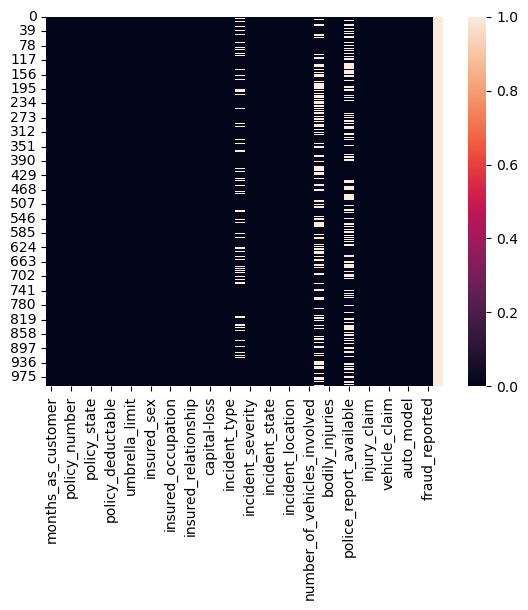

In [255]:
#### Visualizing null values through heatmap:
sns.heatmap(df_in.isnull())

##### Droping the _c9 column

In [256]:
df_in.drop('_c39',axis=1,inplace=True)

In [257]:
df_in['property_damage'].fillna(df_in['property_damage'].mode()[0],inplace=True)
df_in['police_report_available'].fillna(df_in['police_report_available'].mode()[0],inplace=True)
df_in['collision_type'].fillna(df_in['collision_type'].mode()[0],inplace=True)

<AxesSubplot:>

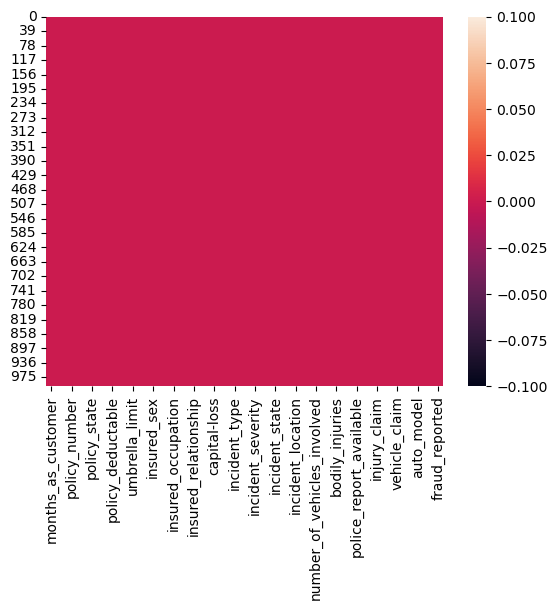

In [258]:
# Visualizing through heatmap after droping the column
sns.heatmap(df_in.isnull())

#### Comments:
-> now we can see there is no null values present in the dataset.. so we can proceed further

In [259]:
df_in.nunique()

months_as_customer              391
age                              46
policy_number                  1000
policy_bind_date                951
policy_state                      3
policy_csl                        3
policy_deductable                 3
policy_annual_premium           991
umbrella_limit                   11
insured_zip                     995
insured_sex                       2
insured_education_level           7
insured_occupation               14
insured_hobbies                  20
insured_relationship              6
capital-gains                   338
capital-loss                    354
incident_date                    60
incident_type                     4
collision_type                    3
incident_severity                 4
authorities_contacted             5
incident_state                    7
incident_city                     7
incident_location              1000
incident_hour_of_the_day         24
number_of_vehicles_involved       4
property_damage             

##### Separating Numerical and Categorical columns

In [260]:
categoric_col=[]
for i in df_in.dtypes.index:
    if df_in.dtypes[i]=="object":
        categoric_col.append(i)
print("categorical columns:",categoric_col)    

categorical columns: ['policy_bind_date', 'policy_state', 'policy_csl', 'insured_sex', 'insured_education_level', 'insured_occupation', 'insured_hobbies', 'insured_relationship', 'incident_date', 'incident_type', 'collision_type', 'incident_severity', 'authorities_contacted', 'incident_state', 'incident_city', 'incident_location', 'property_damage', 'police_report_available', 'auto_make', 'auto_model', 'fraud_reported']


In [261]:
#for numerical column:
numerical_col=[]
for i in df_in.dtypes.index:
    if df_in.dtypes[i]!="object":
        numerical_col.append(i)
print("numerical column:",numerical_col)        

numerical column: ['months_as_customer', 'age', 'policy_number', 'policy_deductable', 'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'capital-gains', 'capital-loss', 'incident_hour_of_the_day', 'number_of_vehicles_involved', 'bodily_injuries', 'witnesses', 'total_claim_amount', 'injury_claim', 'property_claim', 'vehicle_claim', 'auto_year']


## Statistical Summery:

In [262]:
df_in.describe()

,months_as_customer,age,policy_number,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,capital-gains,capital-loss,incident_hour_of_the_day,number_of_vehicles_involved,bodily_injuries,witnesses,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_year
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.000000,1000.000000
mean,203.954000,38.948000,546238.648000,1136.000000,1256.406150,1.101000e+06,501214.488000,25126.100000,-26793.700000,11.644000,1.83900,0.992000,1.487000,52761.94000,7433.420000,7399.570000,37928.950000,2005.103000
std,115.113174,9.140287,257063.005276,611.864673,244.167395,2.297407e+06,71701.610941,27872.187708,28104.096686,6.951373,1.01888,0.820127,1.111335,26401.53319,4880.951853,4824.726179,18886.252893,6.015861
min,0.000000,19.000000,100804.000000,500.000000,433.330000,-1.000000e+06,430104.000000,0.000000,-111100.000000,0.000000,1.00000,0.000000,0.000000,100.00000,0.000000,0.000000,70.000000,1995.000000
25%,115.750000,32.000000,335980.250000,500.000000,1089.607500,0.000000e+00,448404.500000,0.000000,-51500.000000,6.000000,1.00000,0.000000,1.000000,41812.50000,4295.000000,4445.000000,30292.500000,2000.000000
50%,199.500000,38.000000,533135.000000,1000.000000,1257.200000,0.000000e+00,466445.500000,0.000000,-23250.000000,12.000000,1.00000,1.000000,1.000000,58055.00000,6775.000000,6750.000000,42100.000000,2005.000000
75%,276.250000,44.000000,759099.750000,2000.000000,1415.695000,0.000000e+00,603251.000000,51025.000000,0.000000,17.000000,3.00000,2.000000,2.000000,70592.50000,11305.000000,10885.000000,50822.500000,2010.000000
max,479.000000,64.000000,999435.000000,2000.000000,2047.590000,1.000000e+07,620962.000000,100500.000000,0.000000,23.000000,4.00000,2.000000,3.000000,114920.00000,21450.000000,23670.000000,79560.000000,2015.000000


## DATA VISUALIZATION:

### Univariate Analysis:


N    753
Y    247
Name: fraud_reported, dtype: int64


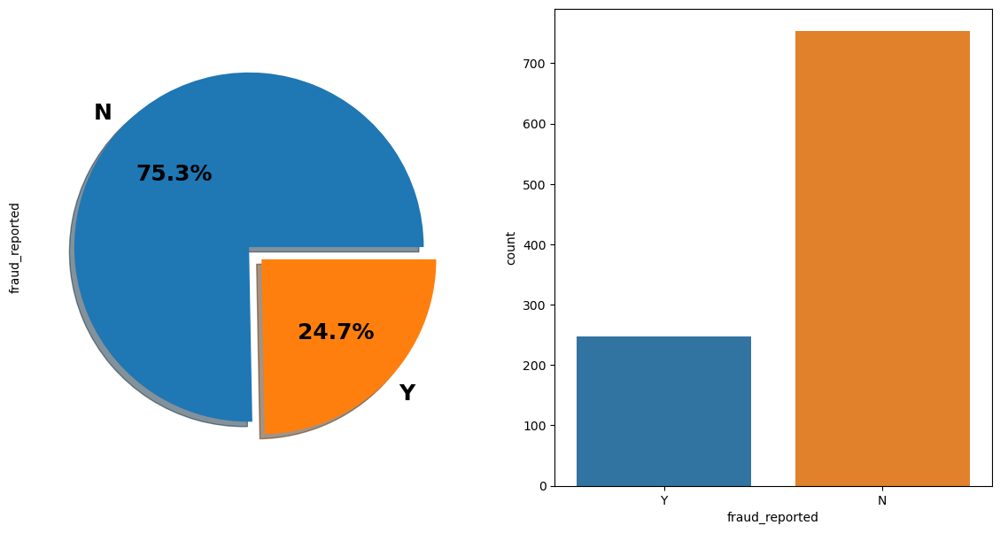

In [297]:
#visualizing the count of "fraud_reported " column:
f,ax=plt.subplots(1,2,figsize=(14,7))
df_in['fraud_reported'].value_counts().plot.pie(explode=[0,0.1],autopct='%3.1f%%',
                                          textprops ={ 'fontweight': 'bold','fontsize':18}, ax=ax[0],shadow=True)
p=sns.countplot(x='fraud_reported',data=df_in)
print(df_in['fraud_reported'].value_counts())

##### Comments:
-> Number of cases where No Fraud reported are 754
-> number of cases where Fraud reported are 247 which is almost ((247/1000)*100)=24.7%
-> we have to predict this Fraud reported as our target variable

FEMALE    537
MALE      463
Name: insured_sex, dtype: int64


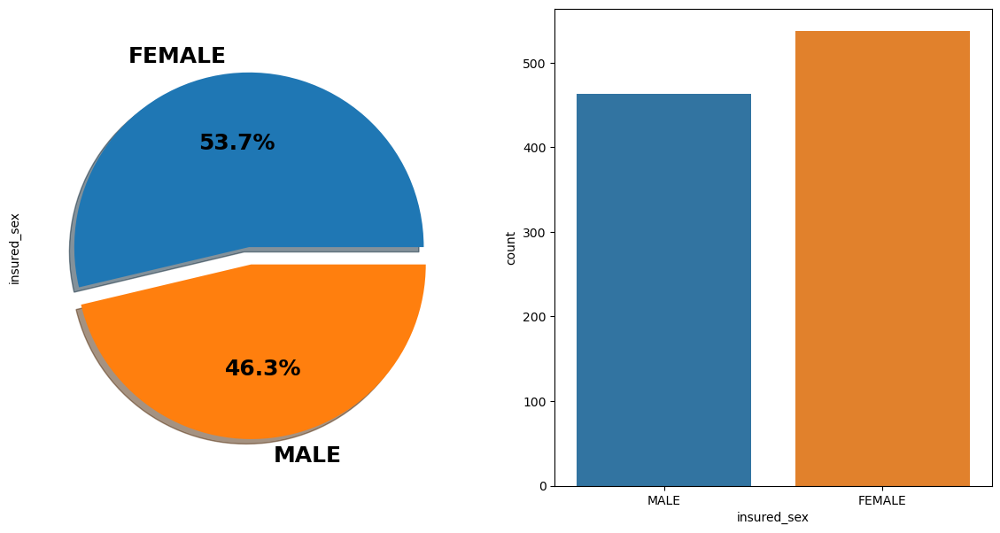

In [298]:
#visualizing the count of "insured_sex" column:
f,ax=plt.subplots(1,2,figsize=(14,7))
df_in['insured_sex'].value_counts().plot.pie(explode=[0,0.1],autopct='%3.1f%%',
                                          textprops ={ 'fontweight': 'bold','fontsize':18}, ax=ax[0],shadow=True)
p=sns.countplot(x='insured_sex',data=df_in)
print(df_in['insured_sex'].value_counts())

##### comments:
-> number of candidtaes insured for policy is more in Females
-> In male also it is a bit lesser.
the counts are 537 for females and 463 for males

NO     686
YES    314
Name: police_report_available, dtype: int64


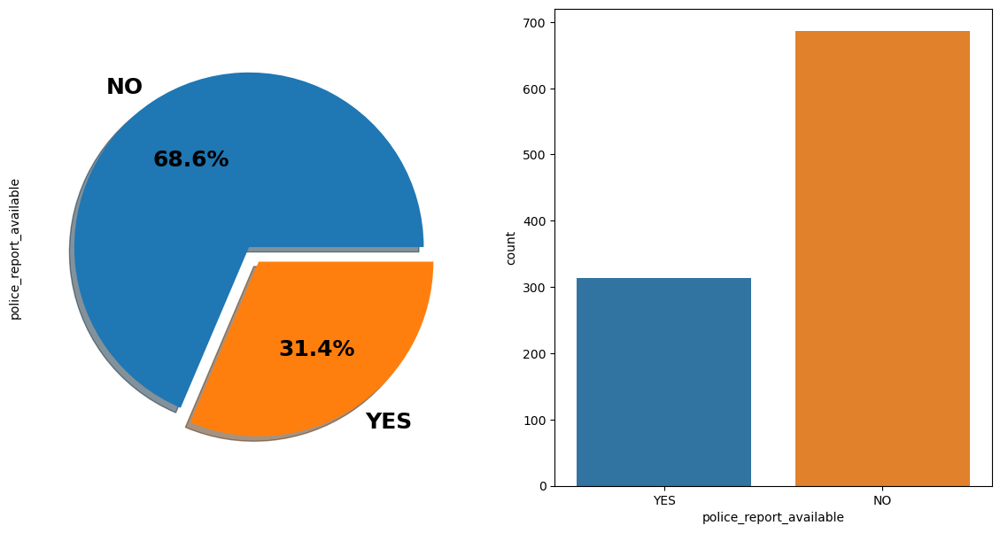

In [299]:
#visualizing the count of "police_report_available" column:
f,ax=plt.subplots(1,2,figsize=(14,7))
df_in['police_report_available'].value_counts().plot.pie(explode=[0,0.1],autopct='%3.1f%%',
                                          textprops ={ 'fontweight': 'bold','fontsize':18}, ax=ax[0],shadow=True)
p=sns.countplot(x='police_report_available',data=df_in)
print(df_in['police_report_available'].value_counts())

##### Comments:
-> here we can see cases with No police report count is 686 and with police report is 314. i.e in 68% cases police report not available
-> In most of the incident cases we can see no police reports is filed.. which shows the carelessness in citizens.. which need to be avoided strightly

NY    262
SC    248
WV    217
VA    110
NC    110
PA     30
OH     23
Name: incident_state, dtype: int64


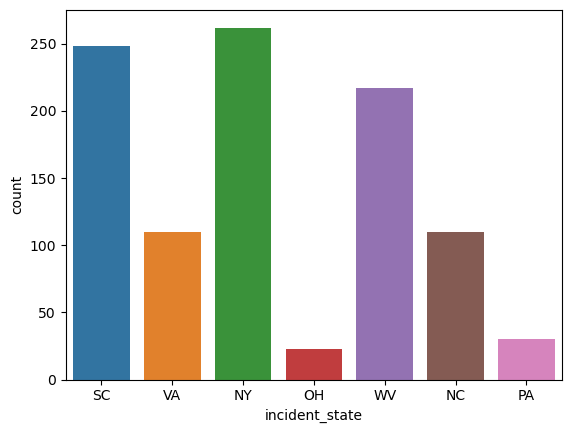

In [301]:
#visualizing the count of "incident_state " column:

p=sns.countplot(x='incident_state',data=df_in)
print(df_in['incident_state'].value_counts())

#### Comments:
-> number of incidents registered in "Ohia" is the least
-> Highest Numver of incidents are in Newyork

Springfield    157
Arlington      152
Columbus       149
Northbend      145
Hillsdale      141
Riverwood      134
Northbrook     122
Name: incident_city, dtype: int64


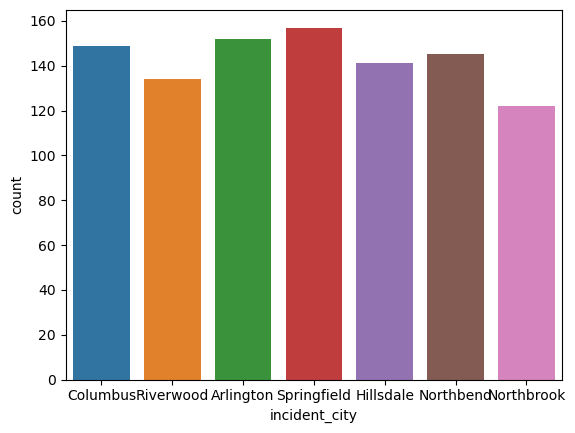

In [281]:
#visualizing the count of "incident_city " column:
p=sns.countplot(x='incident_city',data=df_in)
print(df_in['incident_city'].value_counts())

#### Comments:
-> Almost in all cities the number of incidents are nearly equal

### bivariate Analysis:

In [287]:
df_in.dtypes

months_as_customer               int64
age                              int64
policy_number                    int64
policy_bind_date                object
policy_state                    object
policy_csl                      object
policy_deductable                int64
policy_annual_premium          float64
umbrella_limit                   int64
insured_zip                      int64
insured_sex                     object
insured_education_level         object
insured_occupation              object
insured_hobbies                 object
insured_relationship            object
capital-gains                    int64
capital-loss                     int64
incident_date                   object
incident_type                   object
collision_type                  object
incident_severity               object
authorities_contacted           object
incident_state                  object
incident_city                   object
incident_location               object
incident_hour_of_the_day 

<function matplotlib.pyplot.show(close=None, block=None)>

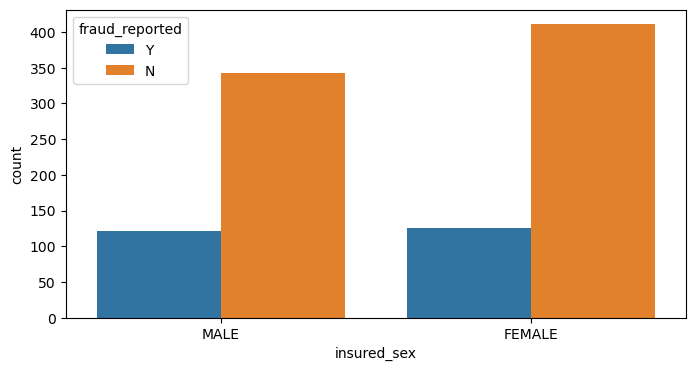

In [289]:
# Insured Sex vs Fraud Reported
plt.figure(figsize=(8,4))
sns.countplot(x="insured_sex", hue="fraud_reported", data=df_in)
plt.show

#### Comments:
->  Number of Fraud reported in both male and females are almost equal.
-> but number of feamles claimed for insurance are more.
-> which indicated Fraud percentage is more in "male"

<function matplotlib.pyplot.show(close=None, block=None)>

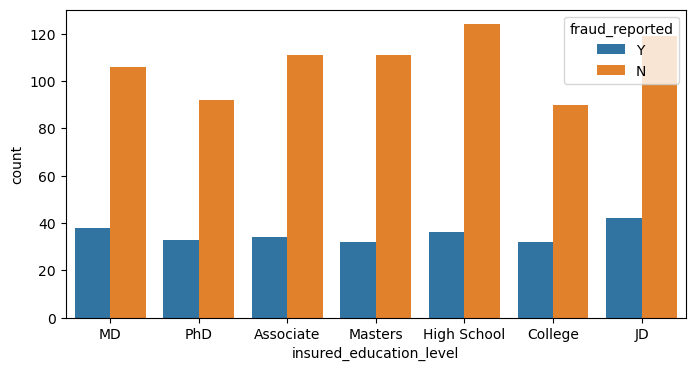

In [307]:
# Insured Eduction level vs Fraud Reported
plt.figure(figsize=(8,4))                   
sns.countplot(x="insured_education_level", hue="fraud_reported", data=df_in)
plt.show

#### Comments:
-> There is not much impact of education level in Fraud report.
-> irrespective of lower to higher education level fraud reported is almost similar percentage in all the cases

<function matplotlib.pyplot.show(close=None, block=None)>

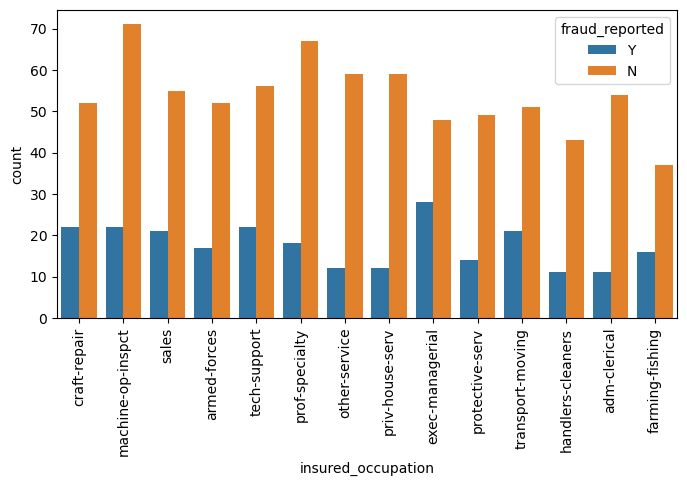

In [309]:
#Insured Occupation vs Fraud reported
plt.figure(figsize=(8,4))
sns.countplot(x="insured_occupation", hue="fraud_reported", data=df_in)
plt.xticks(rotation=90)
plt.show

#### Comments:
-> fraud reported in "exec managerial level" is slightly higher compared to other occupations


<function matplotlib.pyplot.show(close=None, block=None)>

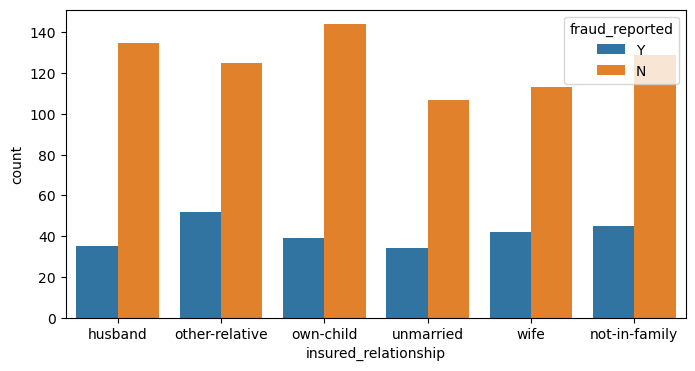

In [292]:
# Insured Relationship vs Fraud_reported
plt.figure(figsize=(8,4))
sns.countplot(x="insured_relationship", hue="fraud_reported", data=df_in)
plt.show

##### Comments:
-> No impact of relationship on Fraud reported.. in all cases it is almost same

<function matplotlib.pyplot.show(close=None, block=None)>

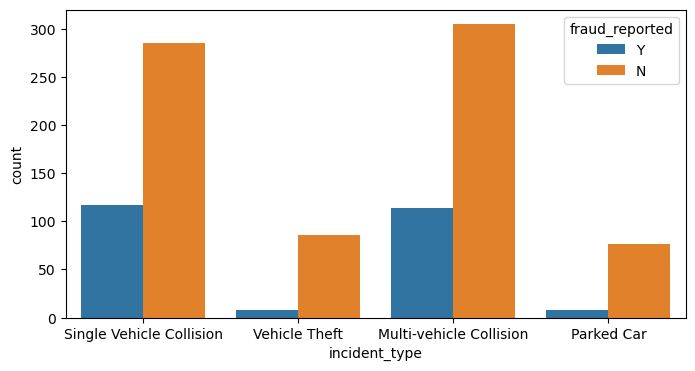

In [293]:
## Incident type vs Fraud_reported
plt.figure(figsize=(8,4))
sns.countplot(x="incident_type", hue="fraud_reported", data=df_in)
plt.show

###### Comments:
-> Fraud reported is more in "Multi vahicle collision" and "Single" Vachile Collision types

<function matplotlib.pyplot.show(close=None, block=None)>

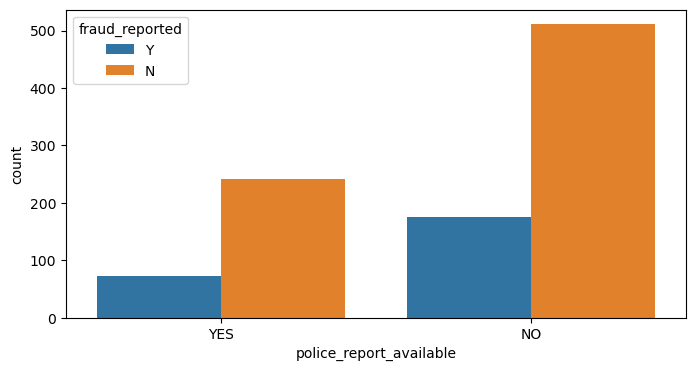

In [294]:
## Police report vs fraud reported
plt.figure(figsize=(8,4))
sns.countplot(x="police_report_available", hue="fraud_reported", data=df_in)
plt.show

<AxesSubplot:xlabel='policy_state'>

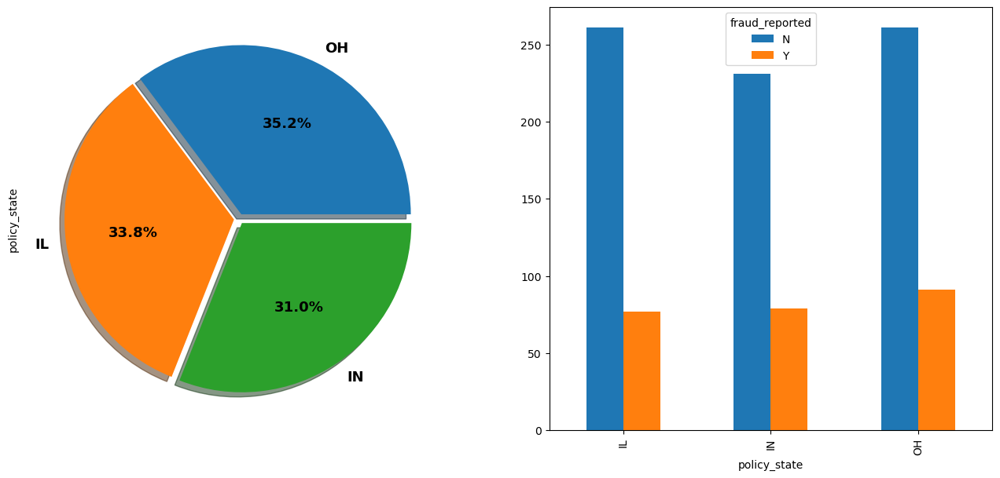

In [296]:
fig,ax=plt.subplots(1,2,figsize=(16,7))
df_in['policy_state'].value_counts().plot.pie(explode=[0.03,0.03,0.03],autopct='%2.1f%%',
                                          textprops ={ 'fontweight': 'bold','fontsize':13}, ax=ax[0],shadow=True)
table = pd.crosstab(df_in['policy_state'], df_in['fraud_reported'])
table.plot(kind = 'bar', ax=ax[1])

#### Comments:
-> In all the states Fraud reported percentage is almost same.. in "Ohio" it is a bit higher

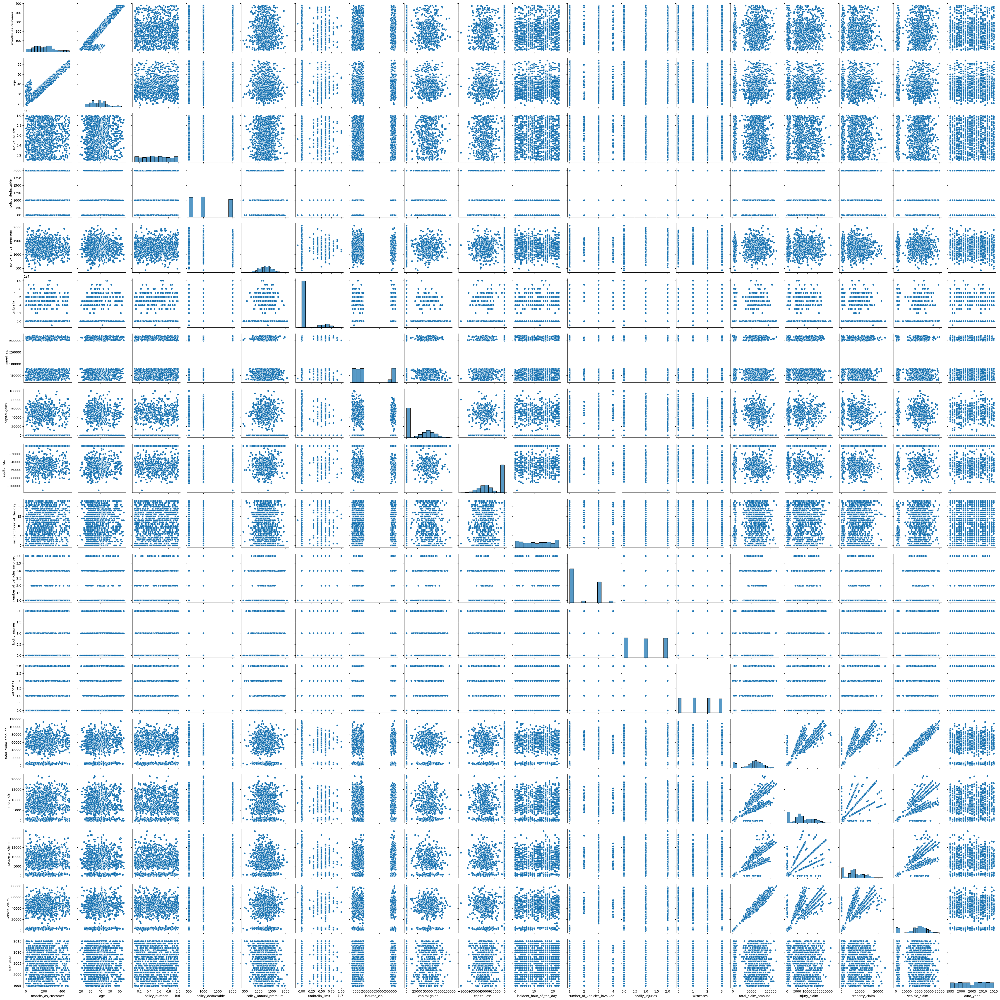

In [295]:
### Pair plot
sns.pairplot(df_in)

# Feature Engineering and Selection

In [316]:
# Encoding Categorical Columns:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in df_in.columns:
    if df_in[i].dtypes=="object":
        df_in[i]=OE.fit_transform(df_in[i].values.reshape(-1,1))    
df_in      

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported
0,328,48,521585,532.0,2.0,1.0,1000,1406.91,0,466132,...,2,1.0,71610,6510,13020,52080,10.0,1.0,2004,1.0
1,228,42,342868,821.0,1.0,1.0,2000,1197.22,5000000,468176,...,0,0.0,5070,780,780,3510,8.0,12.0,2007,1.0
2,134,29,687698,186.0,2.0,0.0,2000,1413.14,5000000,430632,...,3,0.0,34650,7700,3850,23100,4.0,30.0,2007,0.0
3,256,41,227811,766.0,0.0,1.0,2000,1415.74,6000000,608117,...,2,0.0,63400,6340,6340,50720,3.0,34.0,2014,1.0
4,228,44,367455,181.0,0.0,2.0,1000,1583.91,6000000,610706,...,1,0.0,6500,1300,650,4550,0.0,31.0,2009,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,38,941851,487.0,2.0,2.0,1000,1310.80,0,431289,...,1,0.0,87200,17440,8720,61040,6.0,6.0,2006,0.0
996,285,41,186934,129.0,0.0,0.0,1000,1436.79,0,608177,...,3,0.0,108480,18080,18080,72320,13.0,28.0,2015,0.0
997,130,34,918516,509.0,2.0,1.0,500,1383.49,3000000,442797,...,3,1.0,67500,7500,7500,52500,11.0,19.0,1996,0.0
998,458,62,533940,573.0,0.0,2.0,2000,1356.92,5000000,441714,...,1,1.0,46980,5220,5220,36540,1.0,5.0,1998,0.0


In [317]:
df_in.dtypes

months_as_customer               int64
age                              int64
policy_number                    int64
policy_bind_date               float64
policy_state                   float64
policy_csl                     float64
policy_deductable                int64
policy_annual_premium          float64
umbrella_limit                   int64
insured_zip                      int64
insured_sex                    float64
insured_education_level        float64
insured_occupation             float64
insured_hobbies                float64
insured_relationship           float64
capital-gains                    int64
capital-loss                     int64
incident_date                  float64
incident_type                  float64
collision_type                 float64
incident_severity              float64
authorities_contacted          float64
incident_state                 float64
incident_city                  float64
incident_location              float64
incident_hour_of_the_day 

In [318]:
for i in df_in.dtypes.index:
    if df_in.dtypes[i]=="int64":
        df_in[i]=df_in[i].astype(float)

In [319]:
df_in.dtypes

months_as_customer             float64
age                            float64
policy_number                  float64
policy_bind_date               float64
policy_state                   float64
policy_csl                     float64
policy_deductable              float64
policy_annual_premium          float64
umbrella_limit                 float64
insured_zip                    float64
insured_sex                    float64
insured_education_level        float64
insured_occupation             float64
insured_hobbies                float64
insured_relationship           float64
capital-gains                  float64
capital-loss                   float64
incident_date                  float64
incident_type                  float64
collision_type                 float64
incident_severity              float64
authorities_contacted          float64
incident_state                 float64
incident_city                  float64
incident_location              float64
incident_hour_of_the_day 

-> Now all the columns are converted to Float64 datatype

### Outlier Detection

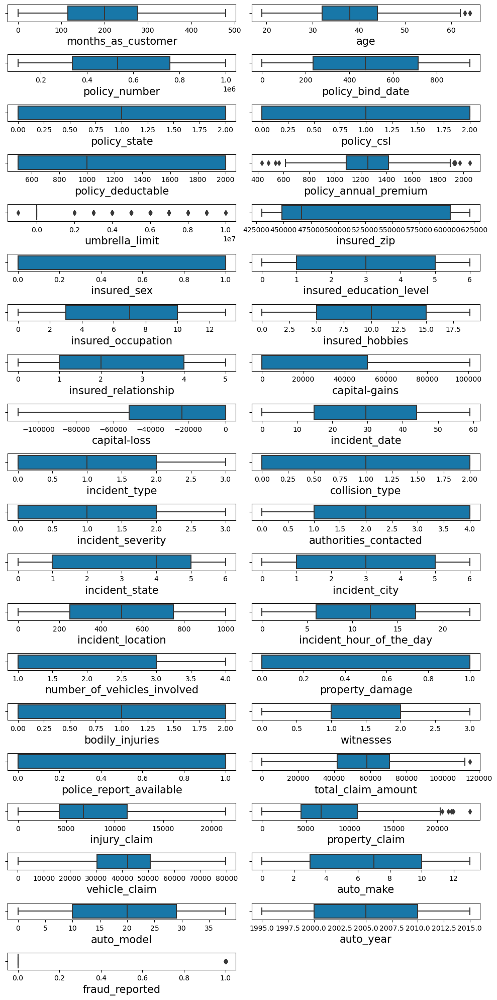

In [320]:
plt.figure(figsize=(10,20),facecolor="white")
plotnum=1
for i in df_in.columns:
    if plotnum<=40:
        p=plt.subplot(20,2,plotnum)
        sns.boxplot(df_in[i],palette='winter_r')
        plt.xlabel(i,fontsize=15)
        plt.yticks(rotation=0,fontsize=10)
        plotnum+=1
plt.tight_layout()    

-> Here the  "Umbrella_limit" columns contains outliers only and this column is not that important factor in predicting the "Fraud report".
-> so we can drop the column

In [321]:
df_in.drop('umbrella_limit',axis=1,inplace=True)

In [322]:
# removing utliers from other columns using Z-Score method
from scipy.stats import zscore
out_features=df_in[['age','policy_annual_premium','total_claim_amount','property_claim']]
z=np.abs(zscore(out_features))
z

,age,policy_annual_premium,total_claim_amount,property_claim
0,0.990836,0.616705,0.714257,1.165505
1,0.334073,0.242521,1.807312,1.372696
2,1.088913,0.642233,0.686362,0.736072
3,0.224613,0.652886,0.403135,0.219722
4,0.552994,1.341980,1.753121,1.399654
...,...,...,...,...
995,0.103769,0.222884,1.305049,0.273817
996,0.224613,0.739141,2.111466,2.214794
997,0.541611,0.520739,0.558507,0.020826
998,2.523284,0.411866,0.219110,0.451976


In [323]:
#threshold=3
np.where(z>3)

(array([229, 248, 500, 763], dtype=int64), array([1, 1, 3, 1], dtype=int64))

In [324]:
# we have to removethese rows which have outliers:
df_in1=df_in[(z<3).all(axis=1)]
df_in1.shape          # after removing outliers the data frame size

(996, 38)

In [325]:
df_in.shape 

(1000, 38)

In [326]:
#data loss percentage:
print("data loss percentage",((df_in.shape[0]-df_in1.shape[0])/df_in.shape[0])*100)

data loss percentage 0.4


###### The dataloss percentage is so less.. so we can proceed

#### Checking for Skewness:

In [327]:

df_in1.skew()

months_as_customer             0.359605
age                            0.474526
policy_number                  0.033722
policy_bind_date               0.009227
policy_state                  -0.028155
policy_csl                     0.092982
policy_deductable              0.473229
policy_annual_premium          0.032042
insured_zip                    0.825568
insured_sex                    0.145176
insured_education_level        0.001349
insured_occupation            -0.063714
insured_hobbies               -0.060160
insured_relationship           0.076423
capital-gains                  0.478850
capital-loss                  -0.393015
incident_date                  0.003852
incident_type                  0.102917
collision_type                -0.033826
incident_severity              0.275635
authorities_contacted         -0.120741
incident_state                -0.144616
incident_city                  0.046459
incident_location              0.001140
incident_hour_of_the_day      -0.039123


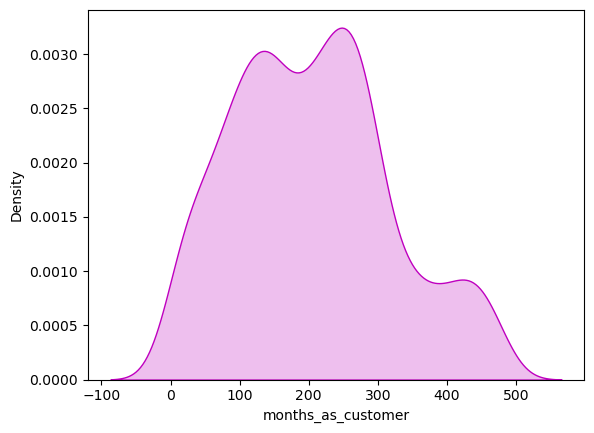

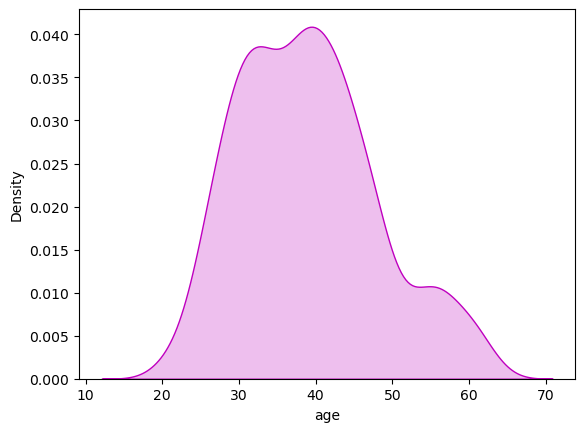

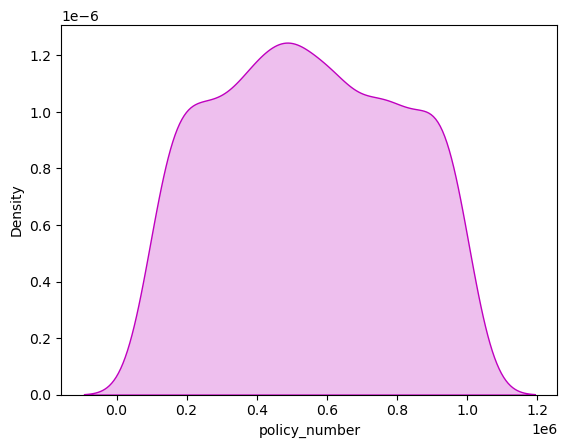

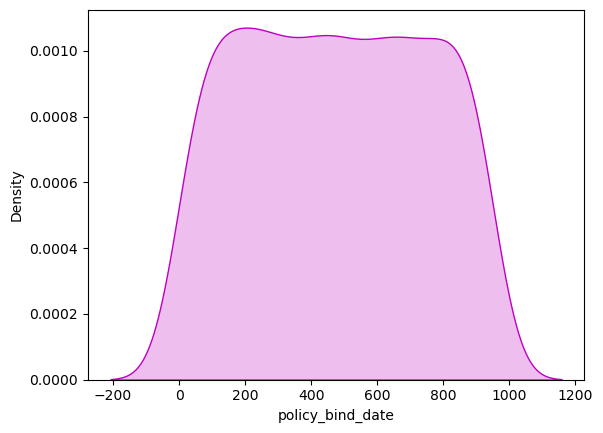

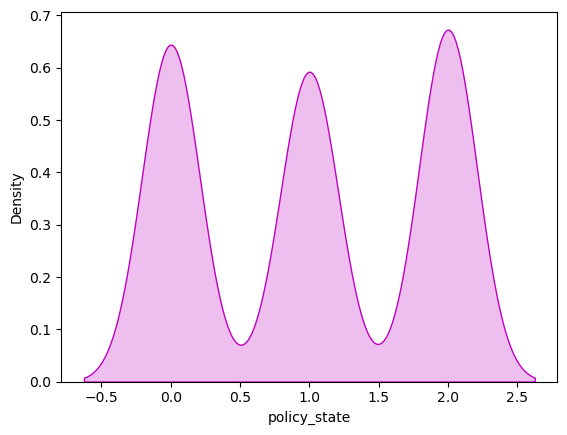

...

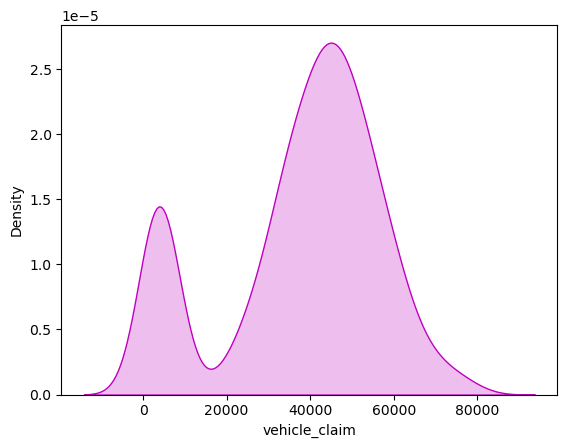

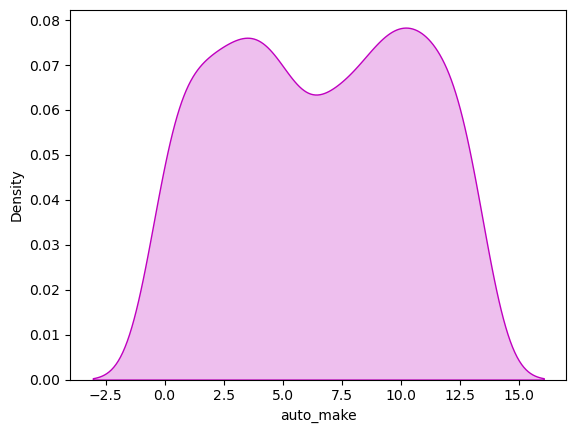

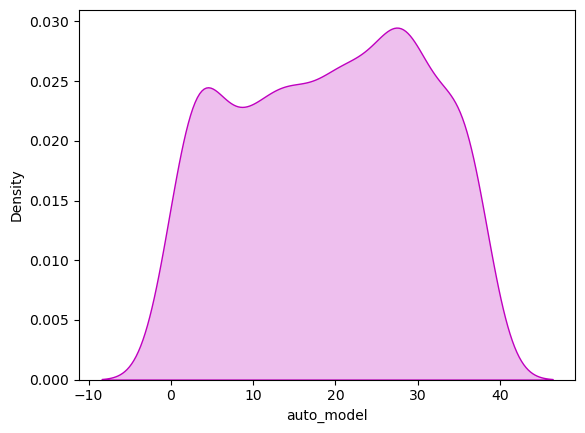

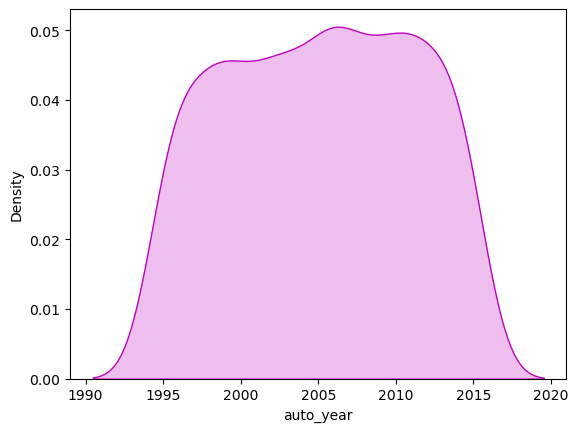

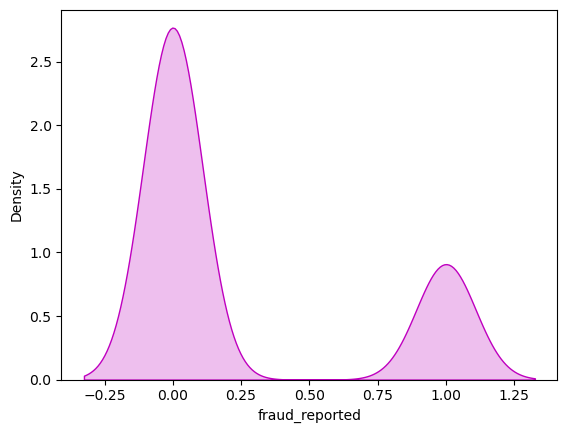

In [328]:
#visualizing the spreading of data
for i in df_in1.columns:
    sns.distplot(df_in1[i],color="m",kde_kws={"shade":True},hist=False)
    plt.show()

##### Comments:
-> we can check skewness of all the columns are less.. only the Fraud_reported column has higher skewness value, but as it is the target variable no transformation needed

# Correlation Matrix:

In [329]:
corr=df_in1.corr()
corr

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,insured_zip,insured_sex,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported
months_as_customer,1.000000,0.922092,0.057341,0.058204,0.000118,-0.022964,0.023512,-0.003378,0.023501,0.059002,...,0.063530,-0.018760,0.064193,0.066416,0.041157,0.062062,0.049222,0.002908,0.001287,0.020966
age,0.922092,1.000000,0.059191,0.058228,-0.015182,-0.012429,0.026772,0.005890,0.030629,0.072900,...,0.056658,-0.018493,0.069989,0.075480,0.064230,0.061949,0.032105,0.016258,0.003268,0.012408
policy_number,0.057341,0.059191,1.000000,0.046034,0.071577,0.037946,-0.006207,0.028276,0.005912,0.005311,...,-0.009720,0.028527,-0.018315,-0.009699,-0.011162,-0.020245,0.019522,0.063239,-0.003715,-0.034174
policy_bind_date,0.058204,0.058228,0.046034,1.000000,0.015101,0.005954,0.000440,-0.040311,-0.043896,0.043203,...,-0.009772,-0.013992,0.011796,0.020547,0.003675,0.010236,-0.025100,-0.000328,0.035488,0.060150
policy_state,0.000118,-0.015182,0.071577,0.015101,1.000000,-0.000349,0.010740,0.014475,0.007686,-0.019294,...,0.024809,0.065957,-0.008498,-0.046398,0.002678,-0.000560,0.015848,-0.024513,0.002323,0.028864
policy_csl,-0.022964,-0.012429,0.037946,0.005954,-0.000349,1.000000,0.006149,0.030864,0.002870,-0.008369,...,0.069261,-0.005447,-0.058306,-0.080474,-0.048187,-0.048414,-0.006565,0.048351,-0.034893,-0.038795
policy_deductable,0.023512,0.026772,-0.006207,0.000440,0.010740,0.006149,1.000000,-0.008445,0.007891,-0.011671,...,0.069433,0.040969,0.024621,0.040337,0.069537,0.006292,-0.034266,-0.003597,0.027497,0.015833
policy_annual_premium,-0.003378,0.005890,0.028276,-0.040311,0.014475,0.030864,-0.008445,1.000000,0.048287,0.041830,...,0.006365,0.029619,0.003550,-0.024031,-0.007964,0.013198,0.011595,-0.034998,-0.040439,-0.010174
insured_zip,0.023501,0.030629,0.005912,-0.043896,0.007686,0.002870,0.007891,0.048287,1.000000,-0.036644,...,0.016323,0.005740,-0.033431,-0.016045,-0.011653,-0.039601,-0.025151,0.025402,-0.036520,0.018075
insured_sex,0.059002,0.072900,0.005311,0.043203,-0.019294,-0.008369,-0.011671,0.041830,-0.036644,1.000000,...,0.044173,0.009884,-0.019318,0.004603,-0.009457,-0.025778,0.026040,-0.017679,-0.028638,0.032173


In [330]:
corr['fraud_reported'].sort_values(ascending=False)

fraud_reported                 1.000000
vehicle_claim                  0.170589
total_claim_amount             0.163936
property_claim                 0.138572
injury_claim                   0.089900
policy_bind_date               0.060150
witnesses                      0.051283
number_of_vehicles_involved    0.048612
bodily_injuries                0.035484
insured_sex                    0.032173
policy_state                   0.028864
months_as_customer             0.020966
insured_zip                    0.018075
insured_relationship           0.017992
property_damage                0.017270
policy_deductable              0.015833
age                            0.012408
insured_education_level        0.011520
incident_hour_of_the_day       0.005863
auto_year                      0.004758
insured_occupation             0.003335
auto_model                    -0.001416
incident_location             -0.005656
policy_annual_premium         -0.010174
capital-loss                  -0.012552


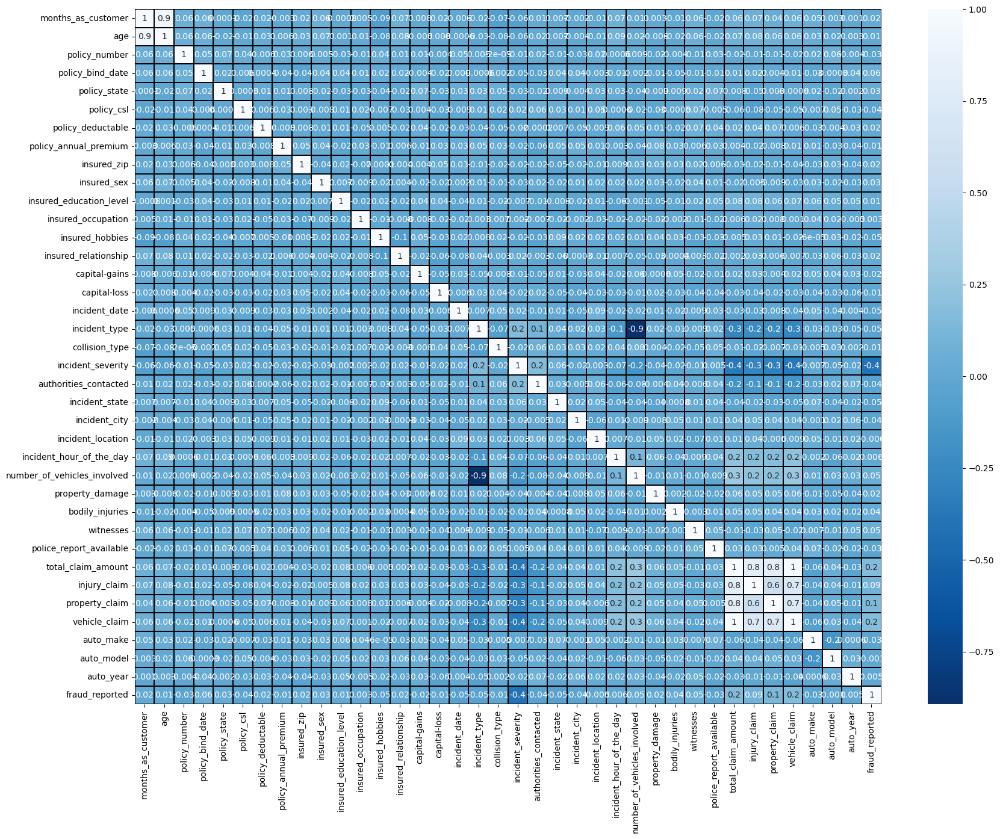

In [331]:
#visualizing the corelation matrix by using the heaatmap
plt.figure(figsize=(20,15))
sns.heatmap(df_in1.corr(),linewidth=0.1,fmt='0.1g',linecolor="black",annot=True,cmap="Blues_r")
plt.yticks(rotation=0);
plt.show()

##### Comments:
-> from the above correlation matrix we can observe the "incident_type" column is highly negatively corelated with the column "number_of_vachiles_involved'
-> also the "property_claim","vachile_claim","injury_claim","total_claim_amout" columns are creating some multi colinearity issue

###### As the number of input variables are more we can apply the PCA method to find out the principal coomponents that contributing moe towards the prediction
-> through this PCA method some multicolinearity issue also resolved


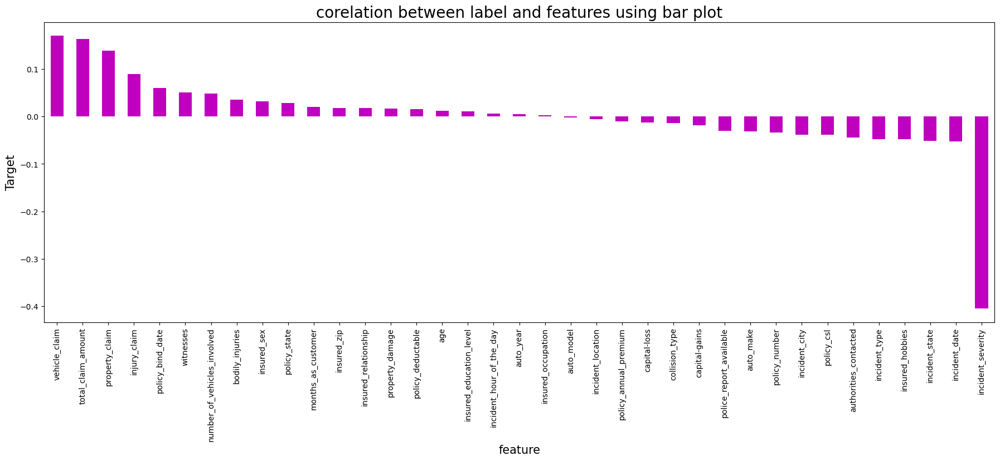

In [332]:
# visualizing the corelation using barplot:
plt.figure(figsize=(22,7))
df_in1.corr()['fraud_reported'].sort_values(ascending=False).drop(['fraud_reported']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


######  From above bar plot we can observe "Incident severity" column is highly corelated with the target variable

## Checking For Multicolinearity:

In [333]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif= pd.DataFrame()
vif['VIF']= [variance_inflation_factor(df_in1.values,i) for i in range(df_in1.shape[1])]
vif['Features']= df_in.columns
vif
	

,VIF,Features
0,28.445045,months_as_customer
1,131.535837,age
2,5.706979,policy_number
3,4.076927,policy_bind_date
4,2.588966,policy_state
5,2.465405,policy_csl
6,4.625333,policy_deductable
7,29.520644,policy_annual_premium
8,51.401509,insured_zip
9,1.917959,insured_sex


###### Some colums are creating vary high multicolinearity.. we can avoid this by using the "PCA" in next procedure

# Model Building

In [334]:
#separating target variable and input variable

x=df_in1.drop('fraud_reported',axis=1)
y=df_in1['fraud_reported']

In [335]:
x

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,insured_zip,insured_sex,...,bodily_injuries,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year
0,328.0,48.0,521585.0,532.0,2.0,1.0,1000.0,1406.91,466132.0,1.0,...,1.0,2.0,1.0,71610.0,6510.0,13020.0,52080.0,10.0,1.0,2004.0
1,228.0,42.0,342868.0,821.0,1.0,1.0,2000.0,1197.22,468176.0,1.0,...,0.0,0.0,0.0,5070.0,780.0,780.0,3510.0,8.0,12.0,2007.0
2,134.0,29.0,687698.0,186.0,2.0,0.0,2000.0,1413.14,430632.0,0.0,...,2.0,3.0,0.0,34650.0,7700.0,3850.0,23100.0,4.0,30.0,2007.0
3,256.0,41.0,227811.0,766.0,0.0,1.0,2000.0,1415.74,608117.0,0.0,...,1.0,2.0,0.0,63400.0,6340.0,6340.0,50720.0,3.0,34.0,2014.0
4,228.0,44.0,367455.0,181.0,0.0,2.0,1000.0,1583.91,610706.0,1.0,...,0.0,1.0,0.0,6500.0,1300.0,650.0,4550.0,0.0,31.0,2009.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3.0,38.0,941851.0,487.0,2.0,2.0,1000.0,1310.80,431289.0,0.0,...,0.0,1.0,0.0,87200.0,17440.0,8720.0,61040.0,6.0,6.0,2006.0
996,285.0,41.0,186934.0,129.0,0.0,0.0,1000.0,1436.79,608177.0,0.0,...,2.0,3.0,0.0,108480.0,18080.0,18080.0,72320.0,13.0,28.0,2015.0
997,130.0,34.0,918516.0,509.0,2.0,1.0,500.0,1383.49,442797.0,0.0,...,2.0,3.0,1.0,67500.0,7500.0,7500.0,52500.0,11.0,19.0,1996.0
998,458.0,62.0,533940.0,573.0,0.0,2.0,2000.0,1356.92,441714.0,1.0,...,0.0,1.0,1.0,46980.0,5220.0,5220.0,36540.0,1.0,5.0,1998.0


#### Scalling input variables

In [336]:
# feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,insured_zip,insured_sex,...,bodily_injuries,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year
0,1.074671,0.987190,-0.097104,0.212137,1.186130,0.063660,-0.224722,0.621371,-0.486746,1.075102,...,0.007356,0.466826,1.480644,0.716023,-0.188161,1.174449,0.750488,0.857248,-1.644810,-0.182338
1,0.204846,0.330455,-0.793232,1.262042,-0.018137,0.063660,1.409024,-0.251375,-0.458176,1.075102,...,-1.213749,-1.335340,-0.675382,-1.808185,-1.363038,-1.376935,-1.824061,0.360986,-0.657437,0.316587
2,-0.612790,-1.092470,0.549931,-1.044842,1.186130,-1.179582,1.409024,0.647301,-0.982961,-0.930144,...,1.228462,1.367910,-0.675382,-0.686062,0.055836,-0.737005,-0.785654,-0.631538,0.958263,0.316587
3,0.448397,0.221000,-1.241396,1.062233,-1.222403,0.063660,1.409024,0.658123,1.497902,-0.930144,...,0.007356,0.466826,-0.675382,0.404575,-0.223018,-0.217973,0.678398,-0.879669,1.317308,1.480744
4,0.204846,0.549367,-0.697463,-1.063007,-1.222403,1.306902,-0.224722,1.358059,1.534091,1.075102,...,-1.213749,-0.434257,-0.675382,-1.753938,-1.256417,-1.404033,-1.768934,-1.624063,1.048024,0.649203
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
991,-1.752261,-0.107368,1.539894,0.048657,1.186130,1.306902,-0.224722,0.221354,-0.973777,-0.930144,...,-1.213749,-0.434257,-0.675382,1.307433,2.052922,0.278129,1.225430,-0.135276,-1.196004,0.150278
992,0.700646,0.221000,-1.400618,-1.251917,-1.222403,-1.179582,-0.224722,0.745734,1.498741,-0.930144,...,1.228462,1.367910,-0.675382,2.114694,2.184148,2.229188,1.823349,1.601641,0.778741,1.647052
993,-0.647583,-0.545191,1.449000,0.128581,1.186130,0.063660,-1.041595,0.523896,-0.812920,-0.930144,...,1.228462,1.367910,1.480644,0.560110,0.014828,0.023825,0.772751,1.105379,-0.029109,-1.512803
994,2.205443,2.519571,-0.048979,0.361086,-1.222403,1.306902,1.409024,0.413309,-0.828058,1.075102,...,-1.213749,-0.434257,1.480644,-0.218321,-0.452662,-0.451433,-0.073241,-1.375932,-1.285765,-1.180187


#### Selecting the Principal components :

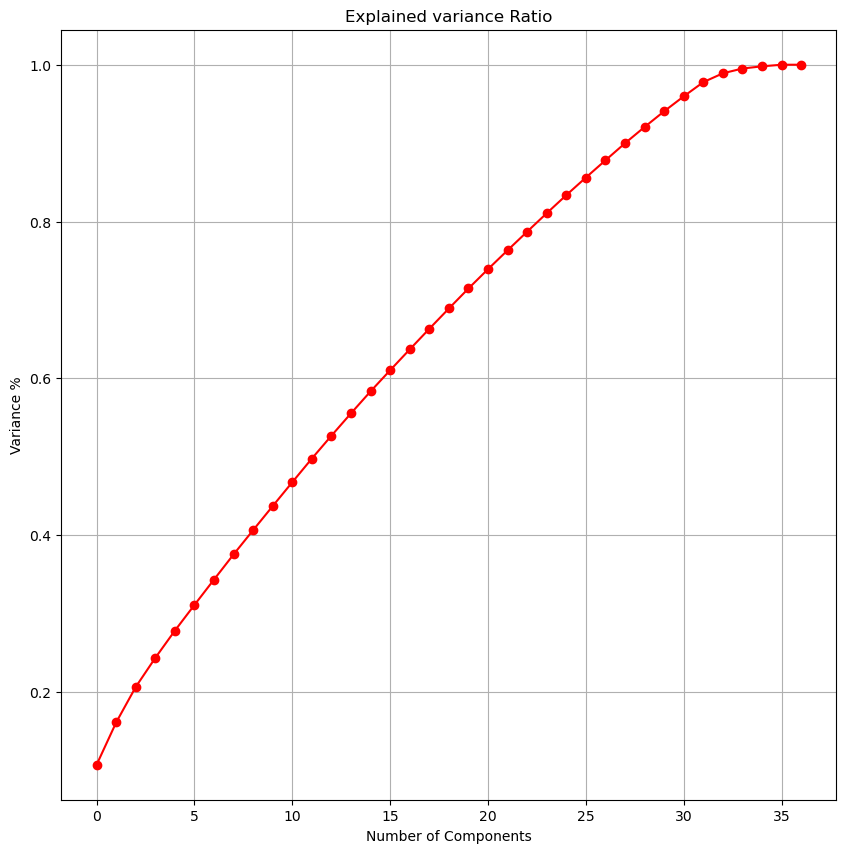

In [337]:
from sklearn.decomposition import PCA
pca = PCA()
#graph to find the principal components
x_pca = pca.fit_transform(x)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

-> we can see total 29 components are contributing toward 90% of the prediction.. so we can take those as the principal components

In [338]:
pca_new = PCA(n_components=29)
x_new = pca_new.fit_transform(x)

In [339]:
x_new=pd.DataFrame(x_new,columns=np.arange(29))

In [340]:
y.value_counts()

0.0    750
1.0    246
Name: fraud_reported, dtype: int64

#### the target variable is not balanced.. we have to balance the data for model prediction. so that we are using SMOTE here

In [341]:
!pip install -U imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable


In [346]:
# to balance the target variable data over sampling is performed:
from imblearn.over_sampling import SMOTE
sm=SMOTE()
x1,y1=sm.fit_resample(x_new,y)

In [347]:
y1.value_counts()

1.0    750
0.0    750
Name: fraud_reported, dtype: int64

# Model
->the given problem statement is a binary classification problem.. so we can apply Naive Bayes classifier, logistic regression knn descission tree..

In [348]:
#finding the best random state:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.model_selection import cross_val_score


In [349]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
maxAcc=0
maxRs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=.25,random_state=i)
    LR=LogisticRegression()
    LR.fit(x_train,y_train)
    pred=LR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum acc_score is",maxAcc, "on random_state",maxRs)        

maximum acc_score is 0.7573333333333333 on random_state 93


In [350]:
# creating train test split:
x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=0.25,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(1125, 29)
(1125,)
(375, 29)
(375,)


In [351]:
#Logistic regression model:
logR=LogisticRegression()
logR.fit(x_train,y_train)
pred_train=logR.predict(x_train)
pred_Lgr=logR.predict(x_test)
print("predicted accuracy",accuracy_score(y_test,pred_Lgr))
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(confusion_matrix(y_test,pred_Lgr))
print(classification_report(y_test,pred_Lgr))


predicted accuracy 0.7573333333333333
accuracy score of original y_test data 0.7155555555555555
[[137  39]
 [ 52 147]]
              precision    recall  f1-score   support

         0.0       0.72      0.78      0.75       176
         1.0       0.79      0.74      0.76       199

    accuracy                           0.76       375
   macro avg       0.76      0.76      0.76       375
weighted avg       0.76      0.76      0.76       375



In [352]:
#DecissionTreeClassifier:
from sklearn.tree import DecisionTreeClassifier
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
pred_dtc=dtc.predict(x_test)
pred_train=dtc.predict(x_train)
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(accuracy_score(y_test,pred_dtc))
print(confusion_matrix(y_test,pred_dtc))
print(classification_report(y_test,pred_dtc))

accuracy score of original y_test data 1.0
0.7973333333333333
[[140  36]
 [ 40 159]]
              precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       176
         1.0       0.82      0.80      0.81       199

    accuracy                           0.80       375
   macro avg       0.80      0.80      0.80       375
weighted avg       0.80      0.80      0.80       375



In [353]:
#RandomForestClassifier:
RFC=RandomForestClassifier()
RFC.fit(x_train,y_train)
pred_RFC=RFC.predict(x_test)
print(accuracy_score(y_test,pred_RFC))
print(confusion_matrix(y_test,pred_RFC))
print(classification_report(y_test,pred_RFC))


0.8773333333333333
[[161  15]
 [ 31 168]]
              precision    recall  f1-score   support

         0.0       0.84      0.91      0.88       176
         1.0       0.92      0.84      0.88       199

    accuracy                           0.88       375
   macro avg       0.88      0.88      0.88       375
weighted avg       0.88      0.88      0.88       375



In [354]:
#KNeighborsClassifier:
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
print(accuracy_score(y_test,pred_knn))
print(confusion_matrix(y_test,pred_knn))
print(classification_report(y_test,pred_knn))


0.672
[[ 60 116]
 [  7 192]]
              precision    recall  f1-score   support

         0.0       0.90      0.34      0.49       176
         1.0       0.62      0.96      0.76       199

    accuracy                           0.67       375
   macro avg       0.76      0.65      0.63       375
weighted avg       0.75      0.67      0.63       375



In [355]:
#GaussianNB:
gnb = GaussianNB()
gnb.fit(x_train,y_train)
pred_gnb=gnb.predict(x_test)
print(accuracy_score(y_test,pred_gnb))
print(confusion_matrix(y_test,pred_gnb))
print(classification_report(y_test,pred_gnb))


0.7866666666666666
[[135  41]
 [ 39 160]]
              precision    recall  f1-score   support

         0.0       0.78      0.77      0.77       176
         1.0       0.80      0.80      0.80       199

    accuracy                           0.79       375
   macro avg       0.79      0.79      0.79       375
weighted avg       0.79      0.79      0.79       375



## Cross Validating the Models:

In [357]:
# cross validation of the model:
from sklearn.model_selection import cross_val_score

In [358]:
score_LR=cross_val_score(logR,x1,y1)           #cross validation score of logistic regression
print(score_LR)
print(score_LR.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_Lgr)-(score_LR.mean()))

[0.69       0.71666667 0.68333333 0.71333333 0.77666667]
0.716
diff b/w accuracy score and cross validation score is: 0.04133333333333333


In [359]:
score_dtc=cross_val_score(dtc,x1,y1)           #cross validation score of dtc
print(score_dtc)
print(score_dtc.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_dtc)-(score_dtc.mean()))

[0.65333333 0.69666667 0.72333333 0.77       0.78333333]
0.7253333333333333
diff b/w accuracy score and cross validation score is: 0.07200000000000006


In [360]:
score_RFC=cross_val_score(RFC,x1,y1)                           #cross validation score of RandomForest
print(score_RFC)
print(score_RFC.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_RFC)-(score_RFC.mean()))

[0.81       0.84       0.88333333 0.88333333 0.93666667]
0.8706666666666667
diff b/w accuracy score and cross validation score is: 0.006666666666666599


In [361]:
score_knn=cross_val_score(knn,x1,y1)                           #cross validation score of knn
print(score_knn)
print(score_knn.mean())
print("diff b/w acscuracy score and cross validation score is:",accuracy_score(y_test,pred_knn)-(score_knn.mean()))

[0.64666667 0.64333333 0.67666667 0.68333333 0.67      ]
0.664
diff b/w acscuracy score and cross validation score is: 0.008000000000000007


In [362]:
score_gnb=cross_val_score(gnb,x1,y1)                           #cross validation score of GaussianNB
print(score_gnb)
print(score_gnb.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_gnb)-(score_gnb.mean()))

[0.62666667 0.69666667 0.73       0.79       0.8       ]
0.7286666666666667
diff b/w accuracy score and cross validation score is: 0.05799999999999994


#####  By varifying the accuracy score and the cross validation score we can conclude that the random forest model fits best

## Hyper Parameter Tuning:

In [366]:
from sklearn.model_selection import GridSearchCV
parameter = {  'bootstrap': [True], 'max_depth': [5, 10,20,40,50,60], 
              'max_features': ['auto', 'log2'], 
              'criterion':['gini','entropy'],
              'n_estimators': [5, 10, 15 ,25,50,60,70]}
GCV = GridSearchCV(RandomForestClassifier(),parameter,cv=5)
GCV.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'bootstrap': [True], 'criterion': ['gini', 'entropy'],
                         'max_depth': [5, 10, 20, 40, 50, 60],
                         'max_features': ['auto', 'log2'],
                         'n_estimators': [5, 10, 15, 25, 50, 60, 70]})

In [367]:
GCV.best_params_

{'bootstrap': True,
 'criterion': 'gini',
 'max_depth': 50,
 'max_features': 'log2',
 'n_estimators': 60}

In [368]:
MODEL_INSURANCE=RandomForestClassifier(bootstrap= True,criterion= 'gini',max_depth= 50,max_features= 'log2',n_estimators= 60)

# Final Model

In [369]:
MODEL_INSURANCE.fit(x_train,y_train)
pred=MODEL_INSURANCE.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

87.73333333333333


### In final model we are getting 87.73% accuracy

In [370]:
import joblib
joblib.dump(MODEL_INSURANCE,'Insurance Claim Fraud Detection Analysis')


['Insurance Claim Fraud Detection Analysis']

In [371]:
RFC_INSURANCE=joblib.load('Insurance Claim Fraud Detection Analysis')
predictionM=RFC_INSURANCE.predict(x_test)
predictionM

array([1., 1., 1., 1., 1., 1., 0., 1., 1., 0., 1., 1., 1., 0., 0., 0., 1.,
       1., 1., 1., 1., 1., 1., 1., 0., 0., 1., 0., 1., 1., 0., 1., 1., 0.,
       0., 1., 1., 1., 0., 0., 0., 0., 1., 0., 1., 0., 1., 0., 1., 0., 1.,
       1., 1., 1., 1., 1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
       0., 0., 0., 1., 1., 1., 1., 1., 0., 0., 1., 1., 1., 0., 0., 1., 0.,
       1., 1., 1., 0., 0., 1., 1., 1., 1., 0., 0., 0., 0., 0., 1., 1., 0.,
       0., 1., 0., 1., 1., 1., 0., 1., 1., 0., 0., 1., 0., 0., 0., 0., 1.,
       1., 1., 1., 1., 0., 1., 1., 0., 1., 0., 1., 0., 1., 0., 1., 0., 0.,
       0., 1., 1., 0., 1., 0., 1., 1., 1., 1., 1., 0., 0., 0., 0., 1., 0.,
       0., 0., 1., 0., 0., 0., 1., 1., 0., 0., 0., 0., 1., 1., 0., 1., 1.,
       0., 0., 0., 1., 0., 1., 0., 1., 0., 0., 1., 1., 0., 1., 0., 1., 0.,
       1., 1., 0., 1., 0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 1., 0., 0.,
       1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 0., 0.,
       1., 0., 0., 0., 1.

In [372]:
a=np.array(y_test)
DF_INSURANCE=pd.DataFrame()
DF_INSURANCE['predicted']=predictionM
DF_INSURANCE['original']=a
DF_INSURANCE

,predicted,original
0,1.0,1.0
1,1.0,1.0
2,1.0,1.0
3,1.0,1.0
4,1.0,1.0
...,...,...
370,1.0,1.0
371,0.0,0.0
372,1.0,1.0
373,1.0,1.0


# 4: Zomato Restaurant

Zomato Data Analysis is one of the most useful analysis for foodies who want to taste the best
cuisines of every part of the world which lies in their budget. This analysis is also for those who
want to find the value for money restaurants in various parts of the country for the cuisines.
Additionally, this analysis caters the needs of people who are striving to get the best cuisine of
the country and which locality of that country serves that cuisines with maximum number of
restaurants.

Data Storage:
This problem statement contains two datasets- Zomato.csv and country_code.csv.
Country_code.csv contains two variables:
• Country code
• Country name

The collected data has been stored in the Comma Separated Value file Zomato.csv. Each
restaurant in the dataset is uniquely identified by its Restaurant Id. Every Restaurant contains the following variables:
• Restaurant Id: Unique id of every restaurant across various cities of the world
• Restaurant Name: Name of the restaurant
• Country Code: Country in which restaurant is located
• City: City in which restaurant is located
• Address: Address of the restaurant
• Locality: Location in the city
• Locality Verbose: Detailed description of the locality
• Longitude: Longitude coordinate of the restaurant&#39;s location
• Latitude: Latitude coordinate of the restaurant&#39;s location
• Cuisines: Cuisines offered by the restaurant
• Average Cost for two: Cost for two people in different currencies ��
• Currency: Currency of the country
• Has Table booking: yes/no
• Has Online delivery: yes/ no
• Is delivering: yes/ no
• Switch to order menu: yes/no
• Price range: range of price of food
• Aggregate Rating: Average rating out of 5
• Rating color: depending upon the average rating color
• Rating text: text on the basis of rating of rating
• Votes: Number of ratings casted by people

Problem statement : In this dataset we have to predict 2 things –
1) Average Cost for two
2) Price range

Dataset Link-  
•	https://github.com/dsrscientist/dataset4/blob/main/Country-Code.xlsx 

•	https://github.com/dsrscientist/dataset4/blob/main/zomato.csv



In [345]:
dfc=pd.read_excel('Country-Code.xlsx')
dfc

,Country Code,Country
0,1,India
1,14,Australia
2,30,Brazil
3,37,Canada
4,94,Indonesia
5,148,New Zealand
6,162,Phillipines
7,166,Qatar
8,184,Singapore
9,189,South Africa


In [346]:
dfz=pd.read_csv('zomato.csv',encoding='latin-1')
dfz

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,5915730,NamlÛ± Gurme,208,ÛÁstanbul,"Kemankeô Karamustafa Paôa Mahallesi, RÛ±htÛ±...",Karakí_y,"Karakí_y, ÛÁstanbul",28.977392,41.022793,Turkish,...,Turkish Lira(TL),No,No,No,No,3,4.1,Green,Very Good,788
9547,5908749,Ceviz AÛôacÛ±,208,ÛÁstanbul,"Koôuyolu Mahallesi, Muhittin íìstí_ndaÛô Cadd...",Koôuyolu,"Koôuyolu, ÛÁstanbul",29.041297,41.009847,"World Cuisine, Patisserie, Cafe",...,Turkish Lira(TL),No,No,No,No,3,4.2,Green,Very Good,1034
9548,5915807,Huqqa,208,ÛÁstanbul,"Kuruí_eôme Mahallesi, Muallim Naci Caddesi, N...",Kuruí_eôme,"Kuruí_eôme, ÛÁstanbul",29.034640,41.055817,"Italian, World Cuisine",...,Turkish Lira(TL),No,No,No,No,4,3.7,Yellow,Good,661
9549,5916112,Aôôk Kahve,208,ÛÁstanbul,"Kuruí_eôme Mahallesi, Muallim Naci Caddesi, N...",Kuruí_eôme,"Kuruí_eôme, ÛÁstanbul",29.036019,41.057979,Restaurant Cafe,...,Turkish Lira(TL),No,No,No,No,4,4.0,Green,Very Good,901


## merging two data frames

In [347]:
dfzo=pd.merge(dfc,dfz)
dfzo

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1,India,3400025,Jahanpanah,Agra,"E 23, Shopping Arcade, Sadar Bazaar, Agra Cant...",Agra Cantt,"Agra Cantt, Agra",78.011544,27.161661,...,Indian Rupees(Rs.),No,No,No,No,3,3.9,Yellow,Good,140
1,1,India,3400341,Rangrezz Restaurant,Agra,"E-20, Shopping Arcade, Sadar Bazaar, Agra Cant...",Agra Cantt,"Agra Cantt, Agra",0.000000,0.000000,...,Indian Rupees(Rs.),No,No,No,No,2,3.5,Yellow,Good,71
2,1,India,3400005,Time2Eat - Mama Chicken,Agra,"Main Market, Sadar Bazaar, Agra Cantt, Agra",Agra Cantt,"Agra Cantt, Agra",78.011608,27.160832,...,Indian Rupees(Rs.),No,No,No,No,2,3.6,Yellow,Good,94
3,1,India,3400021,Chokho Jeeman Marwari Jain Bhojanalya,Agra,"1/48, Delhi Gate, Station Road, Raja Mandi, Ci...",Civil Lines,"Civil Lines, Agra",77.998092,27.195928,...,Indian Rupees(Rs.),No,No,No,No,2,4.0,Green,Very Good,87
4,1,India,3400017,Pinch Of Spice,Agra,"23/453, Opposite Sanjay Cinema, Wazipura Road,...",Civil Lines,"Civil Lines, Agra",78.007553,27.201725,...,Indian Rupees(Rs.),No,No,No,No,3,4.2,Green,Very Good,177
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,216,United States,17697389,The Screaming Eagle,Waterloo,"228 E 4th St., Waterloo, IA 50703",Waterloo,"Waterloo, Waterloo",-92.335523,42.498400,...,Dollar($),No,No,No,No,1,3.7,Yellow,Good,101
9547,216,United States,17697424,The Thai Bowl,Waterloo,"624 Sycamore Street, Waterloo, IA 50703",Waterloo,"Waterloo, Waterloo",-92.335769,42.497919,...,Dollar($),No,No,No,No,1,3.5,Yellow,Good,58
9548,216,United States,17697332,Tokyo Japanese Steak House,Waterloo,"1931 Sears Street, Waterloo, IA 50702",Waterloo,"Waterloo, Waterloo",-92.323400,42.465580,...,Dollar($),No,No,No,No,2,3.9,Yellow,Good,156
9549,216,United States,17694056,Theo Yianni's Authentic Greek Restaurant,Weirton,"322 American Way, Weirton, WV 26062",Weirton,"Weirton, Weirton",-80.529488,40.396043,...,Dollar($),No,No,No,No,2,3.9,Yellow,Good,156


# EDA

In [348]:
dfzo.head()

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1,India,3400025,Jahanpanah,Agra,"E 23, Shopping Arcade, Sadar Bazaar, Agra Cant...",Agra Cantt,"Agra Cantt, Agra",78.011544,27.161661,...,Indian Rupees(Rs.),No,No,No,No,3,3.9,Yellow,Good,140
1,1,India,3400341,Rangrezz Restaurant,Agra,"E-20, Shopping Arcade, Sadar Bazaar, Agra Cant...",Agra Cantt,"Agra Cantt, Agra",0.000000,0.000000,...,Indian Rupees(Rs.),No,No,No,No,2,3.5,Yellow,Good,71
2,1,India,3400005,Time2Eat - Mama Chicken,Agra,"Main Market, Sadar Bazaar, Agra Cantt, Agra",Agra Cantt,"Agra Cantt, Agra",78.011608,27.160832,...,Indian Rupees(Rs.),No,No,No,No,2,3.6,Yellow,Good,94
3,1,India,3400021,Chokho Jeeman Marwari Jain Bhojanalya,Agra,"1/48, Delhi Gate, Station Road, Raja Mandi, Ci...",Civil Lines,"Civil Lines, Agra",77.998092,27.195928,...,Indian Rupees(Rs.),No,No,No,No,2,4.0,Green,Very Good,87
4,1,India,3400017,Pinch Of Spice,Agra,"23/453, Opposite Sanjay Cinema, Wazipura Road,...",Civil Lines,"Civil Lines, Agra",78.007553,27.201725,...,Indian Rupees(Rs.),No,No,No,No,3,4.2,Green,Very Good,177


In [349]:
dfzo.tail()

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
9546,216,United States,17697389,The Screaming Eagle,Waterloo,"228 E 4th St., Waterloo, IA 50703",Waterloo,"Waterloo, Waterloo",-92.335523,42.498400,...,Dollar($),No,No,No,No,1,3.7,Yellow,Good,101
9547,216,United States,17697424,The Thai Bowl,Waterloo,"624 Sycamore Street, Waterloo, IA 50703",Waterloo,"Waterloo, Waterloo",-92.335769,42.497919,...,Dollar($),No,No,No,No,1,3.5,Yellow,Good,58
9548,216,United States,17697332,Tokyo Japanese Steak House,Waterloo,"1931 Sears Street, Waterloo, IA 50702",Waterloo,"Waterloo, Waterloo",-92.323400,42.465580,...,Dollar($),No,No,No,No,2,3.9,Yellow,Good,156
9549,216,United States,17694056,Theo Yianni's Authentic Greek Restaurant,Weirton,"322 American Way, Weirton, WV 26062",Weirton,"Weirton, Weirton",-80.529488,40.396043,...,Dollar($),No,No,No,No,2,3.9,Yellow,Good,156
9550,216,United States,17559793,Fishpatrick's Crabby Cafe,Winchester Bay,"196 Bayfront Loop, Winchester Bay, OR 97467",Winchester Bay,"Winchester Bay, Winchester Bay",-124.175346,43.678998,...,Dollar($),No,No,No,No,2,3.2,Orange,Average,16


In [350]:
dfzo.shape

(9551, 22)

In [351]:
dfzo.duplicated().any()

False

### Comments:
-> No duplicate values present in the dataset

In [352]:
dfzo.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9551 entries, 0 to 9550
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Country Code          9551 non-null   int64  
 1   Country               9551 non-null   object 
 2   Restaurant ID         9551 non-null   int64  
 3   Restaurant Name       9551 non-null   object 
 4   City                  9551 non-null   object 
 5   Address               9551 non-null   object 
 6   Locality              9551 non-null   object 
 7   Locality Verbose      9551 non-null   object 
 8   Longitude             9551 non-null   float64
 9   Latitude              9551 non-null   float64
 10  Cuisines              9542 non-null   object 
 11  Average Cost for two  9551 non-null   int64  
 12  Currency              9551 non-null   object 
 13  Has Table booking     9551 non-null   object 
 14  Has Online delivery   9551 non-null   object 
 15  Is delivering now    

#### Comments:
-> after merging two datasets the dataset contains total 9551 rows and 22 columns, out of which 2 target variables "Average cost for two", "Price Range"
->out of 22 columns some are of float64 , int64 and Object data type

In [353]:
dfzo.isin(['?','" "','NA']).sum().any()

False

### Checking for Null Values:

In [354]:
dfzo.isnull().sum()

Country Code            0
Country                 0
Restaurant ID           0
Restaurant Name         0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                9
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Is delivering now       0
Switch to order menu    0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

In [355]:
dfzo.isnull().any()

Country Code            False
Country                 False
Restaurant ID           False
Restaurant Name         False
City                    False
Address                 False
Locality                False
Locality Verbose        False
Longitude               False
Latitude                False
Cuisines                 True
Average Cost for two    False
Currency                False
Has Table booking       False
Has Online delivery     False
Is delivering now       False
Switch to order menu    False
Price range             False
Aggregate rating        False
Rating color            False
Rating text             False
Votes                   False
dtype: bool

<AxesSubplot:>

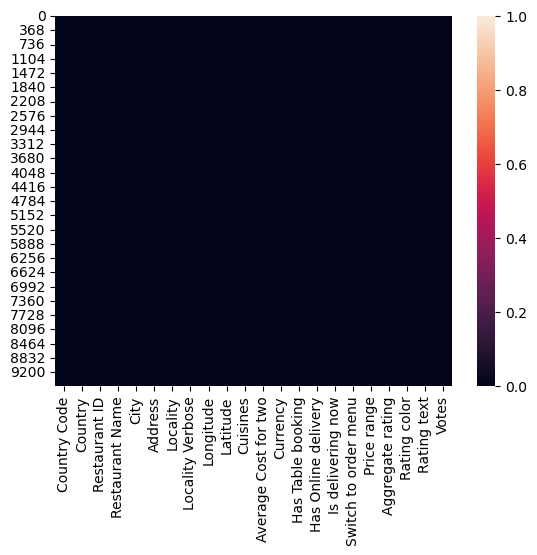

In [356]:
##3 Visualizing through heatmap:
sns.heatmap(dfzo.isnull())

##### Here we can see only the "Cuisines" have 9 numer of null values.. so for replacing the null values we can use mode of the column as it is a categorical data

In [357]:
dfzo['Cuisines']=dfzo['Cuisines'].fillna(dfzo['Cuisines'].mode()[0])

<AxesSubplot:>

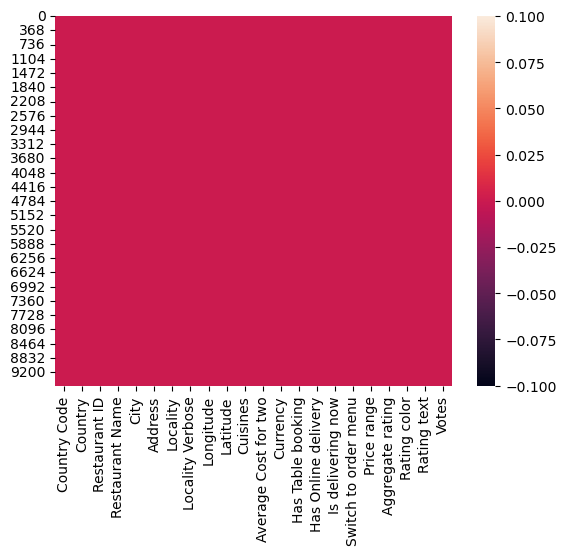

In [358]:
sns.heatmap(dfzo.isnull())

### Comments:
-> Now we can see no missing values present after replacing.. so we can proceed further

### Statistical Summery:

In [359]:
dfzo.describe()

,Country Code,Restaurant ID,Longitude,Latitude,Average Cost for two,Price range,Aggregate rating,Votes
count,9551.000000,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000
mean,18.365616,9.051128e+06,64.126574,25.854381,1199.210763,1.804837,2.666370,156.909748
std,56.750546,8.791521e+06,41.467058,11.007935,16121.183073,0.905609,1.516378,430.169145
min,1.000000,5.300000e+01,-157.948486,-41.330428,0.000000,1.000000,0.000000,0.000000
25%,1.000000,3.019625e+05,77.081343,28.478713,250.000000,1.000000,2.500000,5.000000
50%,1.000000,6.004089e+06,77.191964,28.570469,400.000000,2.000000,3.200000,31.000000
75%,1.000000,1.835229e+07,77.282006,28.642758,700.000000,2.000000,3.700000,131.000000
max,216.000000,1.850065e+07,174.832089,55.976980,800000.000000,4.000000,4.900000,10934.000000


### Observations:
1. There is a huge difference between 75% and Max value which shows the presence of outliers in the dataset
2. in some columns data are +vely skewed and in some columns the data is _vely skewed. which we will check in distribution of data

In [360]:
dfzo['Cuisines'].value_counts()

North Indian                                 945
North Indian, Chinese                        511
Fast Food                                    354
Chinese                                      354
North Indian, Mughlai                        334
                                            ... 
Cafe, Mexican, Continental                     1
North Indian, Continental, Asian, Italian      1
Continental, Cafe                              1
North Indian, Biryani, Mughlai                 1
Burger, Greek, Sandwich                        1
Name: Cuisines, Length: 1825, dtype: int64

# Data Visualization


## Univariate Analysis:


In [361]:
dfzo.dtypes

Country Code              int64
Country                  object
Restaurant ID             int64
Restaurant Name          object
City                     object
Address                  object
Locality                 object
Locality Verbose         object
Longitude               float64
Latitude                float64
Cuisines                 object
Average Cost for two      int64
Currency                 object
Has Table booking        object
Has Online delivery      object
Is delivering now        object
Switch to order menu     object
Price range               int64
Aggregate rating        float64
Rating color             object
Rating text              object
Votes                     int64
dtype: object

No     8393
Yes    1158
Name: Has Table booking, dtype: int64


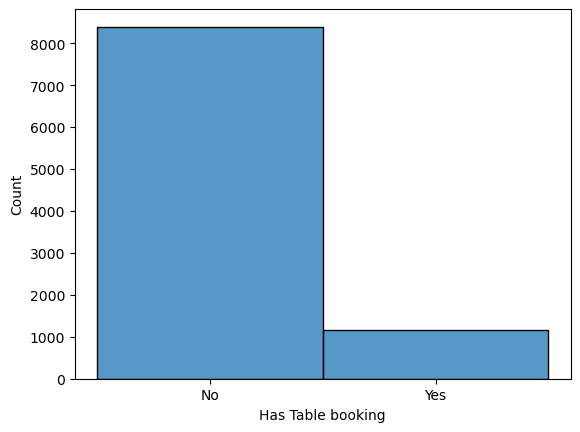

In [364]:
#visualizing the count of "Has Table booking" column:
p=sns.histplot(x='Has Table booking',data=dfzo)
print(dfzo['Has Table booking'].value_counts())

##
-> Count is more in case of customer not having Table Booking. i.e more customers are visiting with out booking the table in prior

No     7100
Yes    2451
Name: Has Online delivery, dtype: int64


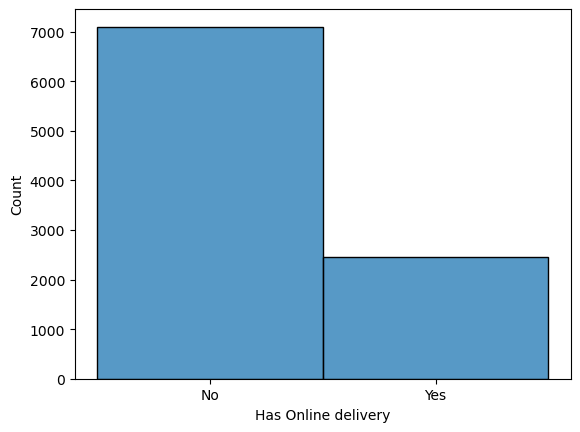

In [372]:
#visualizing the count of "Has Online delivery" column:
p=sns.histplot(x='Has Online delivery',data=dfzo)
print(dfzo['Has Online delivery'].value_counts())

#### Observation:
-> Most of the restaurent do not have online delivery facility

No     9517
Yes      34
Name: Is delivering now, dtype: int64


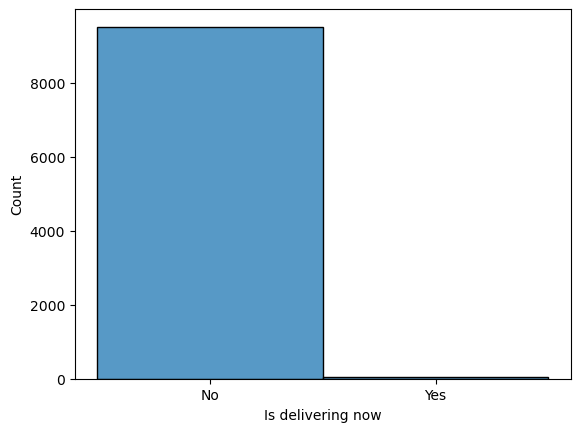

In [374]:
#visualizing the count of "Is delivering now" column:
p=sns.histplot(x='Is delivering now',data=dfzo)
print(dfzo['Is delivering now'].value_counts())

No    9551
Name: Switch to order menu, dtype: int64


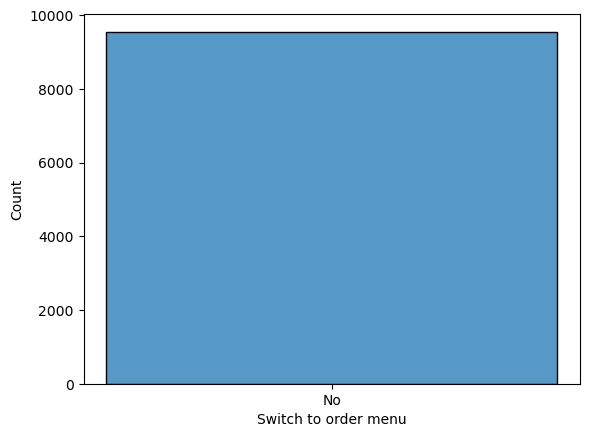

In [375]:
#visualizing the count of "Switch to order menu" column:
p=sns.histplot(x='Switch to order menu',data=dfzo)
print(dfzo['Switch to order menu'].value_counts())

Orange        3737
White         2148
Yellow        2100
Green         1079
Dark Green     301
Red            186
Name: Rating color, dtype: int64


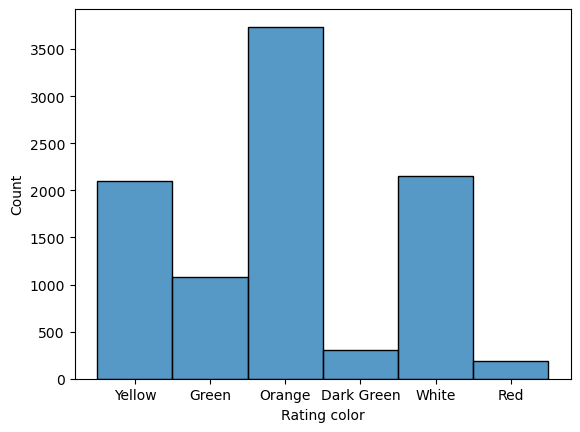

In [376]:
#visualizing the count of "Rating color" column:
p=sns.histplot(x='Rating color',data=dfzo)
print(dfzo['Rating color'].value_counts())

#### -> Orange coor rating count is more followed by "yellow" and "white"
-> Red has the least count

Average      3737
Not rated    2148
Good         2100
Very Good    1079
Excellent     301
Poor          186
Name: Rating text, dtype: int64


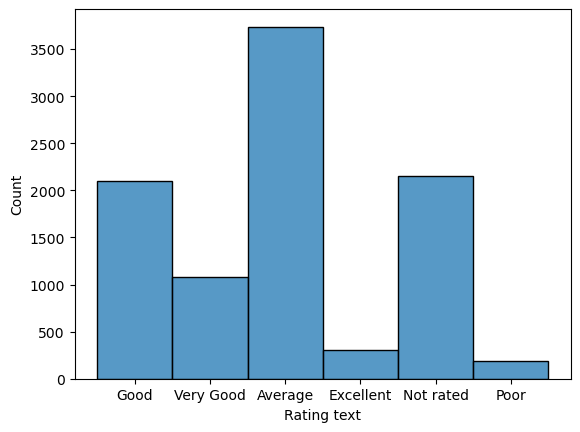

In [377]:
#visualizing the count of "Rating text" column:
p=sns.histplot(x='Rating text',data=dfzo)
print(dfzo['Rating text'].value_counts())

#### Observations:
-> most of the restaurent are rated as "Average"
->Poor rated restaurent are less
-> Some of the restaurent are not rated yet


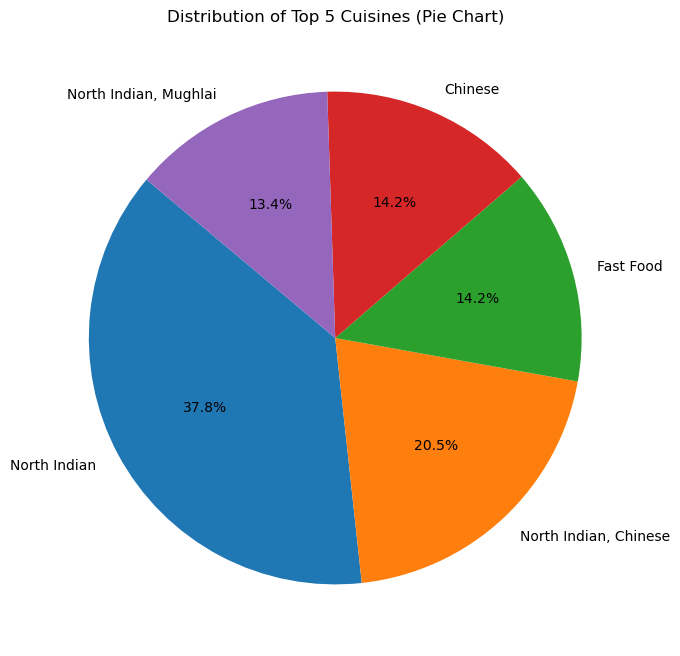

In [398]:
# Distribution of Top 5 Cuisines (Pie Chart)
top_cuisines = dfzo['Cuisines'].value_counts().head(5)
plt.figure(figsize=(8, 8))
plt.pie(top_cuisines, labels=top_cuisines.index, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Top 5 Cuisines (Pie Chart)')
plt.show()


#### Comments:
-> North Indian Cuisines tops the list followed by North indian,chinies, and Fast food etc

<AxesSubplot:ylabel='Price range'>

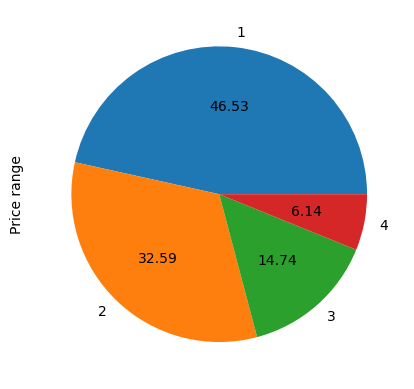

In [399]:
# Percentage count of Price range
dfzo['Price range'].value_counts().plot(kind='pie', autopct = '%.2f')

##### Observation:
-> percentage of price range "1" cusomers are more

<AxesSubplot:ylabel='Aggregate rating'>

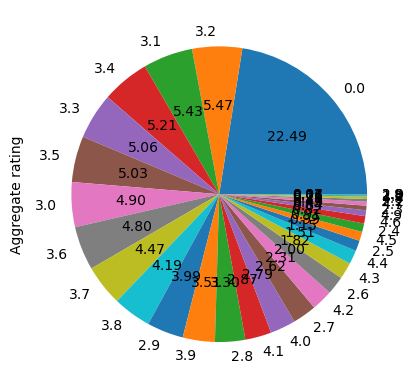

In [401]:
# Percentage Count of Ratings

dfzo['Aggregate rating'].value_counts().plot(kind='pie',autopct = '%.2f')

###Observation:
-> 22% of restaurent are given 0 rating

<function matplotlib.pyplot.show(close=None, block=None)>

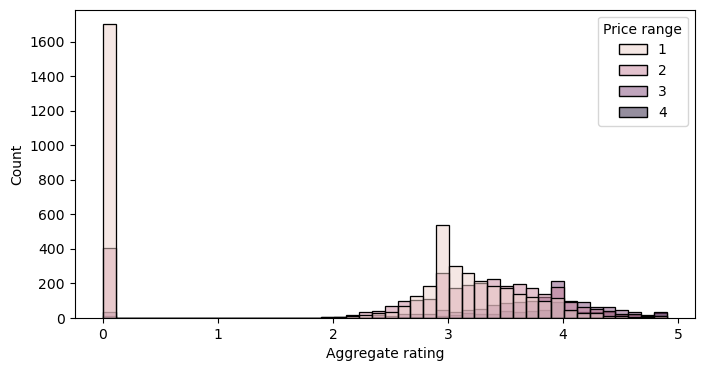

In [395]:
## Aggre vs Price Range
plt.figure(figsize=(8,4))
sns.histplot(x='Aggregate rating', hue='Price range', data=dfzo)
plt.show

Text(0.5, 1.0, 'Rating vs Cost of Two')

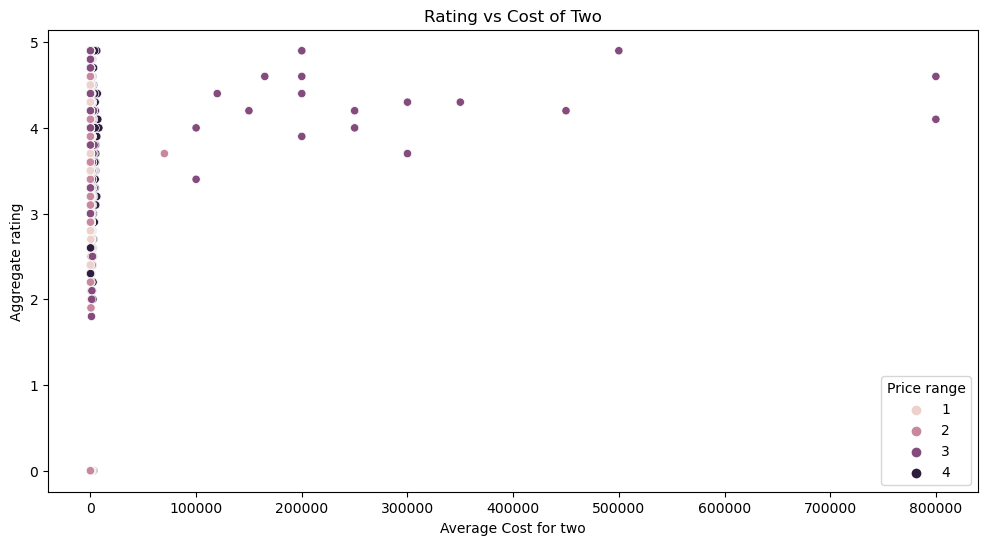

In [407]:
plt.figure(figsize=(12,6))
sns.scatterplot(x="Average Cost for two", y="Aggregate rating", hue='Price range', data=dfzo)

plt.xlabel("Average Cost for two")
plt.ylabel("Aggregate rating")
plt.title('Rating vs Cost of Two')

# Feature Engineering ans Selection:

In [156]:
for i in dfzo.dtypes.index:
    if dfzo.dtypes[i]=="int64":
        dfzo[i]=dfzo[i].astype(float)

In [157]:
dfzo.dtypes

Country Code            float64
Country                  object
Restaurant ID           float64
Restaurant Name          object
City                     object
Address                  object
Locality                 object
Locality Verbose         object
Longitude               float64
Latitude                float64
Cuisines                 object
Average Cost for two    float64
Currency                 object
Has Table booking        object
Has Online delivery      object
Is delivering now        object
Switch to order menu     object
Price range             float64
Aggregate rating        float64
Rating color             object
Rating text              object
Votes                   float64
dtype: object

In [158]:
dfzo3=dfzo.copy()

In [159]:
# Encoding Categorical Columns:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in dfzo.columns:
    if dfzo[i].dtypes=="object":
        dfzo[i]=OE.fit_transform(dfzo[i].values.reshape(-1,1))    
dfzo       

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1.0,3.0,3400025.0,3201.0,1.0,4553.0,17.0,17.0,78.011544,27.161661,...,4.0,0.0,0.0,0.0,0.0,3.0,3.9,5.0,2.0,140.0
1,1.0,3.0,3400341.0,5261.0,1.0,4605.0,17.0,17.0,0.000000,0.000000,...,4.0,0.0,0.0,0.0,0.0,2.0,3.5,5.0,2.0,71.0
2,1.0,3.0,3400005.0,6919.0,1.0,6234.0,17.0,17.0,78.011608,27.160832,...,4.0,0.0,0.0,0.0,0.0,2.0,3.6,5.0,2.0,94.0
3,1.0,3.0,3400021.0,1637.0,1.0,100.0,204.0,205.0,77.998092,27.195928,...,4.0,0.0,0.0,0.0,0.0,2.0,4.0,1.0,5.0,87.0
4,1.0,3.0,3400017.0,4922.0,1.0,1316.0,204.0,205.0,78.007553,27.201725,...,4.0,0.0,0.0,0.0,0.0,3.0,4.2,1.0,5.0,177.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,216.0,14.0,17697389.0,6794.0,135.0,1279.0,1174.0,1231.0,-92.335523,42.498400,...,2.0,0.0,0.0,0.0,0.0,1.0,3.7,5.0,2.0,101.0
9547,216.0,14.0,17697424.0,6839.0,135.0,2667.0,1174.0,1231.0,-92.335769,42.497919,...,2.0,0.0,0.0,0.0,0.0,1.0,3.5,5.0,2.0,58.0
9548,216.0,14.0,17697332.0,6945.0,135.0,957.0,1174.0,1231.0,-92.323400,42.465580,...,2.0,0.0,0.0,0.0,0.0,2.0,3.9,5.0,2.0,156.0
9549,216.0,14.0,17694056.0,6883.0,136.0,1910.0,1176.0,1233.0,-80.529488,40.396043,...,2.0,0.0,0.0,0.0,0.0,2.0,3.9,5.0,2.0,156.0


## Outlier Detection:

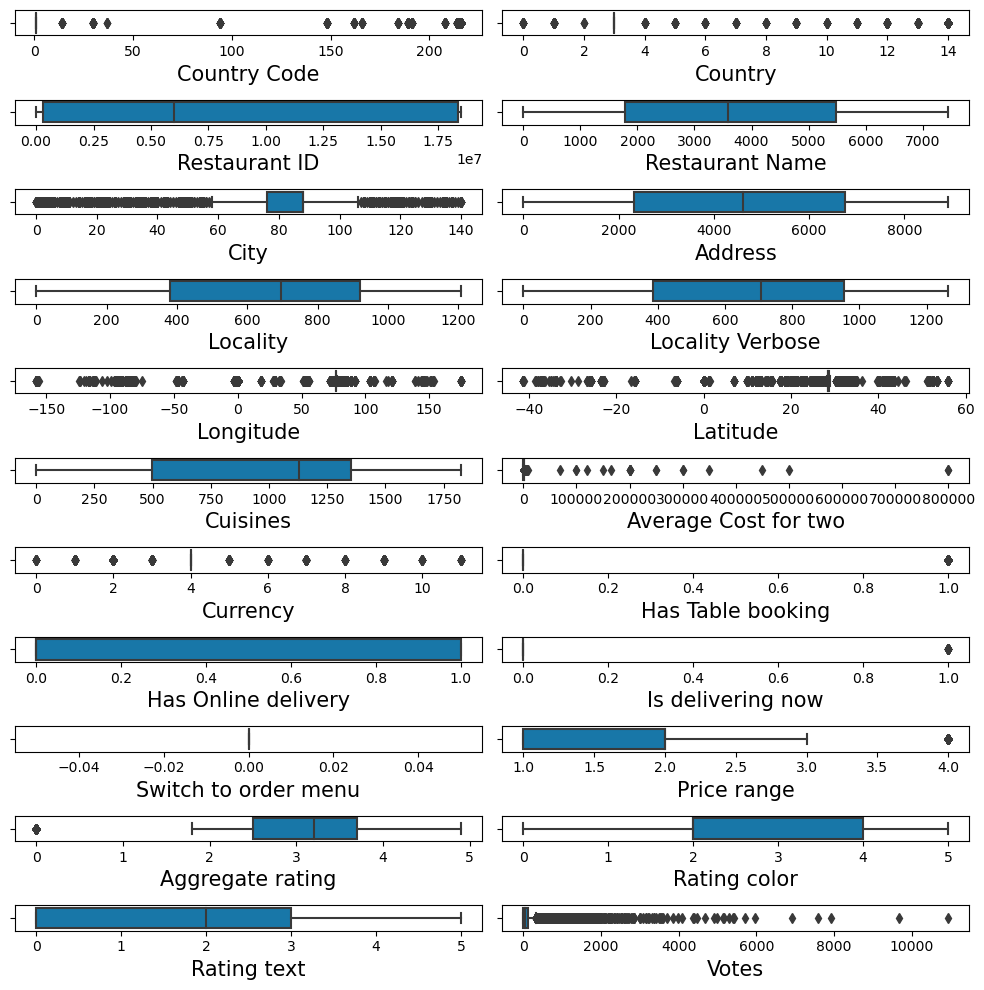

In [160]:
# checking for outliers
plt.figure(figsize=(10,10),facecolor="white")
plotnum=1
for i in dfzo.columns:
    if plotnum<=22:
        p=plt.subplot(11,2,plotnum)
        sns.boxplot(dfzo[i],palette='winter_r')
        plt.xlabel(i,fontsize=15)
        plt.yticks(rotation=0,fontsize=10)
        plotnum+=1
plt.tight_layout()    

In [161]:
# droping some of columns which are not much relevat
dfzo.drop(['Country','Country Code','Restaurant ID','Restaurant Name','Country Code','City','Address','Locality','Locality Verbose','Currency','Is delivering now','Switch to order menu'],axis=1,inplace=True)

In [162]:
## Removing outliers in numerical columns:
#z-score method:
from scipy.stats import zscore
out_features=dfzo[['Price range','Aggregate rating','Votes','Cuisines']]
z=np.abs(zscore(out_features))
z

,Price range,Aggregate rating,Votes,Cuisines
0,1.319803,0.813580,0.039312,1.020206
1,0.215516,0.549780,0.199722,1.020206
2,0.215516,0.615730,0.146252,0.615655
3,0.215516,0.879530,0.162525,1.274996
4,1.319803,1.011430,0.046706,0.745967
...,...,...,...,...
9546,0.888771,0.681680,0.129978,1.889455
9547,0.888771,0.549780,0.229944,1.566740
9548,0.215516,0.813580,0.002115,0.263617
9549,0.215516,0.813580,0.002115,1.307912


In [163]:
#threshold=3
np.where(z>3)

(array([  20,  102,  103,  104,  107,  111,  112,  115,  119,  169,  181,
         183,  187,  189,  190,  191,  193,  197,  200,  520,  523,  539,
         611,  623,  624,  627,  628,  629,  631,  632,  634,  840,  930,
         931, 1215, 1237, 1242, 1676, 1678, 1680, 1683, 1687, 1690, 1714,
        1720, 1778, 1780, 1782, 1785, 1786, 1787, 1788, 1789, 1790, 1792,
        1856, 1859, 1860, 1861, 1864, 1866, 1868, 1871, 1875, 2011, 2256,
        2381, 2384, 2389, 2392, 2394, 2401, 2402, 2404, 2409, 2417, 2425,
        2431, 2432, 2433, 2436, 2444, 2451, 2456, 2459, 2461, 2469, 2470,
        2471, 2477, 2483, 2486, 2488, 2491, 2492, 2493, 2494, 2495, 2692,
        2695, 2712, 2713, 2714, 2814, 2964, 2965, 2975, 2977, 2981, 3352,
        3359, 3360, 3362, 3368, 3369, 3370, 3374, 3463, 3538, 3554, 3696,
        3762, 4014, 4015, 4025, 4049, 4383, 4402, 5520, 5693, 5910, 6035,
        6077, 6085, 6088, 6224, 6297, 6373, 6409, 6421, 6463, 7239, 7770,
        7810, 8533, 8537, 8541, 8543, 

In [164]:
# we have to removethese rows which have outliers:
dfzo1=dfzo[(z<3).all(axis=1)]
dfzo1.shape          # after removing outliers the data frame size

(9378, 11)

In [165]:
dfzo.shape  

(9551, 11)

In [166]:
#data loss percentage:
print("data loss percentage",((dfzo.shape[0]-dfzo1.shape[0])/dfzo.shape[0])*100)

data loss percentage 1.8113286566851639


data loss percentage is affordable .. so we can proceed further

In [167]:
dfzo1.skew()

Longitude               -2.802188
Latitude                -3.086932
Cuisines                -0.307080
Average Cost for two    38.623972
Has Table booking        2.385524
Has Online delivery      1.122711
Price range              0.927646
Aggregate rating        -0.942181
Rating color             0.047580
Rating text              0.434382
Votes                    3.199653
dtype: float64

##### Comments:
1. In "Average" Cost of two" the skewness value if more higher.. but as it is the target variable.. no skewness transormation needed
2. reamining "City","Currency, "Has online delivery" column has skewness more than 1 but these are categorical columns.. so no need of transformation

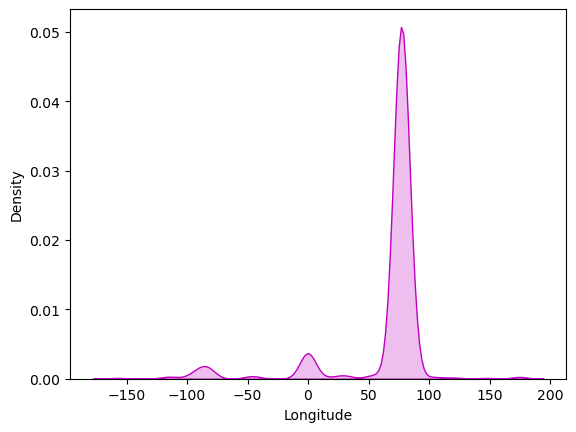

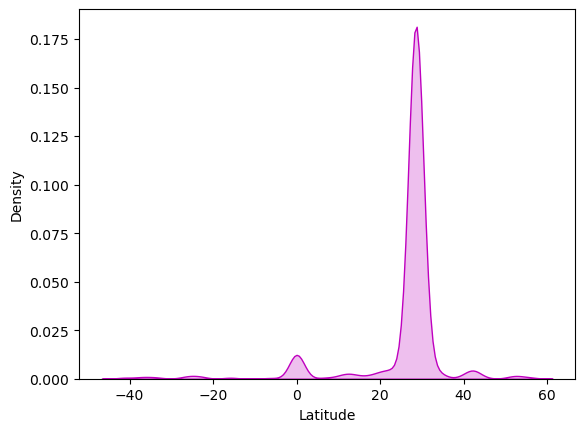

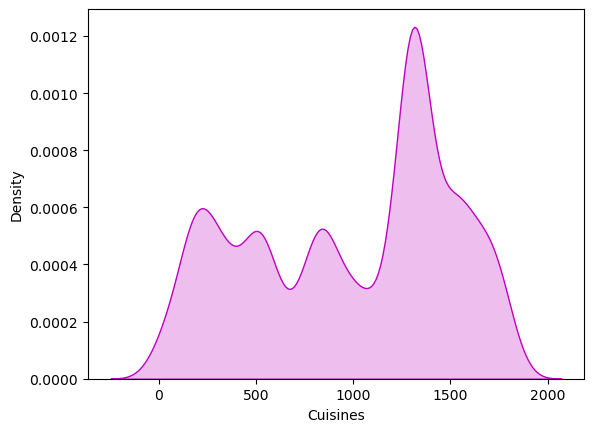

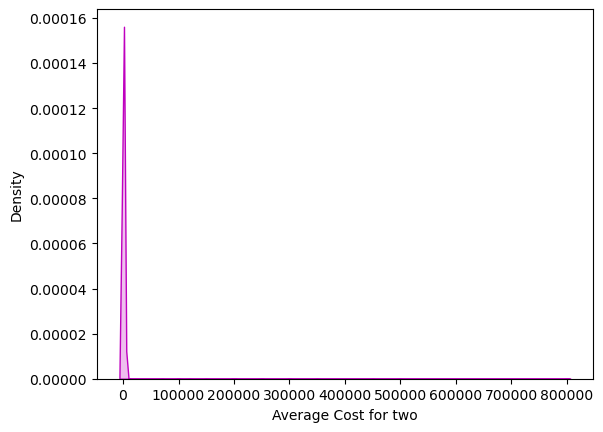

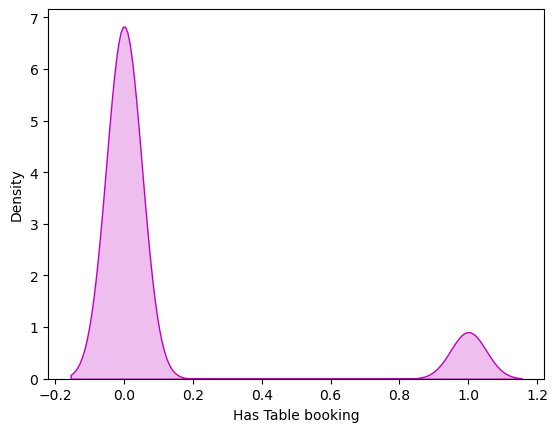

...

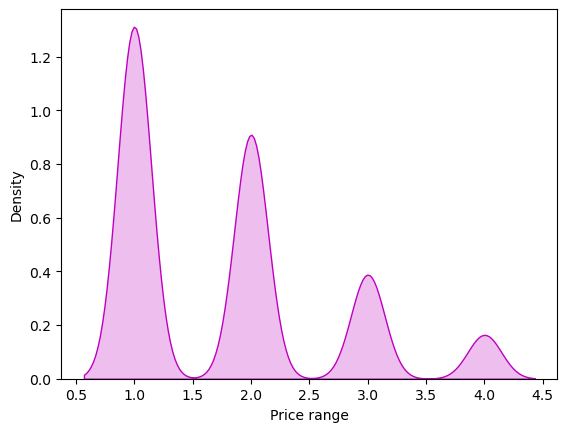

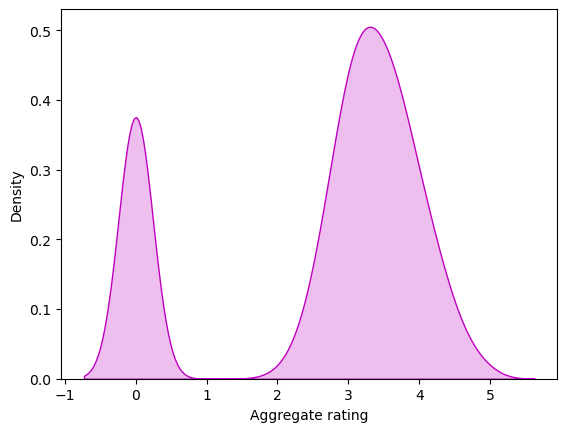

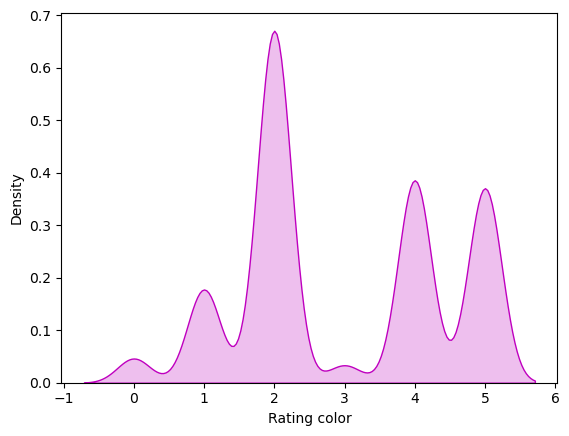

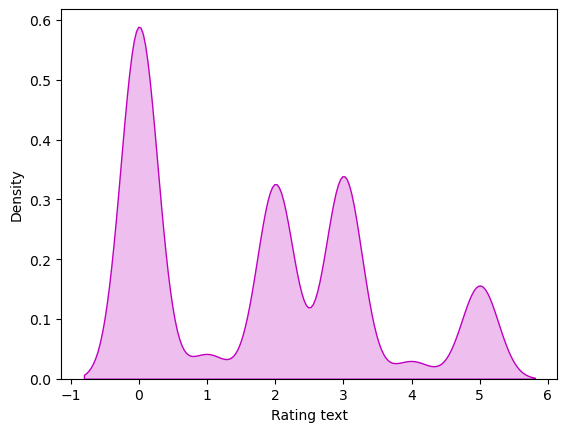

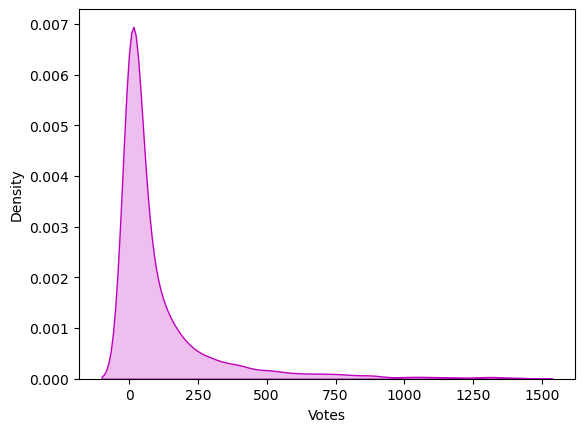

In [168]:
#visualizing the spreading of data
for i in dfzo1.columns:
    sns.distplot(dfzo1[i],color="m",kde_kws={"shade":True},hist=False)
    plt.show()

In [169]:
from sklearn.preprocessing import LabelEncoder
LE=LabelEncoder()
for i in dfzo3.columns:
    if dfzo3[i].dtypes=="object":
        dfzo3[i]=LE.fit_transform(dfzo3[i].values.reshape(-1,1))    
dfzo3       

,Country Code,Country,Restaurant ID,Restaurant Name,City,Address,Locality,Locality Verbose,Longitude,Latitude,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1.0,3,3400025.0,3201,1,4553,17,17,78.011544,27.161661,...,4,0,0,0,0,3.0,3.9,5,2,140.0
1,1.0,3,3400341.0,5261,1,4605,17,17,0.000000,0.000000,...,4,0,0,0,0,2.0,3.5,5,2,71.0
2,1.0,3,3400005.0,6919,1,6234,17,17,78.011608,27.160832,...,4,0,0,0,0,2.0,3.6,5,2,94.0
3,1.0,3,3400021.0,1637,1,100,204,205,77.998092,27.195928,...,4,0,0,0,0,2.0,4.0,1,5,87.0
4,1.0,3,3400017.0,4922,1,1316,204,205,78.007553,27.201725,...,4,0,0,0,0,3.0,4.2,1,5,177.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,216.0,14,17697389.0,6794,135,1279,1174,1231,-92.335523,42.498400,...,2,0,0,0,0,1.0,3.7,5,2,101.0
9547,216.0,14,17697424.0,6839,135,2667,1174,1231,-92.335769,42.497919,...,2,0,0,0,0,1.0,3.5,5,2,58.0
9548,216.0,14,17697332.0,6945,135,957,1174,1231,-92.323400,42.465580,...,2,0,0,0,0,2.0,3.9,5,2,156.0
9549,216.0,14,17694056.0,6883,136,1910,1176,1233,-80.529488,40.396043,...,2,0,0,0,0,2.0,3.9,5,2,156.0


# Correlation Matrix:

In [30]:
# corelation between target variable and features
corr=dfzo1.corr()
corr

,Longitude,Latitude,Cuisines,Average Cost for two,Has Table booking,Has Online delivery,Price range,Aggregate rating,Rating color,Rating text,Votes
Longitude,1.000000,0.047385,0.124065,0.042819,0.097757,0.178332,-0.079948,-0.117860,0.056838,-0.190140,-0.196931
Latitude,0.047385,1.000000,0.040006,-0.099037,0.058592,0.122199,-0.167181,0.004275,0.037171,-0.131255,-0.006302
Cuisines,0.124065,0.040006,1.000000,0.000390,0.052657,-0.015703,-0.006196,-0.081629,-0.016028,-0.083626,-0.059338
Average Cost for two,0.042819,-0.099037,0.000390,1.000000,0.013597,-0.016010,0.075211,0.048369,-0.041054,0.028998,0.080349
Has Table booking,0.097757,0.058592,0.052657,0.013597,1.000000,0.092274,0.502386,0.184165,-0.013432,0.028069,0.238151
Has Online delivery,0.178332,0.122199,-0.015703,-0.016010,0.092274,1.000000,0.077641,0.227930,0.011291,-0.086742,0.118183
Price range,-0.079948,-0.167181,-0.006196,0.075211,0.502386,0.077641,1.000000,0.428015,-0.124578,0.149428,0.402259
Aggregate rating,-0.117860,0.004275,-0.081629,0.048369,0.184165,0.227930,0.428015,1.000000,-0.356834,-0.204229,0.439034
Rating color,0.056838,0.037171,-0.016028,-0.041054,-0.013432,0.011291,-0.124578,-0.356834,1.000000,0.189631,-0.144733
Rating text,-0.190140,-0.131255,-0.083626,0.028998,0.028069,-0.086742,0.149428,-0.204229,0.189631,1.000000,0.248692


## Corelation matrix:

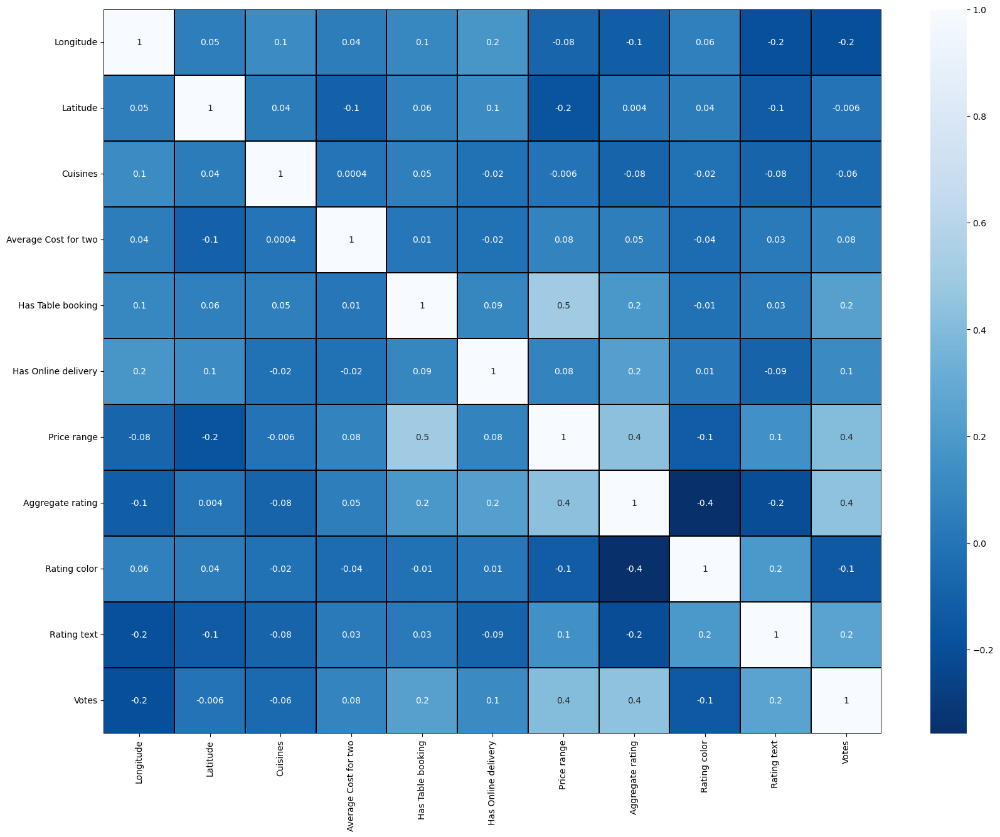

In [31]:
#visualizing the corelation matrix by using the heaatmap
plt.figure(figsize=(20,15))
sns.heatmap(dfzo1.corr(),linewidth=0.1,fmt='0.1g',linecolor="black",annot=True,cmap="Blues_r")
plt.yticks(rotation=0);
plt.show()

In [32]:
corr['Average Cost for two'].sort_values(ascending=False)

Average Cost for two    1.000000
Votes                   0.080349
Price range             0.075211
Aggregate rating        0.048369
Longitude               0.042819
Rating text             0.028998
Has Table booking       0.013597
Cuisines                0.000390
Has Online delivery    -0.016010
Rating color           -0.041054
Latitude               -0.099037
Name: Average Cost for two, dtype: float64

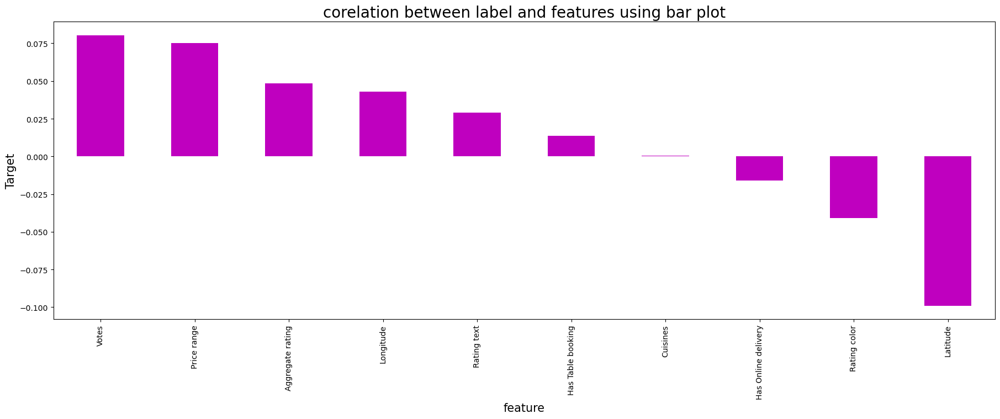

In [33]:
# visualizing the corelation using barplot:
plt.figure(figsize=(22,7))
dfzo1.corr()['Average Cost for two'].sort_values(ascending=False).drop(['Average Cost for two']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


In [34]:
corr['Price range'].sort_values(ascending=False)

Price range             1.000000
Has Table booking       0.502386
Aggregate rating        0.428015
Votes                   0.402259
Rating text             0.149428
Has Online delivery     0.077641
Average Cost for two    0.075211
Cuisines               -0.006196
Longitude              -0.079948
Rating color           -0.124578
Latitude               -0.167181
Name: Price range, dtype: float64

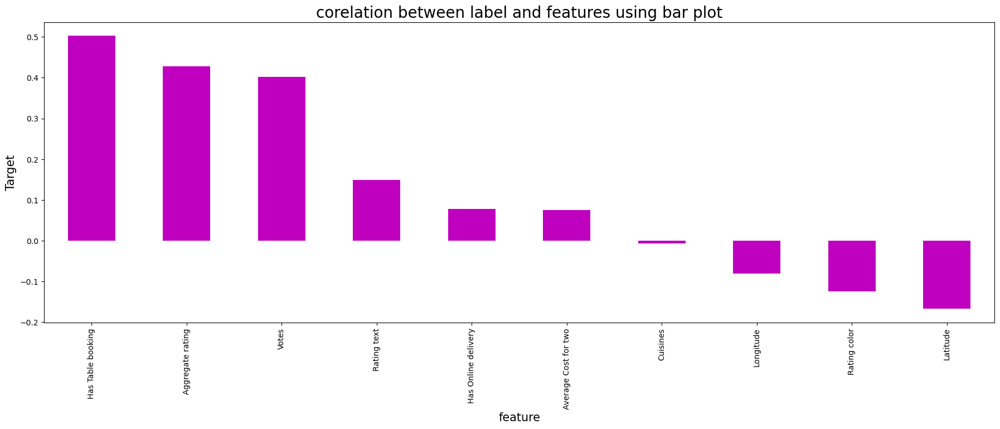

In [35]:
# visualizing the corelation using barplot:
plt.figure(figsize=(22,7))
dfzo1.corr()['Price range'].sort_values(ascending=False).drop(['Price range']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


## Checking For Multicolinearity:

In [36]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif= pd.DataFrame()
vif['VIF']= [variance_inflation_factor(dfzo1.values,i) for i in range(dfzo1.shape[1])]
vif['Features']= dfzo1.columns
vif

,VIF,Features
0,3.530086,Longitude
1,5.424180,Latitude
2,4.241181,Cuisines
3,1.029862,Average Cost for two
4,1.512468,Has Table booking
5,1.508282,Has Online delivery
6,8.033218,Price range
7,6.079734,Aggregate rating
8,4.799565,Rating color
9,2.602393,Rating text


## Comments:
-> VIF of all the fetures are less than 10 so no multi colinearity issue.. we can go further

In [37]:
dfzo1['Average Cost for two'].value_counts()

300.0       897
500.0       895
400.0       855
200.0       686
600.0       646
           ... 
2350.0        1
2600.0        1
445.0         1
1950.0        1
500000.0      1
Name: Average Cost for two, Length: 138, dtype: int64

#### The target variable 1 (Average Cost for two) contains continues numeric data.. so we can apply regression model to it

## Model Building For "Average Cost for two" prediction:

In [170]:
# Drop unnecessary columns
dfzo3 = dfzo3.drop(['Restaurant Name', 'Address', 'Currency', 'Restaurant ID', 'Country'], axis=1)

### Separating Target and Input Variables:

In [171]:
x=dfzo3.drop('Average Cost for two',axis=1)
y=dfzo3['Average Cost for two']

In [172]:
x

,Country Code,City,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,1.0,1,17,17,78.011544,27.161661,1514,0,0,0,0,3.0,3.9,5,2,140.0
1,1.0,1,17,17,0.000000,0.000000,1514,0,0,0,0,2.0,3.5,5,2,71.0
2,1.0,1,17,17,78.011608,27.160832,1306,0,0,0,0,2.0,3.6,5,2,94.0
3,1.0,1,204,205,77.998092,27.195928,1645,0,0,0,0,2.0,4.0,1,5,87.0
4,1.0,1,204,205,78.007553,27.201725,1373,0,0,0,0,3.0,4.2,1,5,177.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,216.0,135,1174,1231,-92.335523,42.498400,18,0,0,0,0,1.0,3.7,5,2,101.0
9547,216.0,135,1174,1231,-92.335769,42.497919,1795,0,0,0,0,1.0,3.5,5,2,58.0
9548,216.0,135,1174,1231,-92.323400,42.465580,1125,0,0,0,0,2.0,3.9,5,2,156.0
9549,216.0,136,1176,1233,-80.529488,40.396043,317,0,0,0,0,2.0,3.9,5,2,156.0


In [173]:
#### feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Country Code,City,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,-0.306015,-3.332289,-2.029851,-1.990609,0.334861,0.118764,1.020206,-0.371446,-0.587547,-0.059771,0.0,1.319803,0.813580,1.371170,0.124686,-0.039312
1,-0.306015,-3.332289,-2.029851,-1.990609,-1.546527,-2.348827,1.020206,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.549780,1.371170,0.124686,-0.199722
2,-0.306015,-3.332289,-2.029851,-1.990609,0.334862,0.118689,0.615655,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.615730,1.371170,0.124686,-0.146252
3,-0.306015,-3.332289,-1.437798,-1.423849,0.334536,0.121877,1.274996,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.879530,-1.308053,1.895070,-0.162525
4,-0.306015,-3.332289,-1.437798,-1.423849,0.334765,0.122404,0.745967,-0.371446,-0.587547,-0.059771,0.0,1.319803,1.011430,-1.308053,1.895070,0.046706
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,3.482693,2.444146,1.633280,1.669214,-3.773364,1.512081,-1.889455,-0.371446,-0.587547,-0.059771,0.0,-0.888771,0.681680,1.371170,0.124686,-0.129978
9547,3.482693,2.444146,1.633280,1.669214,-3.773370,1.512037,1.566740,-0.371446,-0.587547,-0.059771,0.0,-0.888771,0.549780,1.371170,0.124686,-0.229944
9548,3.482693,2.444146,1.633280,1.669214,-3.773071,1.509099,0.263617,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.813580,1.371170,0.124686,-0.002115
9549,3.482693,2.487254,1.639612,1.675243,-3.488640,1.321086,-1.307912,-0.371446,-0.587547,-0.059771,0.0,0.215516,0.813580,1.371170,0.124686,-0.002115


In [174]:
# Normalization:
from sklearn.preprocessing import MinMaxScaler

nrm_scaler = MinMaxScaler()
nrm_scaled_data = nrm_scaler.fit_transform(x)
x_Normalized = pd.DataFrame(nrm_scaled_data, columns=x.columns)
x_Normalized

,Country Code,City,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,0.0,0.007143,0.014085,0.013449,0.709056,0.703873,0.830044,0.0,0.0,0.0,0.0,0.666667,0.795918,1.0,0.4,0.012804
1,0.0,0.007143,0.014085,0.013449,0.474633,0.424741,0.830044,0.0,0.0,0.0,0.0,0.333333,0.714286,1.0,0.4,0.006494
2,0.0,0.007143,0.014085,0.013449,0.709056,0.703865,0.716009,0.0,0.0,0.0,0.0,0.333333,0.734694,1.0,0.4,0.008597
3,0.0,0.007143,0.169014,0.162184,0.709015,0.704225,0.901864,0.0,0.0,0.0,0.0,0.333333,0.816327,0.2,1.0,0.007957
4,0.0,0.007143,0.169014,0.162184,0.709044,0.704285,0.752741,0.0,0.0,0.0,0.0,0.666667,0.857143,0.2,1.0,0.016188
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,1.0,0.964286,0.972659,0.973892,0.197166,0.861485,0.009868,0.0,0.0,0.0,0.0,0.000000,0.755102,1.0,0.4,0.009237
9547,1.0,0.964286,0.972659,0.973892,0.197165,0.861480,0.984101,0.0,0.0,0.0,0.0,0.000000,0.714286,1.0,0.4,0.005305
9548,1.0,0.964286,0.972659,0.973892,0.197202,0.861147,0.616776,0.0,0.0,0.0,0.0,0.333333,0.795918,1.0,0.4,0.014267
9549,1.0,0.971429,0.974316,0.975475,0.232643,0.839879,0.173794,0.0,0.0,0.0,0.0,0.333333,0.795918,1.0,0.4,0.014267


In [175]:
y.value_counts()

500.0       900
300.0       897
400.0       857
200.0       687
600.0       652
           ... 
70000.0       1
165000.0      1
450000.0      1
120000.0      1
4300.0        1
Name: Average Cost for two, Length: 140, dtype: int64

# modeling

In [176]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.linear_model import Lasso,Ridge


In [177]:
# finding the best random state
maxAcc=0
maxRs=0
for i in range(1,1000):
    x_train,x_test,y_train,y_test=train_test_split(x_Normalized,y,test_size=.25,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum r2_score is",maxAcc, "on random_state",maxRs)        

maximum r2_score is 0.0719080768546696 on random_state 878


In [178]:
# creating train test split:
x_train,x_test,y_train,y_test=train_test_split(x_Normalized,y,test_size=.25,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(7163, 16)
(7163,)
(2388, 16)
(2388,)


In [179]:
LR=LinearRegression()
LR.fit(x_train,y_train)
pred_lr=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_lr))
print('r2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_lr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_lr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_lr)))

r2_score: 0.0719080768546696
r2_score on training Data: 2.505752605092826
mean absolute error: 1735.1972012688213
Mean Squared Error:- 138915266.97597647
Root Mean Squrared Error:- 11786.232094099305


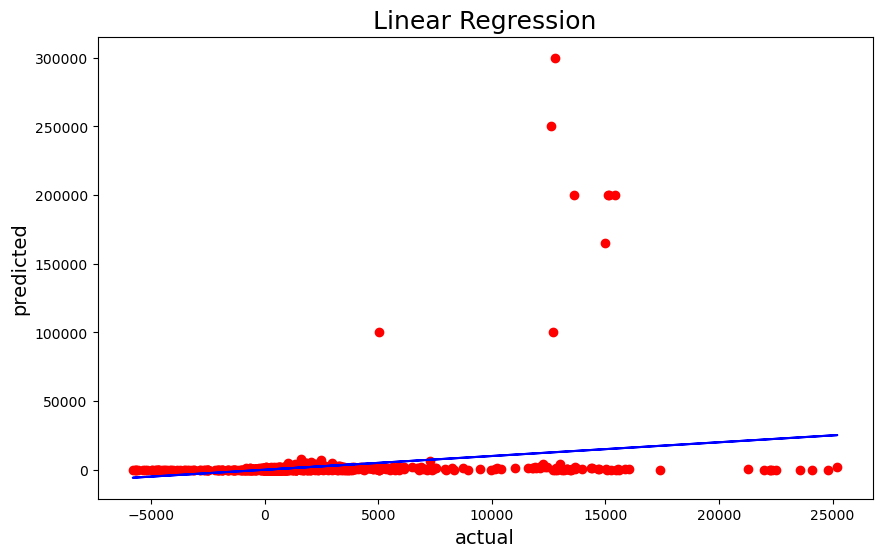

In [180]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_lr,y=y_test,color="r")
plt.plot(pred_lr,pred_lr,color="b")
plt.xlabel('actual',fontsize=14)
plt.ylabel('predicted',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

In [181]:
# Random Forest model:
RFR=RandomForestRegressor()
RFR.fit(x_train,y_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_RFR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_RFR))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_RFR))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_RFR)))

r2_score: -0.7262919967593473
R2_score on training Data: 92.66849941130945
mean absolute error: 1008.6930427933316
Mean Squared Error:- 258388536.33764955
Root Mean Squrared Error:- 16074.468462056515


In [182]:
# KNN
knn=KNN()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print('r2_score:',r2_score(y_test,pred_knn))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_knn))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_knn))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_knn)))

r2_score: 0.7525165183949556
R2_score on training Data: 44.35927659250818
mean absolute error: 569.7027638190955
Mean Squared Error:- 37042918.984572865
Root Mean Squrared Error:- 6086.289426618888


In [183]:
#Ridge:
ridge=Ridge()
ridge.fit(x_train,y_train)
pred_ridge=ridge.predict(x_test)
pred_train=ridge.predict(x_train)
print('r2_score:',r2_score(y_test,pred_ridge))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_ridge))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_ridge))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_ridge)))

r2_score: 0.0717717663254962
R2_score on training Data: 2.501217941063616
mean absolute error: 1712.500031883215
Mean Squared Error:- 138935669.71096376
Root Mean Squrared Error:- 11787.097594868881


# Cross Validating the models:

In [186]:
from sklearn.model_selection import cross_val_score

In [187]:
scoreLR=cross_val_score(LR,x_Normalized,y,cv=4,scoring='r2')             #CROSS VALIDATION FOR LINEAR REGRESSOR
print(scoreLR)
print(scoreLR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_lr)-scoreLR.mean())*100)

[-7.96088354e+01 -3.77289298e+00 -6.00747899e-01 -4.77864662e-03]
-20.996813725915366
difference between r2 score and cross validation score is: 2106.8721802770037


In [188]:
scoreRFR=cross_val_score(RFR,x_Normalized,y,cv=4,scoring='r2')        #CROSS VALIDATION FOR RANDOM FOREST
print(scoreRFR)
print(scoreRFR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_RFR)-scoreRFR.mean())*100)

[ 0.67784944  0.84003765  0.84201958 -0.00211314]
0.5894483819347718
difference between r2 score and cross validation score is: -131.5740378694119


In [59]:
scoreknn=cross_val_score(knn,x_Normalized,y,cv=4,scoring='r2')            # CROSS VALIDATION FOR KNN
print(scoreknn)
print(scoreknn.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_knn)-scoreknn.mean())*100)

[-2.41552972e+02  5.51447650e-01  7.77548108e-01 -1.76805439e-03]
-60.05643597996401
difference between r2 score and cross validation score is: 6009.9293447339305


In [189]:
scoreR=cross_val_score(ridge,x_Normalized,y,cv=4,scoring='r2')          #cross validation for ridge
print(scoreR)
print(scoreR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_ridge)-scoreR.mean())*100)

[-7.16687974e+01 -3.12536846e+00 -5.37551984e-01 -3.67594071e-03]
-18.83384845657522
difference between r2 score and cross validation score is: 1890.5620222900718


### Applying Random Forest Regressor Model for final Prediction:

In [201]:
from sklearn.model_selection import GridSearchCV
parameter = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4],
    'min_samples_split': [8, 10],
    'n_estimators': [100, 200, 300]
    }

GCV=GridSearchCV(RandomForestRegressor(),parameter,cv=4)
GCV.fit(x_train,y_train)


GridSearchCV(cv=4, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True], 'max_depth': [80, 90, 100],
                         'max_features': [2, 3], 'min_samples_leaf': [3, 4],
                         'min_samples_split': [8, 10],
                         'n_estimators': [100, 200, 300]})

In [202]:
GCV.best_params_

{'bootstrap': True,
 'max_depth': 80,
 'max_features': 3,
 'min_samples_leaf': 3,
 'min_samples_split': 8,
 'n_estimators': 200}

In [203]:
model_Zomato1=RandomForestRegressor(bootstrap=True,max_depth=80,max_features=3,min_samples_leaf=3,min_samples_split= 8,n_estimators=200)

In [205]:
## Final Model 
model_Zomato1.fit(x_train,y_train)
pred=model_Zomato1.predict(x_test)
acc=r2_score(y_test,pred)
print(acc*100)

80.36759991242045


### In Final Model we are getting 80.36% accuracy for "Average Cost For two" prediction

#### Saving the model

In [209]:
import joblib
joblib.dump(model_Zomato1,'Average Cost For Two Prediction Analysis')


['Average Cost For Two Prediction Analysis']

In [210]:
Zomato_Avg_Cost=joblib.load('Average Cost For Two Prediction Analysis')
predictionM=Zomato_Avg_Cost.predict(x_test)
predictionM

array([ 219.60357785,  455.32447294,  538.31423422, ...,  285.99719167,
        307.16946077, 4757.15309026])

In [212]:
a=np.array(y_test)
DF_Zomato_AvgCost=pd.DataFrame()
DF_Zomato_AvgCost['predicted']=predictionM
DF_Zomato_AvgCost['original']=a
DF_Zomato_AvgCost

,predicted,original
0,219.603578,200.0
1,455.324473,400.0
2,538.314234,650.0
3,277.762070,250.0
4,1403.223375,1500.0
...,...,...
2383,1452.305733,1500.0
2384,291.049443,350.0
2385,285.997192,150.0
2386,307.169461,150.0


# Model Building for target2: "Price Range" (Classification model)

In [46]:
dfzo2=dfzo1.copy()
dfzo2

,Longitude,Latitude,Cuisines,Average Cost for two,Has Table booking,Has Online delivery,Price range,Aggregate rating,Rating color,Rating text,Votes
0,78.011544,27.161661,1514.0,850.0,0.0,0.0,3.0,3.9,5.0,2.0,140.0
1,0.000000,0.000000,1514.0,700.0,0.0,0.0,2.0,3.5,5.0,2.0,71.0
2,78.011608,27.160832,1306.0,500.0,0.0,0.0,2.0,3.6,5.0,2.0,94.0
3,77.998092,27.195928,1645.0,400.0,0.0,0.0,2.0,4.0,1.0,5.0,87.0
4,78.007553,27.201725,1373.0,1000.0,0.0,0.0,3.0,4.2,1.0,5.0,177.0
...,...,...,...,...,...,...,...,...,...,...,...
9546,-92.335523,42.498400,18.0,10.0,0.0,0.0,1.0,3.7,5.0,2.0,101.0
9547,-92.335769,42.497919,1795.0,10.0,0.0,0.0,1.0,3.5,5.0,2.0,58.0
9548,-92.323400,42.465580,1125.0,25.0,0.0,0.0,2.0,3.9,5.0,2.0,156.0
9549,-80.529488,40.396043,317.0,25.0,0.0,0.0,2.0,3.9,5.0,2.0,156.0


In [47]:
#separating target variable and input variable

x1=dfzo2.drop('Price range',axis=1)
y1=dfzo2['Price range']

In [48]:
x1

,Longitude,Latitude,Cuisines,Average Cost for two,Has Table booking,Has Online delivery,Aggregate rating,Rating color,Rating text,Votes
0,78.011544,27.161661,1514.0,850.0,0.0,0.0,3.9,5.0,2.0,140.0
1,0.000000,0.000000,1514.0,700.0,0.0,0.0,3.5,5.0,2.0,71.0
2,78.011608,27.160832,1306.0,500.0,0.0,0.0,3.6,5.0,2.0,94.0
3,77.998092,27.195928,1645.0,400.0,0.0,0.0,4.0,1.0,5.0,87.0
4,78.007553,27.201725,1373.0,1000.0,0.0,0.0,4.2,1.0,5.0,177.0
...,...,...,...,...,...,...,...,...,...,...
9546,-92.335523,42.498400,18.0,10.0,0.0,0.0,3.7,5.0,2.0,101.0
9547,-92.335769,42.497919,1795.0,10.0,0.0,0.0,3.5,5.0,2.0,58.0
9548,-92.323400,42.465580,1125.0,25.0,0.0,0.0,3.9,5.0,2.0,156.0
9549,-80.529488,40.396043,317.0,25.0,0.0,0.0,3.9,5.0,2.0,156.0


In [49]:
# feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x1=pd.DataFrame(scaler.fit_transform(x1),columns=x1.columns)
x1

,Longitude,Latitude,Cuisines,Average Cost for two,Has Table booking,Has Online delivery,Aggregate rating,Rating color,Rating text,Votes
0,0.335679,0.115490,1.019649,-0.013525,-0.363779,-0.585477,0.833530,1.370957,0.142353,0.130117
1,-1.551039,-2.340716,1.019649,-0.024672,-0.363779,-0.585477,0.569396,1.370957,0.142353,-0.203313
2,0.335681,0.115415,0.615300,-0.039535,-0.363779,-0.585477,0.635429,1.370957,0.142353,-0.092170
3,0.335354,0.118588,1.274311,-0.046966,-0.363779,-0.585477,0.899563,-1.340883,1.928691,-0.125996
4,0.335582,0.119113,0.745547,-0.002378,-0.363779,-0.585477,1.031630,-1.340883,1.928691,0.308913
...,...,...,...,...,...,...,...,...,...,...
9373,-3.784184,1.502378,-1.888553,-0.075948,-0.363779,-0.585477,0.701463,1.370957,0.142353,-0.058343
9374,-3.784190,1.502334,1.565909,-0.075948,-0.363779,-0.585477,0.569396,1.370957,0.142353,-0.266133
9375,-3.783891,1.499410,0.263439,-0.074834,-0.363779,-0.585477,0.833530,1.370957,0.142353,0.207434
9376,-3.498654,1.312263,-1.307302,-0.074834,-0.363779,-0.585477,0.833530,1.370957,0.142353,0.207434


In [50]:
y1.value_counts()

1.0    4437
2.0    3076
3.0    1312
4.0     553
Name: Price range, dtype: int64

In [51]:
!pip install -U imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable


In [52]:
# to balance the target variable data over sampling is performed:
from imblearn.over_sampling import SMOTE
sm=SMOTE()
x2,y2=sm.fit_resample(x1,y1)

In [53]:
y2.value_counts()

3.0    4437
2.0    4437
4.0    4437
1.0    4437
Name: Price range, dtype: int64

## modeling

from the target variable we can observe that the given problem statement is a binary classification problem.. so we can apply Naive Bayes classifier, logistic regression knn descission tree.. 

In [56]:
#finding the best random state:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.model_selection import cross_val_score


In [57]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
maxAcc=0
maxRs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x2,y2,test_size=.25,random_state=i)
    LR=LogisticRegression()
    LR.fit(x_train,y_train)
    pred=LR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum acc_score is",maxAcc, "on random_state",maxRs)        


maximum acc_score is 0.6206896551724138 on random_state 170


In [58]:
# creating train test split:
x_train,x_test,y_train,y_test=train_test_split(x2,y2,test_size=0.25,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(13311, 10)
(13311,)
(4437, 10)
(4437,)


In [59]:
#Logistic regression model:
logR=LogisticRegression()
logR.fit(x_train,y_train)
pred_train=logR.predict(x_train)
pred_Lgr=logR.predict(x_test)
print("predicted accuracy",accuracy_score(y_test,pred_Lgr))
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(confusion_matrix(y_test,pred_Lgr))
print(classification_report(y_test,pred_Lgr))


predicted accuracy 0.6206896551724138
accuracy score of original y_test data 0.5981519044399369
[[923 163  26  10]
 [306 581  92  96]
 [ 35 184 413 489]
 [ 29  53 200 837]]
              precision    recall  f1-score   support

         1.0       0.71      0.82      0.76      1122
         2.0       0.59      0.54      0.57      1075
         3.0       0.56      0.37      0.45      1121
         4.0       0.58      0.75      0.66      1119

    accuracy                           0.62      4437
   macro avg       0.61      0.62      0.61      4437
weighted avg       0.61      0.62      0.61      4437



In [60]:
#DecissionTreeClassifier:
from sklearn.tree import DecisionTreeClassifier
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
pred_dtc=dtc.predict(x_test)
pred_train=dtc.predict(x_train)
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(accuracy_score(y_test,pred_dtc))
print(confusion_matrix(y_test,pred_dtc))
print(classification_report(y_test,pred_dtc))

accuracy score of original y_test data 1.0
0.9738562091503268
[[1116    4    0    2]
 [   1 1054   18    2]
 [   1   20 1070   30]
 [   0    3   35 1081]]
              precision    recall  f1-score   support

         1.0       1.00      0.99      1.00      1122
         2.0       0.98      0.98      0.98      1075
         3.0       0.95      0.95      0.95      1121
         4.0       0.97      0.97      0.97      1119

    accuracy                           0.97      4437
   macro avg       0.97      0.97      0.97      4437
weighted avg       0.97      0.97      0.97      4437



In [61]:
#RandomForestClassifier:
RFC=RandomForestClassifier()
RFC.fit(x_train,y_train)
pred_RFC=RFC.predict(x_test)
print(accuracy_score(y_test,pred_RFC))
print(confusion_matrix(y_test,pred_RFC))
print(classification_report(y_test,pred_RFC))


0.988280369619112
[[1116    6    0    0]
 [   1 1063   10    1]
 [   0    7 1100   14]
 [   0    1   12 1106]]
              precision    recall  f1-score   support

         1.0       1.00      0.99      1.00      1122
         2.0       0.99      0.99      0.99      1075
         3.0       0.98      0.98      0.98      1121
         4.0       0.99      0.99      0.99      1119

    accuracy                           0.99      4437
   macro avg       0.99      0.99      0.99      4437
weighted avg       0.99      0.99      0.99      4437



In [62]:
#KNeighborsClassifier:
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
print(accuracy_score(y_test,pred_knn))
print(confusion_matrix(y_test,pred_knn))
print(classification_report(y_test,pred_knn))


0.7996393959882804
[[ 887  199   29    7]
 [ 187  724  134   30]
 [  21   91  914   95]
 [   3   22   71 1023]]
              precision    recall  f1-score   support

         1.0       0.81      0.79      0.80      1122
         2.0       0.70      0.67      0.69      1075
         3.0       0.80      0.82      0.81      1121
         4.0       0.89      0.91      0.90      1119

    accuracy                           0.80      4437
   macro avg       0.80      0.80      0.80      4437
weighted avg       0.80      0.80      0.80      4437



In [63]:
#GaussianNB:
gnb = GaussianNB()
gnb.fit(x_train,y_train)
pred_gnb=gnb.predict(x_test)
print(accuracy_score(y_test,pred_gnb))
print(confusion_matrix(y_test,pred_gnb))
print(classification_report(y_test,pred_gnb))


0.4992111787243633
[[1104    0    4   14]
 [ 917   54   24   80]
 [ 130  235  205  551]
 [ 100   97   70  852]]
              precision    recall  f1-score   support

         1.0       0.49      0.98      0.65      1122
         2.0       0.14      0.05      0.07      1075
         3.0       0.68      0.18      0.29      1121
         4.0       0.57      0.76      0.65      1119

    accuracy                           0.50      4437
   macro avg       0.47      0.49      0.42      4437
weighted avg       0.47      0.50      0.42      4437



## Cross Validating the Models:

In [64]:
score_LR=cross_val_score(logR,x2,y2)             # cross validation score for logistic regression
print(score_LR)
print(score_LR.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_Lgr)-(score_LR.mean()))

[0.5915493  0.58929577 0.64704225 0.56776557 0.56213018]
0.5915566138448044
diff b/w accuracy score and cross validation score is: 0.02913304132760941


In [65]:
score_dtc=cross_val_score(dtc,x2,y2)           #cross validation score of dtc
print(score_dtc)
print(score_dtc.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_dtc)-(score_dtc.mean()))

[0.96197183 0.9743662  0.98309859 0.9602705  0.92927585]
0.9617965941606246
diff b/w accuracy score and cross validation score is: 0.012059614989702205


In [66]:
score_RFC=cross_val_score(RFC,x2,y2)                           #cross validation score of RandomForest
print(score_RFC)
print(score_RFC.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_RFC)-(score_RFC.mean()))

[0.97070423 0.97971831 0.99352113 0.96562412 0.94336433]
0.9705864218843633
diff b/w accuracy score and cross validation score is: 0.01769394773474875


In [67]:
score_knn=cross_val_score(knn,x2,y2)                           #cross validation score of knn
print(score_knn)
print(score_knn.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_knn)-(score_knn.mean()))

[0.76338028 0.77126761 0.82394366 0.77458439 0.79374472]
0.785384131217284
diff b/w accuracy score and cross validation score is: 0.014255264770996368


In [68]:
score_gnb=cross_val_score(gnb,x2,y2)                           #cross validation score of GaussianNB
print(score_gnb)
print(score_gnb.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_gnb)-(score_gnb.mean()))

[0.56394366 0.48732394 0.56873239 0.63144548 0.50014088]
0.5503172724711186
diff b/w accuracy score and cross validation score is: -0.05110609374675529


#####  By Varifying the Cross validation and accuracy score we can conclude that Random Forest Model is best suitable for the given problem statement

# Hyperparameter Tuning of Random Forest Classifier

In [69]:
from sklearn.model_selection import GridSearchCV

In [70]:
parameter = {  'bootstrap': [True], 'max_depth': [5, 10,20,40,50, None], 
              'max_features': ['auto', 'log2'], 
              'criterion':['gini','entropy'],
              'n_estimators': [5, 10, 15 ,25,50,100]}

In [71]:
GCV = GridSearchCV(RandomForestClassifier(),parameter,cv=5,n_jobs = -1,verbose=3)
GCV.fit(x_train,y_train)

Fitting 5 folds for each of 144 candidates, totalling 720 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'bootstrap': [True], 'criterion': ['gini', 'entropy'],
                         'max_depth': [5, 10, 20, 40, 50, None],
                         'max_features': ['auto', 'log2'],
                         'n_estimators': [5, 10, 15, 25, 50, 100]},
             verbose=3)

In [72]:
GCV.best_params_

{'bootstrap': True,
 'criterion': 'entropy',
 'max_depth': 50,
 'max_features': 'log2',
 'n_estimators': 100}

In [76]:
MODEL_Zomato2=RandomForestClassifier(bootstrap= True,criterion= 'entropy',max_depth= 50,max_features= 'log2',n_estimators= 100)

# Final Model

In [77]:
MODEL_Zomato2.fit(x_train,y_train)
pred=MODEL_Zomato2.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

98.80549921117873


### In the Final Model we are getting 98.805% accuracy

#### Saving the model

In [78]:
import joblib
joblib.dump(MODEL_Zomato2,'Zomato Price Range Prediction Analysis')


['Zomato Price Range Prediction Analysis']

In [79]:
RFC_Zomato2=joblib.load('Zomato Price Range Prediction Analysis')
predictionM=RFC_Zomato2.predict(x_test)
predictionM

array([2., 3., 2., ..., 1., 1., 1.])

In [80]:
a=np.array(y_test)
DF_ZomatoPriceRange=pd.DataFrame()
DF_ZomatoPriceRange['predicted']=predictionM
DF_ZomatoPriceRange['original']=a
DF_ZomatoPriceRange

,predicted,original
0,2.0,2.0
1,3.0,3.0
2,2.0,2.0
3,2.0,2.0
4,4.0,4.0
...,...,...
4432,4.0,4.0
4433,3.0,3.0
4434,1.0,1.0
4435,1.0,1.0
